## SDCND Project 2: Advance Lane Finding

#### By Devin Datt,  July 31st, 2018

This project will build off some of the concepts from the previous Lane Line finding project 1. It will use more advance techniques to fine tune the line detection algorythms to produce a much more clearer and richer visual experience to find lines accurately as best as possible with the tools we have learned thus far in the nanodegree program.

Below we will build a pipeline step by step via the following process:


- 1) Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
- 2) Apply a distortion correction to raw images.
- 3) Use color transforms, gradients, etc., to create a thresholded binary image.
- 4) Apply a perspective transform to rectify binary image ("birds-eye view").
- 5) Detect lane pixels and fit to find the lane boundary.
- 6) Determine the curvature of the lane and vehicle position with respect to center.
- 7) Transpose the detected lane boundaries back onto the original image.
- 8) Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

In [5]:
# Imports of the main functions and libraries we will be using

import os
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob
import pickle
import scipy
%matplotlib inline

#from tracker import tracker  - only needed if this is in separate .py file

## General Misc. Functions

In [6]:
# General Function for Two Image Print Side-by-by

def print_images(image1, image1_title,  image2, image2_title):
    
    def correct_img(image):
        if len(image.shape) > 2:
        #To correct reverse colour issue in saved images do the following:  
            r,g,b = cv2.split(image)          #Spliting out the channels of our result image
            image = cv2.merge((b,g,r))        #Recombining in reverse colour order before saving
        else:
            pass

        return image


    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
#    ax1.imshow(correct_img(image1))
    ax1.imshow(correct_img(image1), cmap='gray')
    ax1.set_title(image1_title, fontsize=40)
    ax2.imshow(correct_img(image2), cmap='gray')
    ax2.set_title(image2_title, fontsize=40)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)    

## Step 1: Camera Calibration

Step 1: We first need to calculate the correct camera matrix and distortion coefficients using the calibration chessboard images provided in the repository. Once we find these coefficients we can then use them to help us undistort images in the next section suffering from Radial and Tangential distortion.

In [7]:
#Function to calibrate a camera to obtain distortion coefficients from finding checkerboard corners
def camera_calibration(uncal_img):
    
    img_size = (uncal_img.shape[1], uncal_img.shape[0])


    #Map Image points to Object points (real world)
    #Create arrays for both Image (2D) and Object(3D) points
    objpoints = []  #creating a list as placeholder for 3D points of real space
    imgpoints = []  #creating a list as placeholder for 2D points of img plane

    # prepare object points
    nx = 9 #number of inside corners in x
    ny = 6 #number of inside corners in y

    #Set Object points 
    objp = np.zeros((ny*nx,3), np.float32)  #fill in points (0,0,0)..(1,0,0)… (last corner)
    objp[:,:2] = np.mgrid[0:nx,0:ny].T.reshape(-1,2) 
    #for all x,y fill in grid points, leave z coor. alone, transform back to x,y

    
    # Convert to grayscale
    gray = cv2.cvtColor(uncal_img, cv2.COLOR_RGB2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)

    #Add Found corners to img array
    if ret == True:
        imgpoints.append(corners) #If corners found, add those to img array
        objpoints.append(objp) #add all objp points since they are all real data

        #Drawing detected corners on an image:
        cv2.drawChessboardCorners(uncal_img, (nx,ny), corners, ret)
        
    write_name = 'data/output_images/corners_found.jpg'
    cv2.imwrite(write_name, uncal_img)

    
    #Perform camera calibration with given object and image points gathered above

    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)


    #Save calibration output parameters in a pickle file for later use
    dist_pickle = {}
    dist_pickle['mtx'] = mtx
    dist_pickle['dist'] = dist
    pickle.dump(dist_pickle, open('data/camera_cal/calibration_pickle.p', 'wb'))

   

In [11]:
#Camera calibration calling function using uncalibrated image

def camera_cal_calling(filepath):
    
    images = glob.glob(filepath)

    for idx, fname in enumerate(images):        #read in each image
        uncal_img = mpimg.imread(filepath)
        camera_calibration(uncal_img)        
        head, tail = os.path.split(fname)
        
        write_name = 'data/output_images/undistort_'+str(idx+1)+'.jpg'
        cv2.imwrite(write_name, undist)    #Output image to file
        print_images(distorted, 'Distorted Image '+tail,  undist, 'Undistorted Image')  
        
        


In [12]:
camera_cal_calling('data/camera_cal/calibration03.jpg')

NameError: name 'undist' is not defined

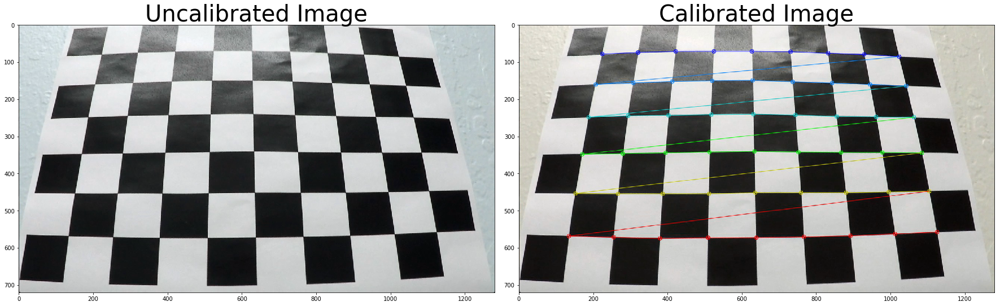

In [14]:
#Print one result to verify calibration on image with founded corners was successful

uncal_img = mpimg.imread('data/camera_cal/calibration03.jpg')
cal_img = mpimg.imread('data/output_images/corners_found.jpg')
print_images(uncal_img, 'Uncalibrated Image',  cal_img, 'Calibrated Image')

## Build A Pipeline

Now that we have calibrated our camera for radial and tangential distortion we can reuse those coefficients to undistort new images or frames of video.

Next we need to weave together a combination of methods (i.e., color transforms, gradients..etc.) to create a binary image containing the likelihood of the location of lane pixels and project that image back on our original image. This image will just be a visual verification that these pixels are identified as part of the lane lines.

We will proceed to build out the Advance lane line detection pipeleine. To see each step progress we will use a test image and analysis the results at each step of the way.

## Step 2: Undistort Image

Step 2: To test the distortion matrix we found from our camera calibration step we will create a undistort function.

Here we will pass a distorted image with radial and tangential distortions. We will use our distortion parameters to undistort the image.

In [15]:
#Function to undistort an image with camera distortion coefficients already calculated
def cal_undistort(dist_image):
    # Use cv2.calibrateCamera() and cv2.undistort() with previous objpoints & imgpoints

    # Convert to grayscale
    gray = cv2.cvtColor(dist_image, cv2.COLOR_RGB2GRAY)

    # Get distortion coefficients from our pickle file
    dist_pickle = pickle.load(open("data/camera_cal/calibration_pickle.p", 'rb'))
    mtx = dist_pickle['mtx']
    dist = dist_pickle['dist']
    
    # Apply undistort function     
#    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(obj_points, img_points, gray.shape[::-1], None, None)
    undist_image = cv2.undistort(dist_image, mtx, dist, None, mtx)

        
    return undist_image

In [16]:
#Undistort calling function for a distorted image using coefficients found from calibration images:

def undistort_calling(filepath):

    images = glob.glob(filepath)

    for idx, fname in enumerate(images):        #read in each image
        distorted = cv2.imread(fname)
        head, tail = os.path.split(fname)
        undist = cal_undistort(distorted) 
        write_name = 'data/output_images/undistort_'+str(idx+1)+'.jpg'
        cv2.imwrite(write_name, undist)    #Output image to file
        print_images(distorted, 'Distorted Image '+tail,  undist, 'Undistorted Image')  

We will then use the distort images in the project test folder as a demonstration that our calibration is correct. 

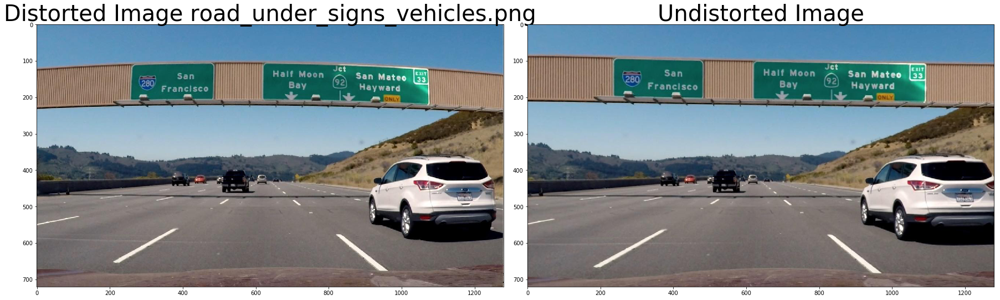

In [17]:
undistort_calling('data/images/road_under_signs_vehicles.png')

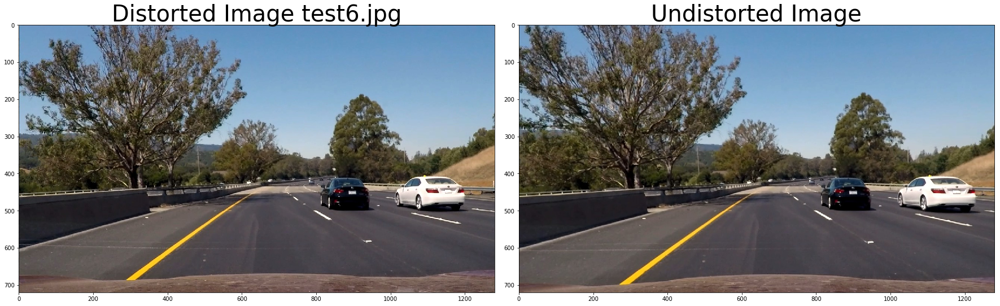

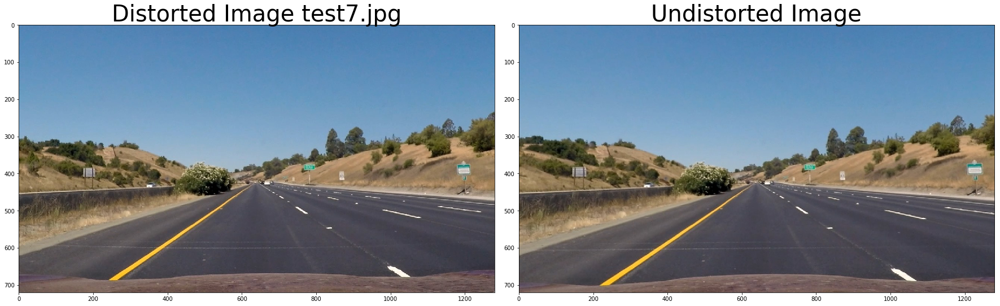

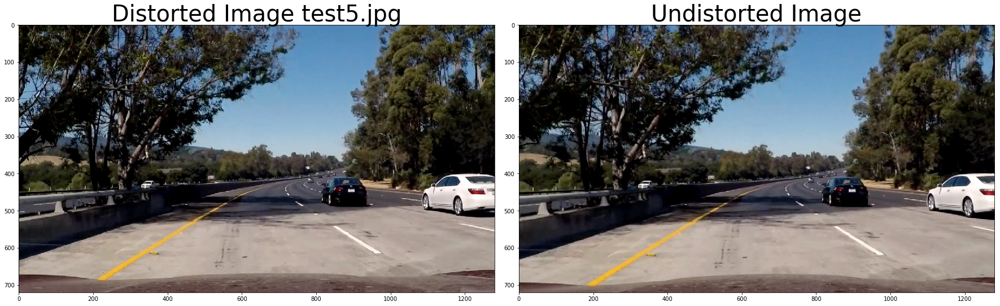

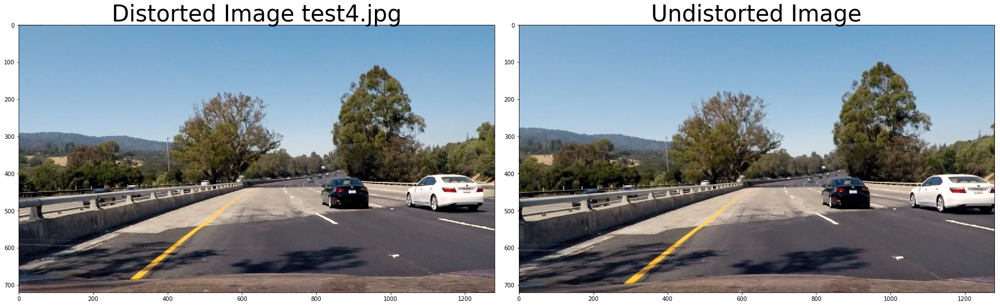

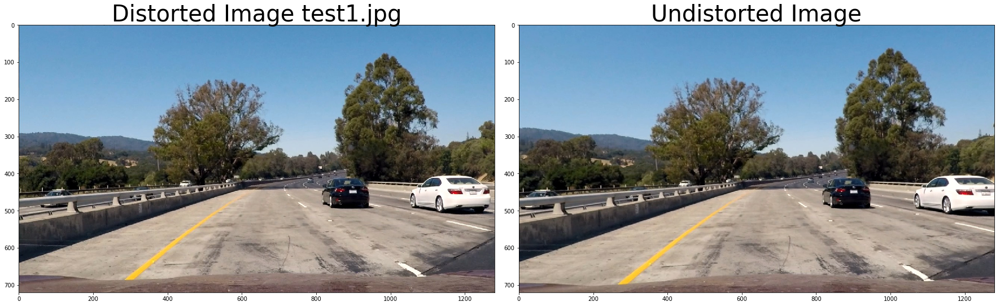

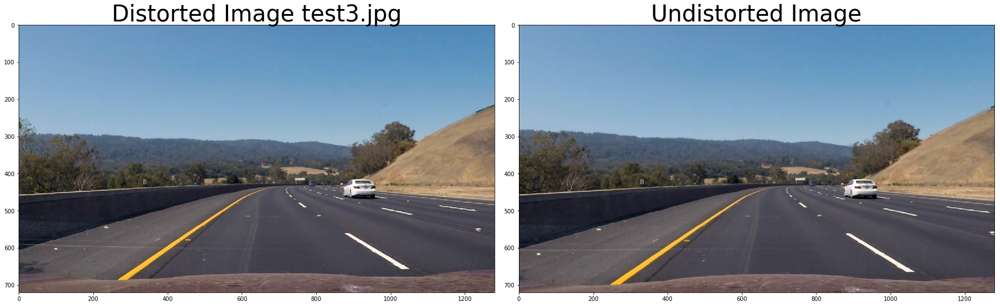

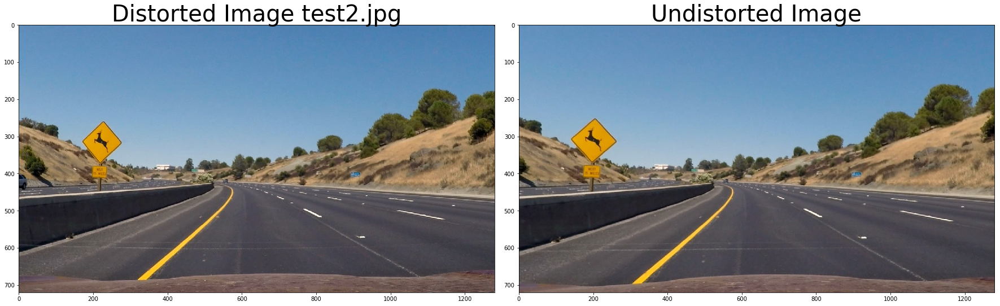

In [18]:
undistort_calling('data/road_test_images/test*.jpg')

It might be difficult to see the changes from the original to end result, but if you look closely to the edges of the undistorted image you will see some slight corrections in radial distortion.

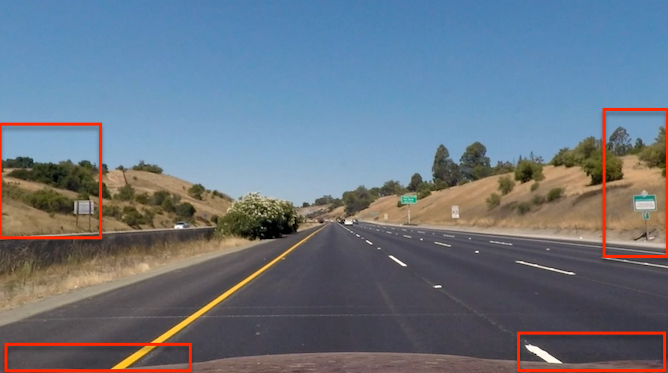

## Step 3: Gradient & Color transformation

Now we will run through a combination of Color and Gradient transformations on our images. The objective here is to use color transforms, gradients, etc., to create a thresholded binary image to see what will produce images with lane lines illustrated the best.

In [19]:
#Gradient and Colour transformation functions

#Produce a directional gradient
def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0,255)):
    
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1))
                                
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    binary_sobel = np.zeros_like(scaled_sobel)
                                
    #Apply threshold
    binary_sobel[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1

    return binary_sobel
 
                                
                                
#Produce a magnitude gradient
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0,255)):

    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    sobelmag = np.sqrt((sobelx**2) + (sobely**2))
    scale_factor = np.max(sobelmag)/255                                
    gradmag = (sobelmag/scale_factor).astype(np.uint8)

    #Create a binary threshold based on magnitude values:
    binary_mag = np.zeros_like(gradmag)
    binary_mag[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1

    return binary_mag


#Produce a gradient based on arctan values                               
def dir_thresh(img, sobel_kernel=3, arc_thresh=(0, np.pi/2)):

    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)

    with np.errstate(divide='ignore', invalid='ignore'):
        absgraddir = np.absolute(np.arctan(sobely/sobelx))
        binary_arc = np.zeros_like(absgraddir)
                               
    #Create a binary threshold based on arctan values:
    binary_arc[(absgraddir >= arc_thresh[0]) & (absgraddir <= arc_thresh[1])] = 1

    return binary_arc

                                
    
def color_thresh(img, s_thresh=(0, 255), v_thresh=(0, 255)):
    
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS) #convert to HLS space
    h_channel = hls[:,:,0]
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1

    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV) #or HSV space
    h2_channel = hsv[:,:,0]
    s2_channel = hsv[:,:,1]
    v_channel = hsv[:,:,2]
    v_binary = np.zeros_like(v_channel)
    v_binary[(v_channel >= v_thresh[0]) & (v_channel <= v_thresh[1])] = 1
   
    col_binary = np.zeros_like(s_channel)
    col_binary[(s_binary == 1) & (v_binary == 1)] = 1
    
    return col_binary



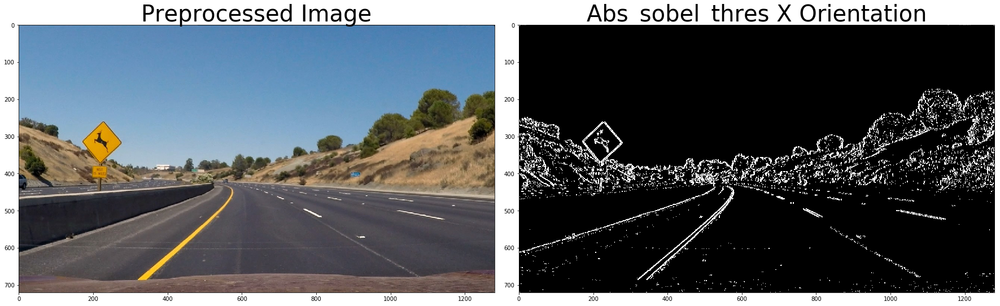

In [20]:
#Demostration of Abs_sobel_threshold with 'x' orientation
f_name = 'data/road_test_images/test2.jpg'
image_test = cv2.imread(f_name)    
preprocess_test = abs_sobel_thresh(image_test, sobel_kernel=5, thresh=(20,150))     
print_images(image_test, 'Preprocessed Image',  preprocess_test, 'Abs_sobel_thres X Orientation')

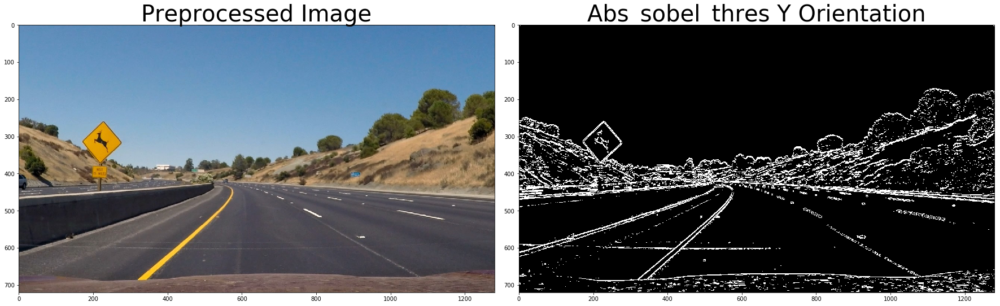

In [21]:
#Demostration of Abs_sobel_threshold with 'y' orientation
f_name = 'data/road_test_images/test2.jpg'
image_test = cv2.imread(f_name)    
preprocess_test = abs_sobel_thresh(image_test, orient='y', sobel_kernel=5, thresh=(20,150))     
print_images(image_test, 'Preprocessed Image',  preprocess_test, 'Abs_sobel_thres Y Orientation')

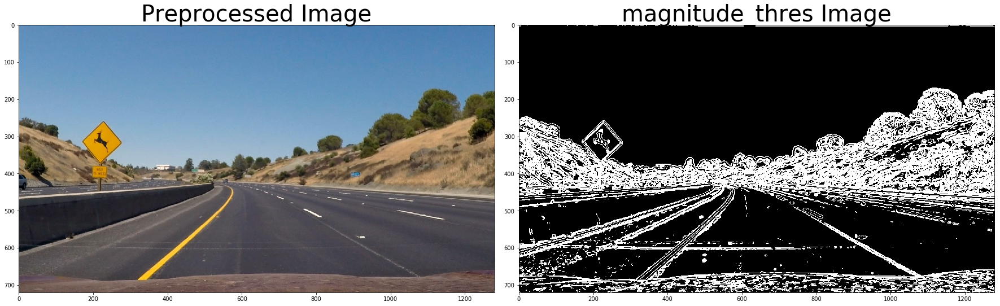

In [22]:
#Demostration of Magnitude_threshold in 'x' & 'y' orientation
f_name = 'data/road_test_images/test2.jpg'
image_test = cv2.imread(f_name)    
preprocess_test = mag_thresh(image_test, sobel_kernel=9, mag_thresh=(10,80))
print_images(image_test, 'Preprocessed Image',  preprocess_test, 'magnitude_thres Image')

/Users/devin/anaconda3/lib/python3.6/site-packages/ipykernel/__main__.py:52: RuntimeWarning: invalid value encountered in greater_equal
/Users/devin/anaconda3/lib/python3.6/site-packages/ipykernel/__main__.py:52: RuntimeWarning: invalid value encountered in less_equal


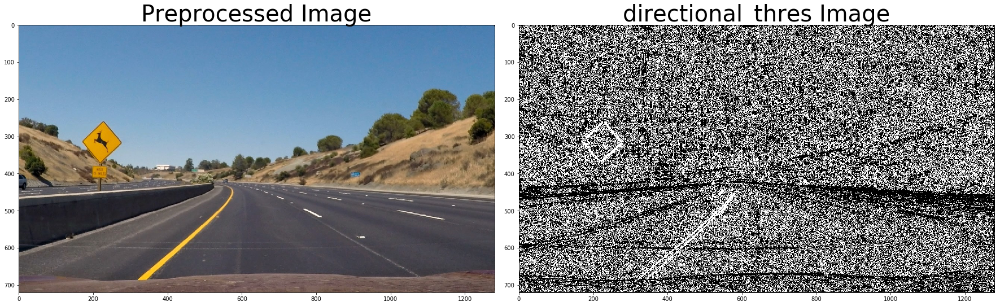

In [23]:
#Demostration of Directional_threshold
f_name = 'data/road_test_images/test2.jpg'
image_test = cv2.imread(f_name)    
preprocess_test = dir_thresh(image_test, sobel_kernel=3, arc_thresh=(0.2, np.pi/3))
print_images(image_test, 'Preprocessed Image',  preprocess_test, 'directional_thres Image')

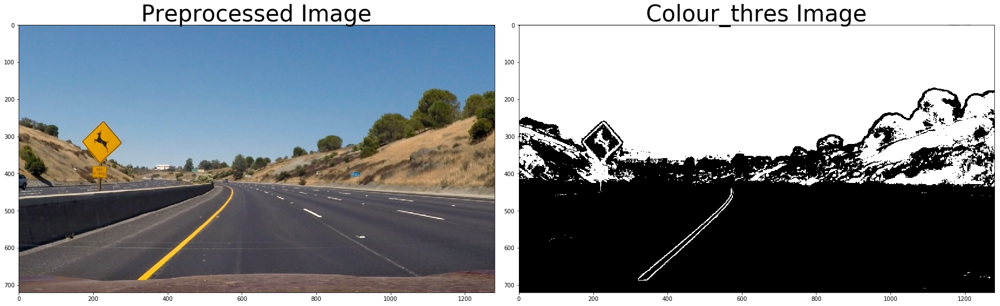

In [24]:
#Demostration of HLS and HSV Colour_threshold - test 1
f_name = 'data/road_test_images/test2.jpg'
image_test = cv2.imread(f_name)    
preprocess_test = color_thresh(image_test, s_thresh=(70, 255), v_thresh=(33, 220))
print_images(image_test, 'Preprocessed Image',  preprocess_test, 'Colour_thres Image')

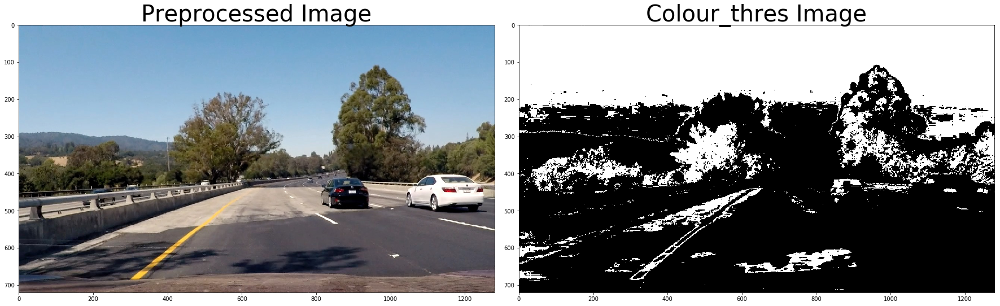

In [25]:
#Demostration of HLS and HSV Colour_threshold - test 2
f_name = 'data/road_test_images/test4.jpg'
image_test = cv2.imread(f_name) 
preprocess_test = color_thresh(image_test, s_thresh=(70, 255), v_thresh=(33, 220))
print_images(image_test, 'Preprocessed Image',  preprocess_test, 'Colour_thres Image')

Now that we have tested each colour and gradient transformation function separately we will now pull them into one function for our pipeline

In [26]:
def color_gradient(image):

    gradx = abs_sobel_thresh(image, sobel_kernel=9, thresh=(70,100))
    grady = abs_sobel_thresh(image, orient='y', sobel_kernel=5, thresh=(20,255))
    mag_binary = mag_thresh(image, sobel_kernel=9, mag_thresh=(80,210))    
    dir_binary = dir_thresh(image, sobel_kernel=17, arc_thresh=(0, np.pi/2))
    c_binary = color_thresh(image, s_thresh=(120,255), v_thresh=(130,255))

    postprocessImage = np.zeros_like(image[:,:,0])
    postprocessImage[((gradx == 1)&(grady == 1) |
                     (c_binary == 1) |
                     (mag_binary == 1)) ]=255


    return postprocessImage

We can test run our test images with this consolidated colour gradient function of our pipeline with a calling function.

In [27]:
#Color_gradient calling function for a prerocessed image

def col_grad_calling(filepath):

    images = glob.glob(filepath)

    for idx, fname in enumerate(images):        #read in each image
        preprocessed = cv2.imread(fname)
        head, tail = os.path.split(fname)
        file_end = tail.split("_")             #isolate just file# and extension
        postprocessed = color_gradient(preprocessed)
        write_name = 'data/output_images/colorgrad_'+file_end[1]
        cv2.imwrite(write_name, postprocessed)    #Output image to file
        print_images(preprocessed, 'Preprocessed Image '+tail,  postprocessed, 'Color Gradient Transformation')  

/Users/devin/anaconda3/lib/python3.6/site-packages/ipykernel/__main__.py:52: RuntimeWarning: invalid value encountered in greater_equal
/Users/devin/anaconda3/lib/python3.6/site-packages/ipykernel/__main__.py:52: RuntimeWarning: invalid value encountered in less_equal


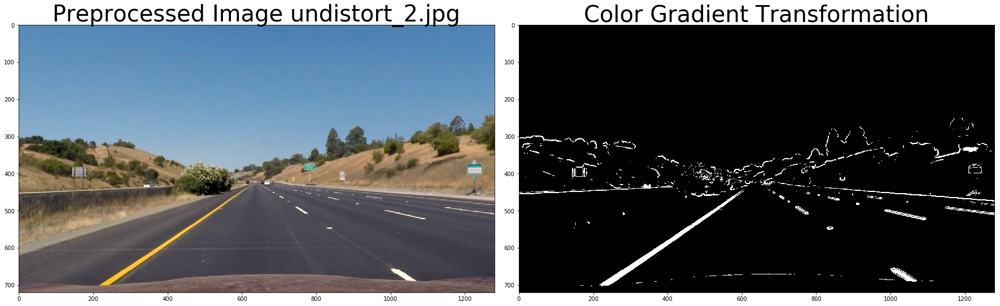

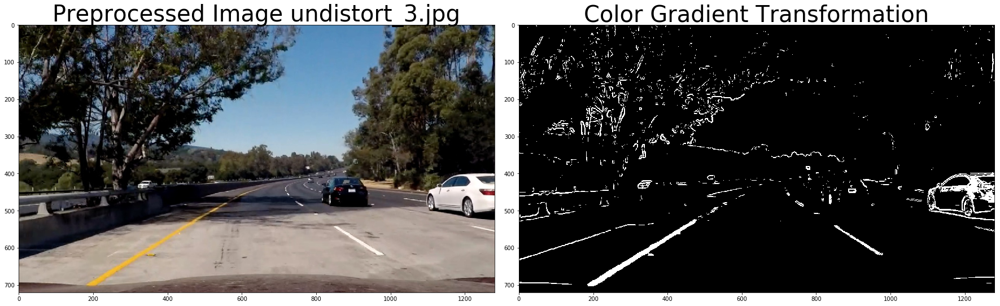

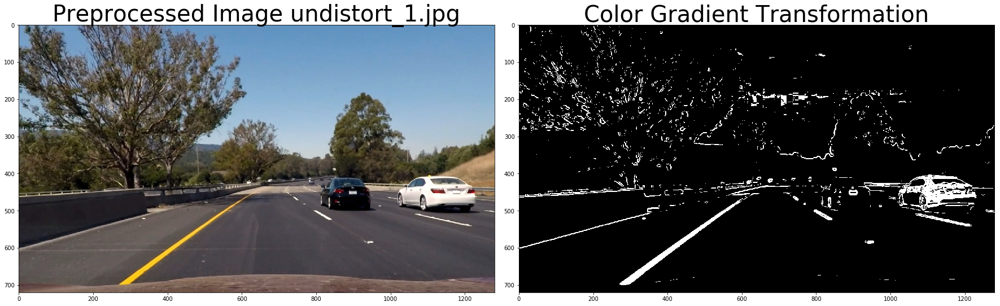

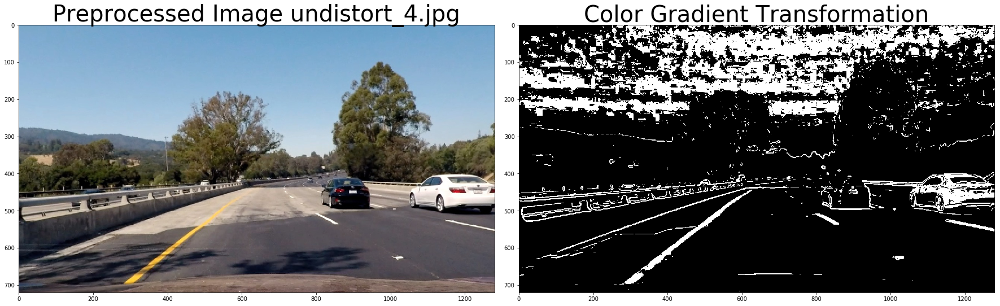

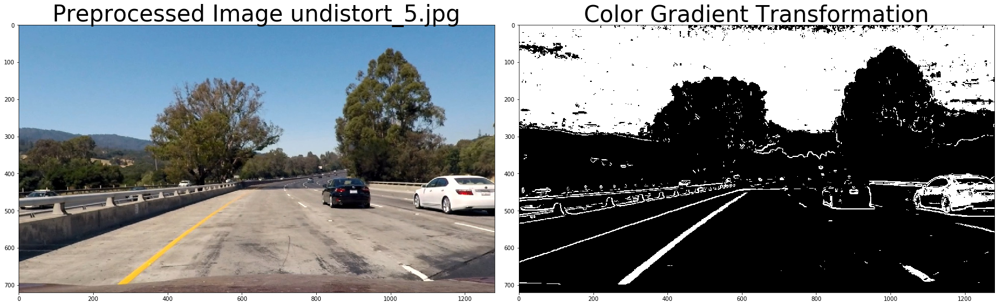

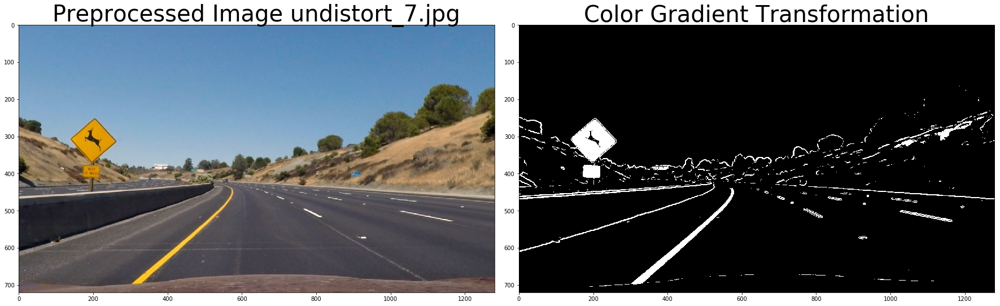

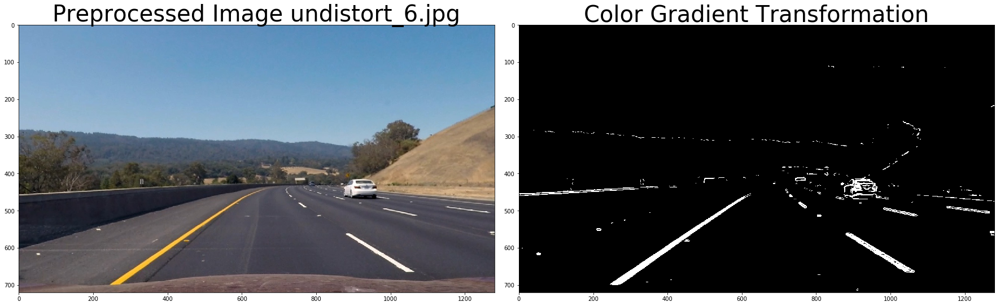

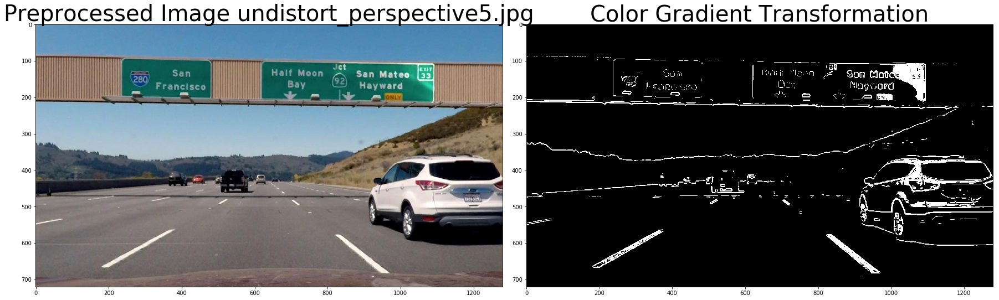

In [28]:
col_grad_calling('data/output_images/undistort_*.jpg')

Note that the pipeline correctly maps out curved lines and does not fail when shadows or pavement color changes are present.

## Step 4: Perspective transformation

Next step is to take the perspective transformation to see the 'birds eyes view' to see the lane lines from above which will be necessary for further analysis. Here we are performing a perspective transform. See below for an example image that shows this transformation process.

In [29]:
# Applies an image mask with region outlines by a polygon of 'vertices'

def region_of_interest(img, vertices):
    """
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    `vertices` should be a numpy array of integer points.
    """
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
 
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
        
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image

In [33]:
#Function to take undistorted road image and return a birds eyeview 'warped' perspective transformation

def perspective_trans(unwarped_img):

    s = unwarped_img.shape #Get image dimension
#    print('Unwarped image shape is :',s)
    img_size = (s[1],s[0])
#    print('The 1st index of img_size is :',img_size[0],' and 2nd is :',img_size[1])
    bot_width = 0.76   #percent of bottom line of trapezoid 
    mid_width = 0.23   #percent of middle 'distant' line of trapezoid 
    height_pct = 0.68   #percent of trapezoid height
    bottom_trim = 0.91 #percent from top to bottom of image to exclude car hood
    offset = img_size[0]*0.22
    
    top_left = [s[1]*(0.5-mid_width/2),s[0]*height_pct]
    top_right = [s[1]*(0.5+mid_width/2),s[0]*height_pct] 
    bot_right = [s[1]*(0.5+bot_width/2),s[0]*bottom_trim]
    bot_left = [s[1]*(0.5-bot_width/2),s[0]*bottom_trim]
        
    src = np.float32([[top_left], [top_right], [bot_right], [bot_left]])
                      
    dst = np.float32([[offset,0],
                      [img_size[0]-offset,0],
                      [img_size[0]-offset,img_size[1]],
                      [offset, img_size[1]]])

    img = unwarped_img
    
    #Helper red & blue points on image to visualize the Region of Interest boundaries
#    cv2.circle(img, (int(top_left[0]),int(top_left[1])), 7, (0,0,255), -1)   #top-left corner
#    cv2.circle(img, (int(top_right[0]),int(top_right[1])), 7, (255,0,0), -1)   #top-right corner
#    cv2.circle(img, (int(bot_left[0]),int(bot_left[1])), 7, (0,0,255), -1)    #bottom-left corner
#    cv2.circle(img, (int(bot_right[0]),int(bot_right[1])), 7, (255,0,0), -1)  #bottom-right corner


    #Define points of our polygon region
    vertices = np.array([[(int(top_right[0]),int(top_right[1])),
                          (int(top_left[0]),int(top_left[1])),
                          (int(bot_left[0]),int(bot_left[1])),
                          (int(bot_right[0]),int(bot_right[1]))]], dtype=np.int32)
        
    roi_img = region_of_interest(unwarped_img, vertices)   #Crop out ROI from image
    
    M = cv2.getPerspectiveTransform(src, dst)  #get the transform matrix
    Minv = cv2.getPerspectiveTransform(dst, src) #get inverse matrix to use to 'un-unwarp' later

    warped = cv2.warpPerspective(roi_img, M, img_size, flags=cv2.INTER_LINEAR) 

    return warped, Minv



In [34]:
#Color_gradient calling function for a prerocessed image

def perspective_calling(filepath):

    images = glob.glob(filepath)

    for idx, fname in enumerate(images):        #read in each image
        unwarped_img = cv2.imread(fname)
        head, tail = os.path.split(fname)
        file_end = tail.split("_")             #isolate just file# and extension
        warped_img, Minv = perspective_trans(unwarped_img)
        write_name = 'data/output_images/perspective_'+file_end[1]   
        cv2.imwrite(write_name, warped_img)    #Output image to file
        print_images(unwarped_img, 'Road View '+tail,  warped_img, 'Birds Eye View of Lane Lines')  

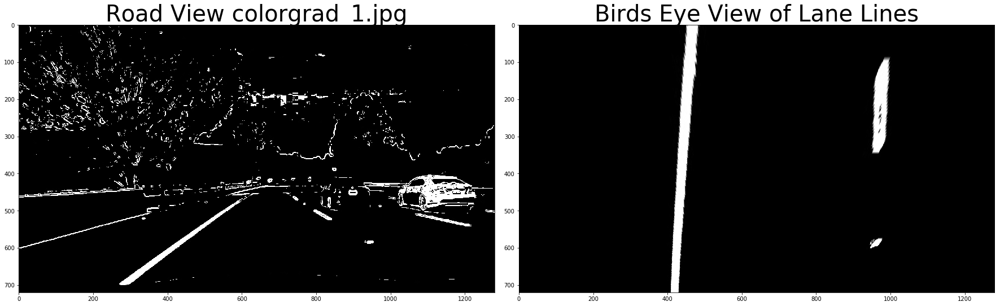

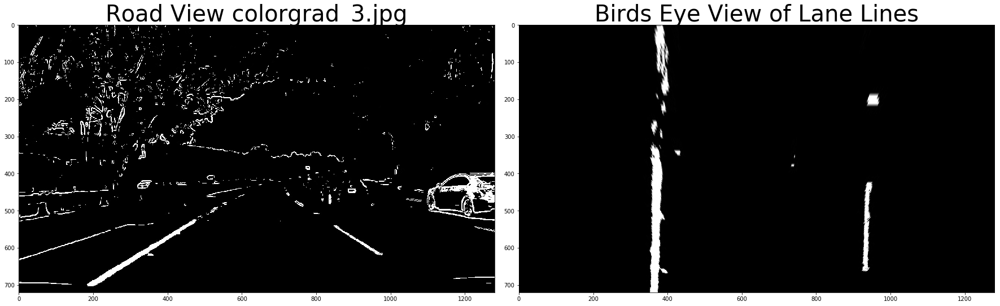

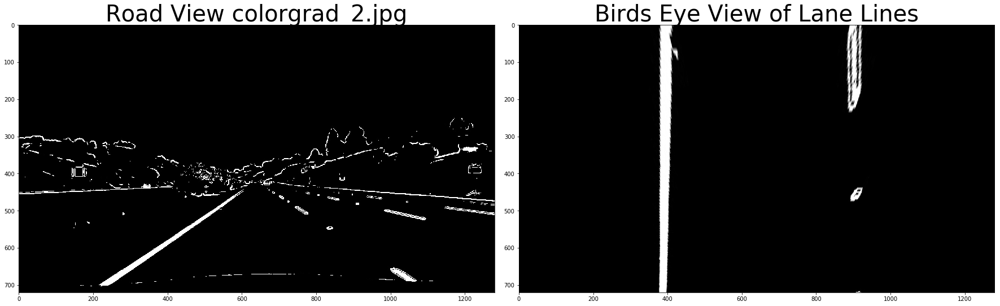

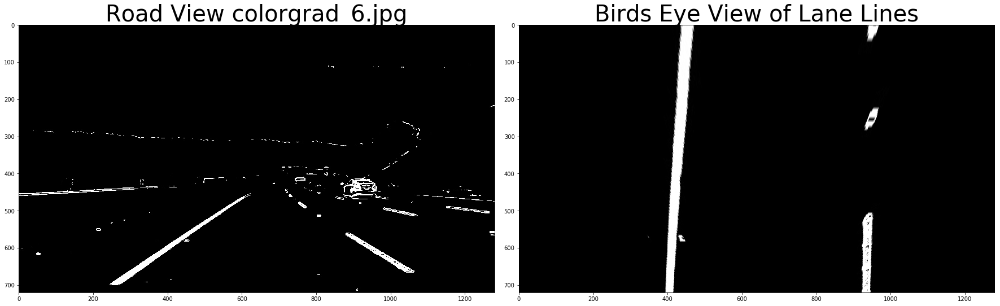

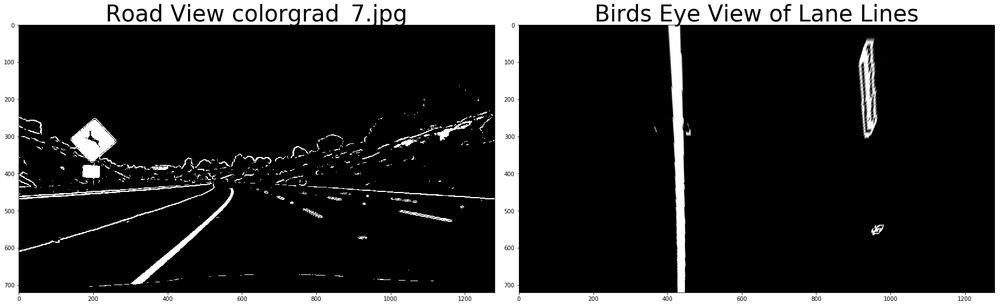

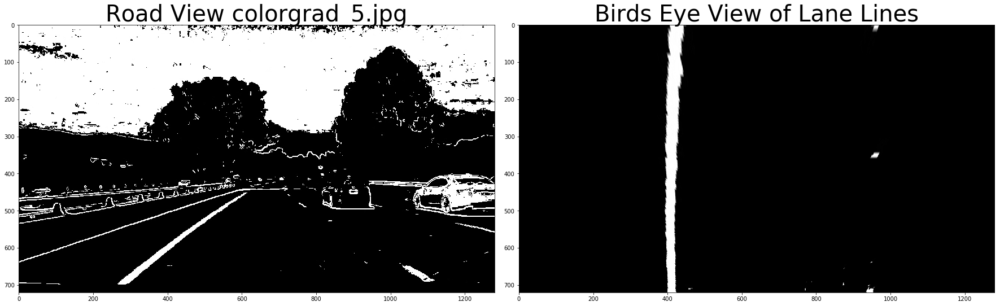

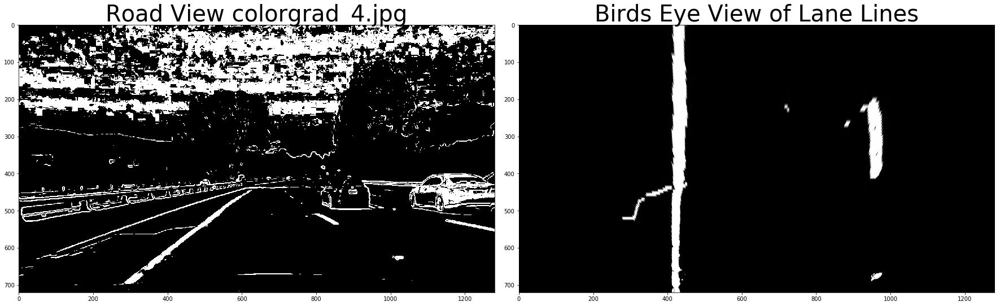

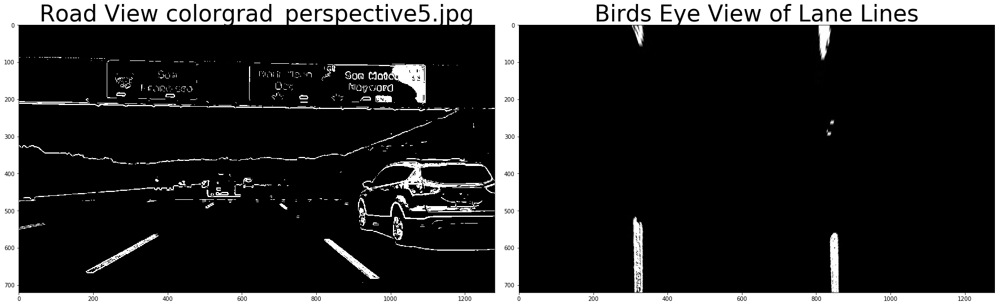

In [35]:
perspective_calling('data/output_images/colorgrad_*.jpg')

## Step 5: Detecting Lane Line

###    Method I : Histogram Sliding Window

To start the process of finding the lane lines in a image frame, I figure it was best to get a general starting point on the frame where to start the search.

We can do this by taken the summation of the 'active' pixels along the x-axis in a histogram which will give a general area of interest on where to start our search. The histogram of the test image above looks like the forwarding:

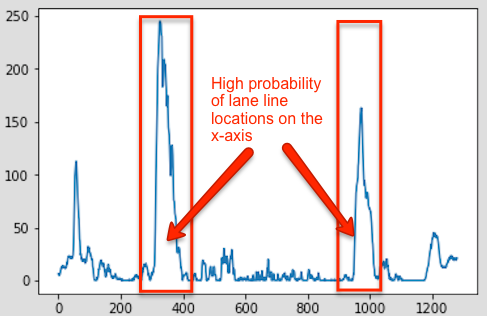

As you can see we have peaks where the active pixels are summed in the histogram. This provides (at this time of frame) our best probabability of the location of the left and right lane lines. With this histogram we will take the midpoint of a range around these peaks to start our search.

In [167]:
def find_lane_pixels(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint


    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base
    avgdistbtwlines = rightx_current - leftx_current


    
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        ### TO-DO: Find the four below boundaries of the window ###
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
 
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 
        
        ### TO-DO: Identify the nonzero pixels in x and y within the window ###
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        ### TO-DO: If you found > minpix pixels, recenter next window ###
        ### (`right` or `leftx_current`) on their mean position ###
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
        
        
    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty, out_img

In [215]:
def fit_polynomial(binary_warped):
    # Find our lane pixels first
#    binary_warped = binary_warped[:,:,0]
    
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)

    # Fit a second order polynomial to each using `np.polyfit`
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)


    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )

#------------------------------------------------------------------------------



## CORRECTION CODE TO FIX LANES NOT MATCHING


    polys_miss = 0 
    



    
    
    if (len(lefty) == 0 | len(righty) == 0):

        print('I found either lefty or righty to be zero but I aint going to correct it!')
        try:
            left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
            right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
        except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
            print('The function failed to fit a line!')
            left_fitx = 1*ploty**2 + 1*ploty
            right_fitx = 1*ploty**2 + 1*ploty


        pass
     
    else:
        if len(leftx) > len(rightx):
            avg_rightx_int = round(np.mean(rightx),2)      #find avg. x-intercept for right lane

            right_fit[0] = left_fit[0]
            right_fit[1] = left_fit[1]
            right_fit[2] = avg_rightx_int                 #change 3rd poly coef. to avg pixel x-intercept
            right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2] 
            left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
            print('I corrected right_fit in fit_polymonial b/c leftx had :',len(leftx),'and rightx had :',len(rightx))


        else:
            avg_leftx_int = round(np.mean(leftx),2)      #find avg. x-intercept for left lane

            left_fit[0] = right_fit[0]
            left_fit[1] = right_fit[1]
            left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
            right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2] 
            print('I corrected left_fit in fit_polymonial b/c leftx had :',len(leftx),'and rightx had :',len(rightx))




#------------------------------------------------------------------------------

#    try:
#        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
#        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
#    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
#        print('The function failed to fit a line!')
#        left_fitx = 1*ploty**2 + 1*ploty
#        right_fitx = 1*ploty**2 + 1*ploty

        
    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Plots the left and right polynomials on the lane lines
#    plt.plot(left_fitx, ploty, color='yellow')
#    plt.plot(right_fitx, ploty, color='yellow')

    return out_img, left_fit, right_fit, polys_miss

In [38]:
#histogram method - Fit_polynomial calling function for a prespective binary image

def fit_polymonial_calling(filepath):

    images = glob.glob(filepath)

    for idx, fname in enumerate(images):        #read in each image
        perspectivewarped = cv2.imread(fname)
        head, tail = os.path.split(fname)
        file_end = tail.split("_")             #isolate just file# and extension
        lanefinding1, left_fit, right_fit = fit_polynomial(perspectivewarped)
        write_name = 'data/output_images/lanefinding1_'+file_end[1]   
        cv2.imwrite(write_name, lanefinding1)    #Output image to file
        print_images(perspectivewarped, 'Binary Image '+tail,  lanefinding1, 'Finding Lines w Histogram') 
#        print('The Left_fit coefficients are for '+tail+' are :', left_fit)
#        print('The Right_fit coefficients are for '+tail+' are :', right_fit)

Here we can see the left and right lane lines tracked and drawn with a best fit polynomial line as the green window moves over the frame image from bottom to top.

###  Method I : Search Around Polynomial

In [169]:
def fit_poly(img_shape, leftx, lefty, rightx, righty):
    # Fit a second order polynomial to each with np.polyfit() ###
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, img_shape[0]-1, img_shape[0])
    # Calc both polynomials using ploty, left_fit and right_fit ###
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    return left_fitx, right_fitx, ploty

In [175]:

def search_around_poly(binary_warped, left_fit, right_fit):
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    margin = 100

#    binary_warped = binary_warped[:,:,0]

    
    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    #Define the pixels that fall between a margin of the previous polynomial line
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit new polynomials
#    left_fitx, right_fitx, ploty = fit_poly(binary_warped.shape, leftx, lefty, rightx, righty)

   
#    else:    
    #Copying fit_poly function here to use as a correction of poly's if needed
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0])
    # Calc both polynomials using ploty, left_fit and right_fit ###
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

#--------------------------------------------------------------------------------
#------------------------------------------------------------------------------
# looking to correct ploynomials again is they are out of fit the other polynomial

    polys_miss = 0
    avg_line_diff = round(np.mean(rightx) - np.mean(leftx),0)    
#    print('In search_poly - avg pixel diff. from leftx to rightx is:', avg_line_diff)
    
    for a, b in zip(left_fitx, right_fitx):
        sum_diff =+ round(b-a,0)
        
    avg_mea_diff = round(np.mean(sum_diff),0)
    
    true_diff = abs(avg_mea_diff - avg_line_diff)
#    print('In search_poly - avg measured diff. btw left-right ploy is :', true_diff)
    
    if true_diff >= 50:
        polys_miss =+ 1
        print('In Search Around Poly function - poly doesnt match with road pixel line')
        print('Before Left poly coefs :', left_fit)
        print('Before Right poly coefs :', right_fit)

        if len(leftx) > len(rightx):
            right_fit[0] = left_fit[0]
            right_fit[1] = left_fit[1]
            right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2] 
            left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]


        else:
            left_fit[0] = right_fit[0]
            left_fit[1] = right_fit[1]
            left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
            right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2] 


        print('After Left poly coefs :', left_fit)
        print('After Right poly coefs :', right_fit)    
#------------------------------------------------------------------------------        

            
    
    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.2, 0)
    
    # Plot the polynomial lines onto the image
#    plt.plot(left_fitx, ploty, color='yellow')
#    plt.plot(right_fitx, ploty, color='yellow')
    ## End visualization steps ##
    
    return result, leftx, lefty, rightx, righty, polys_miss

(1, 2, 3, 4, 5, 6, 7, 8, 9, 10)
3


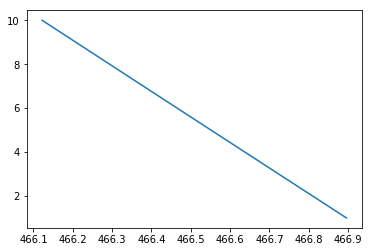

In [210]:
a = [ 466.89591824, 466.80969857, 466.72352892, 466.63740931, 466.55133972, 466.4653201, 466.37935062, 466.29343112, 466.20756164,  466.12174219]
b = (1,2,3,4,5,6,7,8,9,10)
print(b)
plt.plot(a,b)
len(b)
leftx_near = int((len(b))/3)
print(leftx_near)

In [212]:
#Main pipeline lane line finding module to take warped image and output image with some active pixel tracking

def find_lanelines(perspectivewarped):
    
    
    lanefinding1, left_fit, right_fit, polys_miss = fit_polynomial(perspectivewarped)
#    lanefinding2, leftx, lefty, rightx, righty, polys_miss = search_around_poly(perspectivewarped, left_fit, right_fit)

     
    return lanefinding1, left_fit, right_fit, polys_miss   #will use left/right x-y's later to find curves

#    return lanefinding1, leftx, lefty, rightx, righty, polys_miss   #will use left/right x-y's later to find curves

## Step 6: Draw Boundaries & Measure Curve

In [192]:
#Draws road boundaries & calculates curvature/offset to output on image

#def draw_boundaries(image, leftx, lefty, rightx, righty, ym_per_pix=10/720, xm_per_pix=4/384):
 
def draw_boundaries(image, left_fit, right_fit, ym_per_pix=10/720, xm_per_pix=4/384):


    window_width = 25
    window_height = 80
    
    
    ploty = np.linspace(0, image.shape[0]-1, image.shape[0] )  #Use larger number of y points  
    yvals = range(0, image.shape[0])   #create continuous y-value array    
    res_yvals = np.arange(image.shape[0]-(window_height/2),0,-window_height)

#    print('ploty values are :', ploty)
#    print('yvals values are :', yvals)
#    print('res_yvals values are :', res_yvals)

    # Generate x and y values for plotting
#    left_fit = np.polyfit(res_yvals, leftx, 2)         #<--- had mismatch errors so I forced it the match with 'lefty'
#    left_fit = np.polyfit(lefty, leftx, 2)
    
#    left_fitx = left_fit[0]*res_yvals**2 + left_fit[1]*res_yvals + left_fit[2]
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    left_fitx = np.array(left_fitx, np.int32)            #<--- same mismatch errors here as well!
#    print('The points in left_fitx with ploty are: ', left_fitx)


#    right_fit = np.polyfit(res_yvals, rightx, 2)
#    right_fit = np.polyfit(righty, rightx, 2)         #<--- same mismatch errors here as well!

    
   
    
#    print('The coeficients for right fit are: ', right_fit)
#    right_fitx = right_fit[0]*res_yvals**2 + right_fit[1]*res_yvals + right_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    right_fitx = np.array(right_fitx, np.int32)        #<--- same mismatch errors here as well!
#    print('The points in right_fitx with ploty are: ', right_fitx)

    
    #----------------------------------------------------
    #Make the curved lines look to have depth on the image
    left_lane = np.array(list(zip(np.concatenate((left_fitx-window_width/2, left_fitx[::-1]+window_width/2), axis=0),
                                  np.concatenate((ploty, ploty[::-1]), axis=0))), np.int32)
#    print('The left lane stats are: ', left_lane)


    right_lane = np.array(list(zip(np.concatenate((right_fitx-window_width/2, right_fitx[::-1]+window_width/2), axis=0),
                                  np.concatenate((ploty, ploty[::-1]), axis=0))), np.int32)
#    print('The right lane stats are: ', right_lane)


    inner_lane = np.array(list(zip(np.concatenate((left_fitx+window_width/2, right_fitx[::-1]-window_width/2), axis=0),
                                  np.concatenate((ploty, ploty[::-1]), axis=0))), np.int32)


    
    #----------------------------------------------------
    #Draw road boundaries on image
    roadlines = np.zeros_like(image)
    road_bkg = np.zeros_like(image)

    cv2.fillPoly(roadlines, [left_lane], color=[0,0,255])
    cv2.fillPoly(roadlines, [right_lane], color=[255,0,0])
    cv2.fillPoly(roadlines, [inner_lane], color=[50,255,0])
    cv2.fillPoly(road_bkg, [left_lane], color=[255,255,255])
    cv2.fillPoly(road_bkg, [right_lane], color=[255,255,255])
    
    
    
    #-----------------------------------------------------
    #Calculating curvature and offsets for finishing step


    #Fit a curve to the left lane and measure its curvature

#    curve_fit_cr = np.polyfit(np.array(res_yvals, np.float32)*ym_per_pix,  #<--- same mismatch errors here as well!
#                              np.array(leftx, np.float32)**xm_per_pix, 2)

#    curve_fit_cr = np.polyfit(np.array(lefty, np.float32)*ym_per_pix,
#                              np.array(leftx, np.float32)**xm_per_pix, 2)

    curve_fit_cr = np.polyfit(np.array(ploty, np.float32)*ym_per_pix,
                              np.array(right_fitx, np.float32)**xm_per_pix, 2)


    
    curverad = ((1 + (2*curve_fit_cr[0]*yvals[-1]*ym_per_pix + curve_fit_cr[1])**2)**1.5)/ np.absolute(2*curve_fit_cr[0])


    #Calculate the offset of the car on the road
    camera_center = (left_fitx[-1] + right_fitx[-1])/2    #Pick pixels closest to car and average
    center_diff = (camera_center - image.shape[1]/2)*xm_per_pix   #calc. offset in meters


#    plt.imshow(roadlines)
#    plt.show()

#    cv2.putText(roadlines, 'Left Polys Coef. = A: '+str(round(left_fit[0],2))+', B: '+str(round(left_fit[1],2))+', C: '+str(round(left_fit[2],2)),
#                (50,150), cv2.FONT_HERSHEY_SIMPLEX, 1, (255,255,255),2)

#    cv2.putText(roadlines, 'Right Polys Coef. = A: '+str(round(right_fit[0],2))+', B: '+str(round(right_fit[1],2))+', C: '+str(round(right_fit[2],2)),
#                (50,200), cv2.FONT_HERSHEY_SIMPLEX, 1, (255,255,255),2)


    
    return roadlines, camera_center, center_diff

## Step 7: Transpose Back on Road

This step in our pipeline is to demonstrate that the lane boundaries we found were correctly identified. We do this by taken the previous rectified image with our calculated lane lines and polynomials and 'warp' it back onto the original image and plotted to identify the lane boundaries.

In [66]:
#Function to take warp road section and 'unwarp' it back in the road.

def perspective_back(road_img, warped_img, Minv):

    #Get image dimension
    img_size = (warped_img.shape[1], warped_img.shape[0] )

    transposed = cv2.warpPerspective(warped_img, Minv, img_size, flags=cv2.INTER_LINEAR) 
    superimposed = cv2.addWeighted(road_img, 1.0, transposed, 1.0, 1)

    return superimposed

In [44]:
#Perspective_back calling function 're-warp' an birds eye image of the lanes back on the road

def perspective_back_calling(filepath1, filepath2, Minv):

    road_img = cv2.imread(filepath1)
    warped_img = cv2.imread(filepath2)
#    head, tail = os.path.split(filepath2)  #get the last part of the file name for saving
#    file_end = tail.split("_")             #isolate just file# and extension
    print(file_end)

    rewarped_back = perspective_back(road_img, warped_img, Minv)
#    write_name = 'data/output_images/perspective_warped_'+file_end[1]
#    cv2.imwrite(write_name, warped_img)    #Output image to file
    print_images(warped_img, 'Birds Eye View',  rewarped_back, 'Rewarped Back to Road view')  

## Step 8: Write Stats on Image

In [45]:
def write_on_screen(post_image, curverad = 1500, center_diff = 0.500):
    
    side_pos = 'left'
    if center_diff <= 0:
        side_pos = 'right'
    
    
    cv2.putText(post_image, 'Radius of Curvature = '+str(round(curverad,3))+'(m)',
                (50,50), cv2.FONT_HERSHEY_SIMPLEX, 1, (255,255,255),2)
    cv2.putText(post_image, 'Vehicle is '+str(abs(round(center_diff,3)))+'m'+side_pos+' of center',
                (50,100),cv2.FONT_HERSHEY_SIMPLEX, 1, (255,255,255),2)


    
    return post_image

In [46]:
## FINAL PIPELINE MODULE

In [213]:
#The final pipeline will take in an raw image and find its lane lines

def pipeline(image, polymismatch = False):
    
    
    
    undist = cal_undistort(image)              #Step 2: use calibration to undistort image
    unwarped = color_gradient(undist)           #Step 3: create gradient binary image
    warped, Minv = perspective_trans(unwarped)   #Step 4: create birds eye view of road

#    lanelines, leftx, lefty, rightx, righty, polys_miss = find_lanelines(warped)    #Step 5: Detecting lane lines using various methods
    lanelines, left_fit, right_fit, polys_miss = find_lanelines(warped)    #Step 5: Detecting lane lines using various methods


#    roadlines, camera_center, center_diff = draw_boundaries(lanelines, leftx, lefty, rightx, righty)        #Step 6: draws road boundaries & calc. curvature/offset     
    roadlines, camera_center, center_diff = draw_boundaries(lanelines, left_fit, right_fit)        #Step 6: draws road boundaries & calc. curvature/offset     
    
    linesroad = perspective_back(image, roadlines, Minv)   #Step 7: warp lanes back on original
    fin_image = write_on_screen(linesroad, camera_center, center_diff) # Step 8: print info on image/screen

#    last_good_image = fin_image
#    else:
#        fin_image = last_good_image

#    fin_image = roadlines


    if polys_miss == 1:
        cv2.putText(fin_image, 'Measured fail to capture actual lane line here!',
                (50,150), cv2.FONT_HERSHEY_SIMPLEX, 1, (255,255,255),2)

#    cv2.putText(fin_image, 'Right Polys Coef. = A: '+str(round(right_fit[0],2))+', B: '+str(round(right_fit[1],2))+', C: '+str(round(right_fit[2],2)),
#                (50,200), cv2.FONT_HERSHEY_SIMPLEX, 1, (255,255,255),2)



    return fin_image
    

In [63]:
#Main pipeline calling function to test all components

def calling_pipeline(filepath):

    images = glob.glob(filepath)

    for idx, fname in enumerate(images):        #read in each image
        unprocessed_img = cv2.imread(fname)
        head, tail = os.path.split(fname)
        file_end = tail.split("_")             #isolate just file# and extension
        final_image = pipeline(unprocessed_img)
        
        write_name = 'data/output_images/pipelineimage_'+file_end[0]
        cv2.imwrite(write_name, final_image)    #Output image to file
        print_images(unprocessed_img, 'Plain Road View '+tail,  final_image, 'Lanes found Road View') 

I corrected right_fit in fit_polymonial b/c leftx had : 21936 and rightx had : 10044
I corrected right_fit in fit_polymonial b/c leftx had : 22381 and rightx had : 9684
I corrected right_fit in fit_polymonial b/c leftx had : 17190 and rightx had : 5012
I corrected right_fit in fit_polymonial b/c leftx had : 25020 and rightx had : 9133
I corrected right_fit in fit_polymonial b/c leftx had : 23533 and rightx had : 996
I corrected right_fit in fit_polymonial b/c leftx had : 22832 and rightx had : 8094
I corrected right_fit in fit_polymonial b/c leftx had : 21089 and rightx had : 11176
CPU times: user 7.19 s, sys: 740 ms, total: 7.93 s
Wall time: 6.6 s


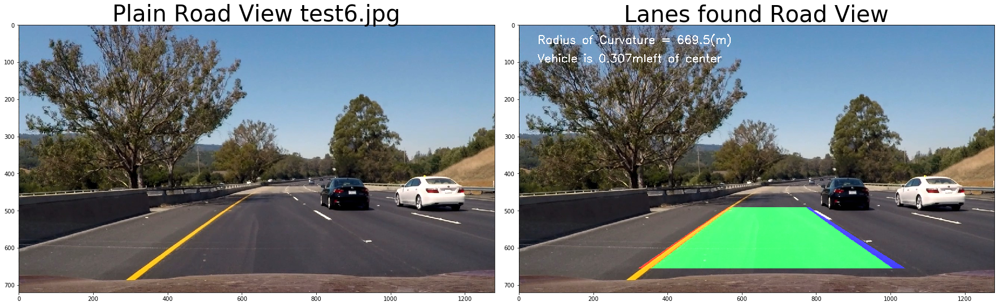

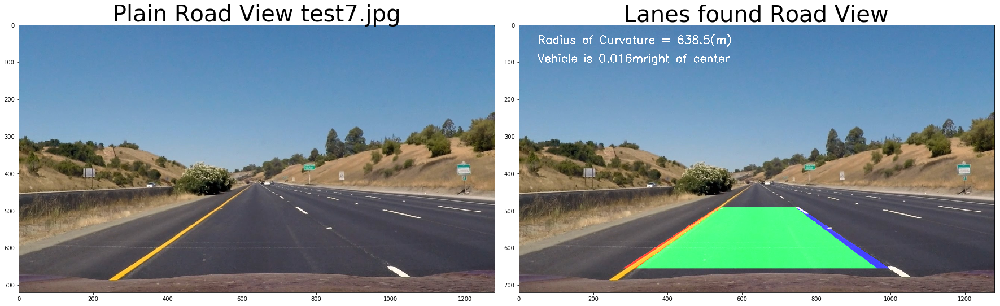

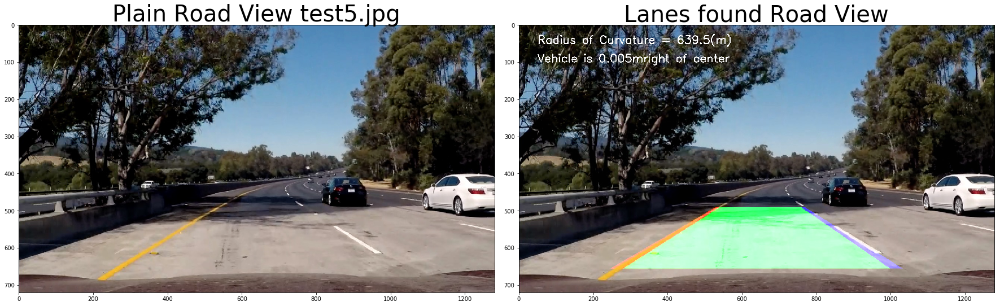

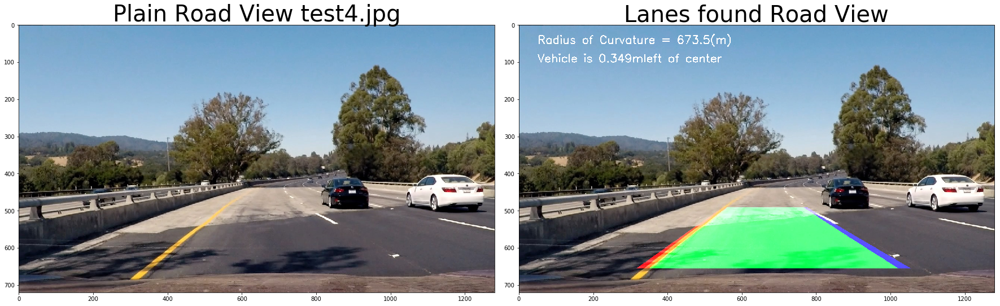

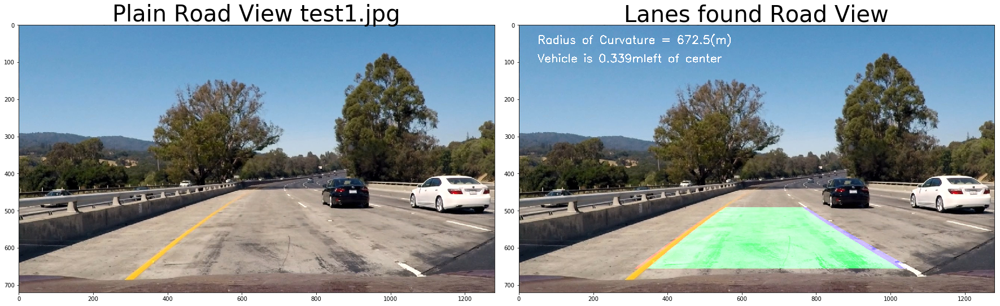

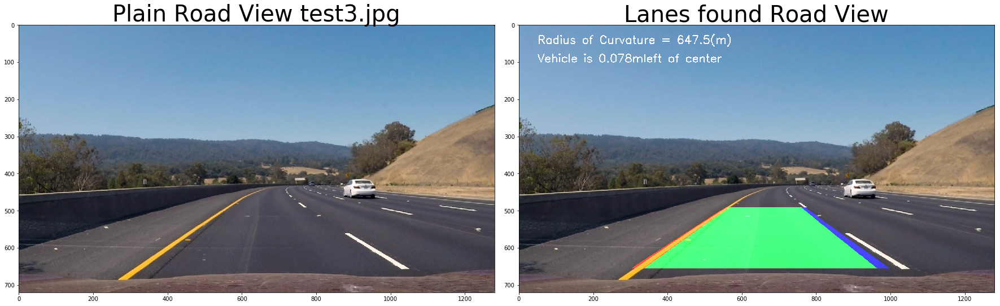

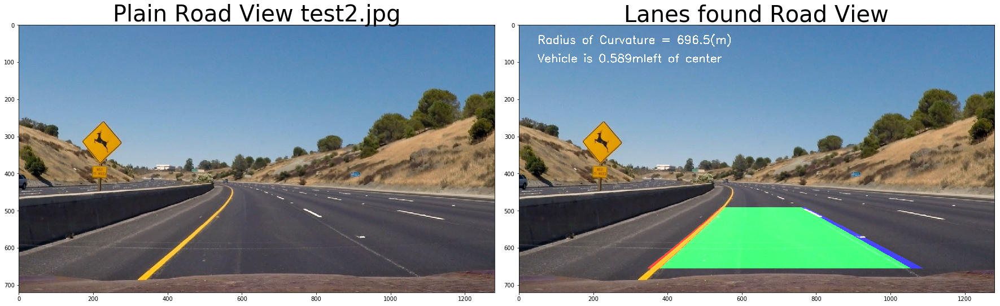

In [216]:
%time calling_pipeline('data/road_test_images/test*.jpg')

## Step 9: Pipeline Video

Here the 'rubber meets the road' so to speak. We will now process a video of moving lane lines thru our pipeline processing each frame image by image as we did in Project 1. This will demostrate our image processing pipeline above is able to find the lane lines in images successfully in a video.

Below you will see the output of a new video where the lanes are identified in every frame, and outputs are generated regarding the radius of curvature of the lane and vehicle position within the lane.

In [52]:
#Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

#Pull in the distortion coefficients from our pickle file

# Get distortion coefficients from our pickle file
dist_pickle = pickle.load(open("data/camera_cal/calibration_pickle.p", 'rb'))
mtx = dist_pickle['mtx']
dist = dist_pickle['dist']

In [217]:
#Running 'Easy' video thru Pipeline

video1_output = 'data/videos/output_video_easy_with_correction3.mp4'

clip1 = VideoFileClip("data/videos/project_video.mp4")
#vid_clip = clip1.fl_image(process_image); #NOTE: this function expects color images!!
vid_clip = clip1.fl_image(pipeline); #NOTE: this function expects color images!!
%time vid_clip.write_videofile(video1_output, audio=False)

I corrected right_fit in fit_polymonial b/c leftx had : 20709 and rightx had : 11058
[MoviePy] >>>> Building video data/videos/output_video_easy_with_correction3.mp4
[MoviePy] Writing video data/videos/output_video_easy_with_correction3.mp4




  0%|          | 0/1261 [00:00<?, ?it/s]

  0%|          | 1/1261 [00:00<06:37,  3.17it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20709 and rightx had : 11058




  0%|          | 2/1261 [00:00<06:57,  3.02it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20425 and rightx had : 10317




  0%|          | 3/1261 [00:01<07:05,  2.96it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20098 and rightx had : 9403




  0%|          | 4/1261 [00:01<07:15,  2.89it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19428 and rightx had : 9434




  0%|          | 5/1261 [00:01<07:14,  2.89it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19715 and rightx had : 9645




  0%|          | 6/1261 [00:02<07:25,  2.82it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19593 and rightx had : 10303




  1%|          | 7/1261 [00:02<07:37,  2.74it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19633 and rightx had : 10523




  1%|          | 8/1261 [00:02<07:46,  2.69it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19761 and rightx had : 11444




  1%|          | 9/1261 [00:03<07:56,  2.63it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19764 and rightx had : 11309




  1%|          | 10/1261 [00:03<08:16,  2.52it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19905 and rightx had : 10641




  1%|          | 11/1261 [00:04<08:42,  2.39it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19736 and rightx had : 9951




  1%|          | 12/1261 [00:05<09:04,  2.29it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19998 and rightx had : 9912




  1%|          | 13/1261 [00:05<09:15,  2.25it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20368 and rightx had : 10278




  1%|          | 14/1261 [00:06<09:20,  2.23it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20267 and rightx had : 10066




  1%|          | 15/1261 [00:06<09:23,  2.21it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20044 and rightx had : 9061




  1%|▏         | 16/1261 [00:07<09:31,  2.18it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19908 and rightx had : 8937




  1%|▏         | 17/1261 [00:07<09:32,  2.17it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19367 and rightx had : 9235




  1%|▏         | 18/1261 [00:08<09:33,  2.17it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19051 and rightx had : 9906




  2%|▏         | 19/1261 [00:08<09:37,  2.15it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19432 and rightx had : 10088




  2%|▏         | 20/1261 [00:09<09:41,  2.14it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19531 and rightx had : 10523




  2%|▏         | 21/1261 [00:09<09:41,  2.13it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19992 and rightx had : 11457




  2%|▏         | 22/1261 [00:10<09:44,  2.12it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20372 and rightx had : 11170




  2%|▏         | 23/1261 [00:10<09:45,  2.12it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20535 and rightx had : 10824




  2%|▏         | 24/1261 [00:11<09:52,  2.09it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20231 and rightx had : 10045




  2%|▏         | 25/1261 [00:12<09:54,  2.08it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20267 and rightx had : 9384




  2%|▏         | 26/1261 [00:12<09:55,  2.07it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20919 and rightx had : 10208




  2%|▏         | 27/1261 [00:13<09:55,  2.07it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21012 and rightx had : 9796




  2%|▏         | 28/1261 [00:13<09:55,  2.07it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20927 and rightx had : 9388




  2%|▏         | 29/1261 [00:14<09:55,  2.07it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20513 and rightx had : 8295




  2%|▏         | 30/1261 [00:14<09:54,  2.07it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20300 and rightx had : 7836




  2%|▏         | 31/1261 [00:14<09:53,  2.07it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20172 and rightx had : 8707




  3%|▎         | 32/1261 [00:15<09:53,  2.07it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19813 and rightx had : 9573




  3%|▎         | 33/1261 [00:15<09:52,  2.07it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20088 and rightx had : 10713




  3%|▎         | 34/1261 [00:16<09:51,  2.08it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20222 and rightx had : 10996




  3%|▎         | 35/1261 [00:16<09:50,  2.08it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19968 and rightx had : 10288




  3%|▎         | 36/1261 [00:17<09:49,  2.08it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19834 and rightx had : 9440




  3%|▎         | 37/1261 [00:17<09:48,  2.08it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19703 and rightx had : 9583




  3%|▎         | 38/1261 [00:18<09:47,  2.08it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20139 and rightx had : 9829




  3%|▎         | 39/1261 [00:18<09:46,  2.08it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19846 and rightx had : 9139




  3%|▎         | 40/1261 [00:19<09:46,  2.08it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19797 and rightx had : 8467




  3%|▎         | 41/1261 [00:19<09:45,  2.08it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19725 and rightx had : 8327




  3%|▎         | 42/1261 [00:20<09:44,  2.09it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19164 and rightx had : 8850




  3%|▎         | 43/1261 [00:20<09:46,  2.08it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19167 and rightx had : 9059




  3%|▎         | 44/1261 [00:21<09:47,  2.07it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19217 and rightx had : 9389




  4%|▎         | 45/1261 [00:21<09:47,  2.07it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19080 and rightx had : 9783




  4%|▎         | 46/1261 [00:22<09:46,  2.07it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19523 and rightx had : 11345




  4%|▎         | 47/1261 [00:22<09:47,  2.07it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19592 and rightx had : 11193




  4%|▍         | 48/1261 [00:23<09:48,  2.06it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19468 and rightx had : 10510




  4%|▍         | 49/1261 [00:23<09:49,  2.06it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19709 and rightx had : 9975




  4%|▍         | 50/1261 [00:24<09:49,  2.06it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19465 and rightx had : 9327




  4%|▍         | 51/1261 [00:24<09:49,  2.05it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19524 and rightx had : 10284




  4%|▍         | 52/1261 [00:25<09:50,  2.05it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19338 and rightx had : 9610




  4%|▍         | 53/1261 [00:25<09:51,  2.04it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19338 and rightx had : 8698




  4%|▍         | 54/1261 [00:26<09:51,  2.04it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19267 and rightx had : 8768




  4%|▍         | 55/1261 [00:26<09:51,  2.04it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19066 and rightx had : 8644




  4%|▍         | 56/1261 [00:27<09:52,  2.03it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19228 and rightx had : 9182




  5%|▍         | 57/1261 [00:28<09:52,  2.03it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19267 and rightx had : 10056




  5%|▍         | 58/1261 [00:28<09:52,  2.03it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19387 and rightx had : 10955




  5%|▍         | 59/1261 [00:29<09:53,  2.03it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19444 and rightx had : 11082




  5%|▍         | 60/1261 [00:29<09:54,  2.02it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19509 and rightx had : 10135




  5%|▍         | 61/1261 [00:30<09:54,  2.02it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19386 and rightx had : 9377




  5%|▍         | 62/1261 [00:30<09:54,  2.02it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19413 and rightx had : 9367




  5%|▍         | 63/1261 [00:31<09:54,  2.02it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19798 and rightx had : 9705




  5%|▌         | 64/1261 [00:31<09:54,  2.01it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20115 and rightx had : 8958




  5%|▌         | 65/1261 [00:32<09:55,  2.01it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19973 and rightx had : 8652




  5%|▌         | 66/1261 [00:32<09:55,  2.01it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19922 and rightx had : 8784




  5%|▌         | 67/1261 [00:33<09:55,  2.01it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19451 and rightx had : 8909




  5%|▌         | 68/1261 [00:33<09:55,  2.00it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19615 and rightx had : 9186




  5%|▌         | 69/1261 [00:34<09:56,  2.00it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19629 and rightx had : 9902




  6%|▌         | 70/1261 [00:35<09:56,  2.00it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19580 and rightx had : 9975




  6%|▌         | 71/1261 [00:35<09:56,  2.00it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19541 and rightx had : 10617




  6%|▌         | 72/1261 [00:36<09:57,  1.99it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19399 and rightx had : 10064




  6%|▌         | 73/1261 [00:36<09:57,  1.99it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19156 and rightx had : 9497




  6%|▌         | 74/1261 [00:37<09:57,  1.99it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18969 and rightx had : 8949




  6%|▌         | 75/1261 [00:37<09:57,  1.98it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19451 and rightx had : 9035




  6%|▌         | 76/1261 [00:38<09:58,  1.98it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19214 and rightx had : 9172




  6%|▌         | 77/1261 [00:38<09:58,  1.98it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19558 and rightx had : 9100




  6%|▌         | 78/1261 [00:39<09:59,  1.97it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19553 and rightx had : 8600




  6%|▋         | 79/1261 [00:40<10:00,  1.97it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19705 and rightx had : 8081




  6%|▋         | 80/1261 [00:40<10:01,  1.96it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19464 and rightx had : 6973




  6%|▋         | 81/1261 [00:41<10:01,  1.96it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19493 and rightx had : 7658




  7%|▋         | 82/1261 [00:41<10:01,  1.96it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19923 and rightx had : 8307




  7%|▋         | 83/1261 [00:42<10:01,  1.96it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20003 and rightx had : 9537




  7%|▋         | 84/1261 [00:43<10:02,  1.95it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20028 and rightx had : 10895




  7%|▋         | 85/1261 [00:43<10:03,  1.95it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20224 and rightx had : 11042




  7%|▋         | 86/1261 [00:44<10:02,  1.95it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20424 and rightx had : 10432




  7%|▋         | 87/1261 [00:44<10:02,  1.95it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20359 and rightx had : 9334




  7%|▋         | 88/1261 [00:45<10:03,  1.94it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20158 and rightx had : 9190




  7%|▋         | 89/1261 [00:45<10:02,  1.94it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19846 and rightx had : 9088




  7%|▋         | 90/1261 [00:46<10:04,  1.94it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19969 and rightx had : 8421




  7%|▋         | 91/1261 [00:47<10:05,  1.93it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19826 and rightx had : 8275




  7%|▋         | 92/1261 [00:47<10:05,  1.93it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19478 and rightx had : 8455




  7%|▋         | 93/1261 [00:48<10:05,  1.93it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19442 and rightx had : 9295




  7%|▋         | 94/1261 [00:48<10:05,  1.93it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19482 and rightx had : 9852




  8%|▊         | 95/1261 [00:49<10:05,  1.93it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19558 and rightx had : 9894




  8%|▊         | 96/1261 [00:49<10:06,  1.92it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19886 and rightx had : 10676




  8%|▊         | 97/1261 [00:50<10:08,  1.91it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19934 and rightx had : 10314




  8%|▊         | 98/1261 [00:51<10:08,  1.91it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19676 and rightx had : 9921




  8%|▊         | 99/1261 [00:51<10:08,  1.91it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19628 and rightx had : 9238




  8%|▊         | 100/1261 [00:52<10:10,  1.90it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19957 and rightx had : 9046




  8%|▊         | 101/1261 [00:53<10:12,  1.89it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19934 and rightx had : 9829




  8%|▊         | 102/1261 [00:54<10:14,  1.89it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19746 and rightx had : 9110




  8%|▊         | 103/1261 [00:54<10:16,  1.88it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19963 and rightx had : 8662




  8%|▊         | 104/1261 [00:55<10:18,  1.87it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20020 and rightx had : 8430




  8%|▊         | 105/1261 [00:56<10:19,  1.87it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19620 and rightx had : 7809




  8%|▊         | 106/1261 [00:56<10:18,  1.87it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19770 and rightx had : 8182




  8%|▊         | 107/1261 [00:57<10:18,  1.87it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19889 and rightx had : 8581




  9%|▊         | 108/1261 [00:57<10:18,  1.86it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19765 and rightx had : 9732




  9%|▊         | 109/1261 [00:58<10:18,  1.86it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20085 and rightx had : 11300




  9%|▊         | 110/1261 [00:59<10:18,  1.86it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19964 and rightx had : 10795




  9%|▉         | 111/1261 [00:59<10:18,  1.86it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19899 and rightx had : 10125




  9%|▉         | 112/1261 [01:00<10:18,  1.86it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20252 and rightx had : 9853




  9%|▉         | 113/1261 [01:00<10:18,  1.86it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20293 and rightx had : 9243




  9%|▉         | 114/1261 [01:01<10:17,  1.86it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20532 and rightx had : 10069




  9%|▉         | 115/1261 [01:01<10:17,  1.86it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20577 and rightx had : 9265




  9%|▉         | 116/1261 [01:02<10:17,  1.85it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20308 and rightx had : 8584




  9%|▉         | 117/1261 [01:03<10:17,  1.85it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20045 and rightx had : 8186




  9%|▉         | 118/1261 [01:03<10:17,  1.85it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20121 and rightx had : 8177




  9%|▉         | 119/1261 [01:04<10:16,  1.85it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19988 and rightx had : 8927




 10%|▉         | 120/1261 [01:04<10:16,  1.85it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19807 and rightx had : 9591




 10%|▉         | 121/1261 [01:05<10:16,  1.85it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19826 and rightx had : 10454




 10%|▉         | 122/1261 [01:05<10:15,  1.85it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19680 and rightx had : 10791




 10%|▉         | 123/1261 [01:06<10:15,  1.85it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19819 and rightx had : 9862




 10%|▉         | 124/1261 [01:07<10:15,  1.85it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19471 and rightx had : 9332




 10%|▉         | 125/1261 [01:07<10:14,  1.85it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19855 and rightx had : 9462




 10%|▉         | 126/1261 [01:08<10:14,  1.85it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19343 and rightx had : 9471




 10%|█         | 127/1261 [01:08<10:14,  1.85it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19172 and rightx had : 9028




 10%|█         | 128/1261 [01:09<10:14,  1.84it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19278 and rightx had : 8350




 10%|█         | 129/1261 [01:10<10:14,  1.84it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19185 and rightx had : 8471




 10%|█         | 130/1261 [01:10<10:14,  1.84it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18849 and rightx had : 8962




 10%|█         | 131/1261 [01:11<10:14,  1.84it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18693 and rightx had : 9619




 10%|█         | 132/1261 [01:11<10:14,  1.84it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18500 and rightx had : 10095




 11%|█         | 133/1261 [01:12<10:14,  1.84it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18533 and rightx had : 10050




 11%|█         | 134/1261 [01:12<10:13,  1.84it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18374 and rightx had : 10033




 11%|█         | 135/1261 [01:13<10:13,  1.84it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18130 and rightx had : 9775




 11%|█         | 136/1261 [01:14<10:13,  1.83it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 17977 and rightx had : 9373




 11%|█         | 137/1261 [01:14<10:13,  1.83it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18086 and rightx had : 9060




 11%|█         | 138/1261 [01:15<10:13,  1.83it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18462 and rightx had : 9002




 11%|█         | 139/1261 [01:15<10:12,  1.83it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18303 and rightx had : 9727




 11%|█         | 140/1261 [01:16<10:12,  1.83it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18583 and rightx had : 9173




 11%|█         | 141/1261 [01:17<10:12,  1.83it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18672 and rightx had : 8498




 11%|█▏        | 142/1261 [01:17<10:11,  1.83it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18921 and rightx had : 8099




 11%|█▏        | 143/1261 [01:18<10:11,  1.83it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18818 and rightx had : 8183




 11%|█▏        | 144/1261 [01:18<10:11,  1.83it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18794 and rightx had : 8900




 11%|█▏        | 145/1261 [01:19<10:11,  1.83it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18879 and rightx had : 9367




 12%|█▏        | 146/1261 [01:20<10:10,  1.82it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18631 and rightx had : 10357




 12%|█▏        | 147/1261 [01:20<10:10,  1.82it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18756 and rightx had : 10699




 12%|█▏        | 148/1261 [01:21<10:10,  1.82it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18527 and rightx had : 9723




 12%|█▏        | 149/1261 [01:21<10:09,  1.82it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18593 and rightx had : 9248




 12%|█▏        | 150/1261 [01:22<10:09,  1.82it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18602 and rightx had : 9277




 12%|█▏        | 151/1261 [01:22<10:08,  1.82it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18812 and rightx had : 9441




 12%|█▏        | 152/1261 [01:23<10:08,  1.82it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18919 and rightx had : 9047




 12%|█▏        | 153/1261 [01:23<10:08,  1.82it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18802 and rightx had : 8135




 12%|█▏        | 154/1261 [01:24<10:07,  1.82it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18843 and rightx had : 7965




 12%|█▏        | 155/1261 [01:25<10:07,  1.82it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18856 and rightx had : 8242




 12%|█▏        | 156/1261 [01:25<10:07,  1.82it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18893 and rightx had : 8895




 12%|█▏        | 157/1261 [01:26<10:07,  1.82it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19105 and rightx had : 9402




 13%|█▎        | 158/1261 [01:26<10:06,  1.82it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19066 and rightx had : 10126




 13%|█▎        | 159/1261 [01:27<10:06,  1.82it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19196 and rightx had : 10593




 13%|█▎        | 160/1261 [01:28<10:06,  1.82it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19370 and rightx had : 9801




 13%|█▎        | 161/1261 [01:28<10:05,  1.82it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19381 and rightx had : 9729




 13%|█▎        | 162/1261 [01:29<10:05,  1.82it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19412 and rightx had : 9318




 13%|█▎        | 163/1261 [01:29<10:04,  1.82it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19512 and rightx had : 9382




 13%|█▎        | 164/1261 [01:30<10:04,  1.81it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19513 and rightx had : 9545




 13%|█▎        | 165/1261 [01:30<10:04,  1.81it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19285 and rightx had : 8509




 13%|█▎        | 166/1261 [01:31<10:03,  1.81it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19645 and rightx had : 8193




 13%|█▎        | 167/1261 [01:32<10:03,  1.81it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19281 and rightx had : 8950




 13%|█▎        | 168/1261 [01:32<10:02,  1.81it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19439 and rightx had : 8889




 13%|█▎        | 169/1261 [01:33<10:02,  1.81it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19481 and rightx had : 9194




 13%|█▎        | 170/1261 [01:33<10:02,  1.81it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19573 and rightx had : 9492




 14%|█▎        | 171/1261 [01:34<10:01,  1.81it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19829 and rightx had : 10358




 14%|█▎        | 172/1261 [01:34<10:01,  1.81it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19681 and rightx had : 10778




 14%|█▎        | 173/1261 [01:35<10:00,  1.81it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19706 and rightx had : 10162




 14%|█▍        | 174/1261 [01:36<10:00,  1.81it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19551 and rightx had : 9178




 14%|█▍        | 175/1261 [01:36<10:00,  1.81it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19517 and rightx had : 8849




 14%|█▍        | 176/1261 [01:37<10:01,  1.80it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19583 and rightx had : 8926




 14%|█▍        | 177/1261 [01:38<10:01,  1.80it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19578 and rightx had : 8894




 14%|█▍        | 178/1261 [01:38<10:01,  1.80it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19675 and rightx had : 8373




 14%|█▍        | 179/1261 [01:39<10:00,  1.80it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19582 and rightx had : 8133




 14%|█▍        | 180/1261 [01:40<10:01,  1.80it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19658 and rightx had : 7977




 14%|█▍        | 181/1261 [01:40<10:00,  1.80it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19564 and rightx had : 8900




 14%|█▍        | 182/1261 [01:41<10:00,  1.80it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19680 and rightx had : 9233




 15%|█▍        | 183/1261 [01:41<10:00,  1.80it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19693 and rightx had : 10114




 15%|█▍        | 184/1261 [01:42<09:59,  1.80it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19675 and rightx had : 10192




 15%|█▍        | 185/1261 [01:43<09:59,  1.80it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19325 and rightx had : 9662




 15%|█▍        | 186/1261 [01:43<09:58,  1.79it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19251 and rightx had : 9016




 15%|█▍        | 187/1261 [01:44<09:58,  1.79it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19202 and rightx had : 9277




 15%|█▍        | 188/1261 [01:44<09:58,  1.79it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19041 and rightx had : 8818




 15%|█▍        | 189/1261 [01:45<09:57,  1.79it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19106 and rightx had : 8305




 15%|█▌        | 190/1261 [01:45<09:57,  1.79it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19100 and rightx had : 8361




 15%|█▌        | 191/1261 [01:46<09:56,  1.79it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18630 and rightx had : 9660




 15%|█▌        | 192/1261 [01:47<09:56,  1.79it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18664 and rightx had : 10247




 15%|█▌        | 193/1261 [01:47<09:55,  1.79it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18526 and rightx had : 10739




 15%|█▌        | 194/1261 [01:48<09:55,  1.79it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18389 and rightx had : 10654




 15%|█▌        | 195/1261 [01:48<09:54,  1.79it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18469 and rightx had : 9805




 16%|█▌        | 196/1261 [01:49<09:54,  1.79it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18567 and rightx had : 10090




 16%|█▌        | 197/1261 [01:50<09:54,  1.79it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18845 and rightx had : 10275




 16%|█▌        | 198/1261 [01:50<09:53,  1.79it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19197 and rightx had : 10142




 16%|█▌        | 199/1261 [01:51<09:53,  1.79it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19543 and rightx had : 10052




 16%|█▌        | 200/1261 [01:51<09:52,  1.79it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19602 and rightx had : 9123




 16%|█▌        | 201/1261 [01:52<09:52,  1.79it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19738 and rightx had : 9691




 16%|█▌        | 202/1261 [01:52<09:52,  1.79it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19773 and rightx had : 9357




 16%|█▌        | 203/1261 [01:53<09:52,  1.79it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19657 and rightx had : 8348




 16%|█▌        | 204/1261 [01:54<09:52,  1.79it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19651 and rightx had : 7404




 16%|█▋        | 205/1261 [01:54<09:52,  1.78it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19685 and rightx had : 7600




 16%|█▋        | 206/1261 [01:56<09:54,  1.78it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19405 and rightx had : 8439




 16%|█▋        | 207/1261 [01:56<09:54,  1.77it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19140 and rightx had : 9567




 16%|█▋        | 208/1261 [01:57<09:54,  1.77it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19106 and rightx had : 10335




 17%|█▋        | 209/1261 [01:58<09:54,  1.77it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19162 and rightx had : 10074




 17%|█▋        | 210/1261 [01:58<09:54,  1.77it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19301 and rightx had : 9903




 17%|█▋        | 211/1261 [01:59<09:55,  1.76it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19543 and rightx had : 9744




 17%|█▋        | 212/1261 [02:00<09:55,  1.76it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19338 and rightx had : 9022




 17%|█▋        | 213/1261 [02:01<09:55,  1.76it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19455 and rightx had : 9481




 17%|█▋        | 214/1261 [02:01<09:56,  1.75it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19418 and rightx had : 9185




 17%|█▋        | 215/1261 [02:02<09:56,  1.75it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19429 and rightx had : 8446




 17%|█▋        | 216/1261 [02:03<09:56,  1.75it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19129 and rightx had : 8305




 17%|█▋        | 217/1261 [02:03<09:55,  1.75it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19007 and rightx had : 8270




 17%|█▋        | 218/1261 [02:04<09:55,  1.75it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19125 and rightx had : 8589




 17%|█▋        | 219/1261 [02:05<09:54,  1.75it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18896 and rightx had : 9788




 17%|█▋        | 220/1261 [02:05<09:54,  1.75it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19389 and rightx had : 10317




 18%|█▊        | 221/1261 [02:06<09:54,  1.75it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19128 and rightx had : 10727




 18%|█▊        | 222/1261 [02:06<09:53,  1.75it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19341 and rightx had : 10226




 18%|█▊        | 223/1261 [02:07<09:53,  1.75it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19369 and rightx had : 9691




 18%|█▊        | 224/1261 [02:07<09:52,  1.75it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19256 and rightx had : 9337




 18%|█▊        | 225/1261 [02:08<09:52,  1.75it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19255 and rightx had : 9559




 18%|█▊        | 226/1261 [02:09<09:51,  1.75it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19266 and rightx had : 9008




 18%|█▊        | 227/1261 [02:09<09:51,  1.75it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19242 and rightx had : 8524




 18%|█▊        | 228/1261 [02:10<09:52,  1.74it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19169 and rightx had : 7985




 18%|█▊        | 229/1261 [02:11<09:53,  1.74it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19224 and rightx had : 8025




 18%|█▊        | 230/1261 [02:12<09:54,  1.73it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19296 and rightx had : 8101




 18%|█▊        | 231/1261 [02:13<09:56,  1.73it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19364 and rightx had : 8979




 18%|█▊        | 232/1261 [02:14<09:56,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19534 and rightx had : 9527




 18%|█▊        | 233/1261 [02:15<09:56,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19391 and rightx had : 10716




 19%|█▊        | 234/1261 [02:15<09:56,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19493 and rightx had : 10176




 19%|█▊        | 235/1261 [02:16<09:55,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19576 and rightx had : 9566




 19%|█▊        | 236/1261 [02:16<09:55,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19396 and rightx had : 8969




 19%|█▉        | 237/1261 [02:17<09:54,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19436 and rightx had : 9253




 19%|█▉        | 238/1261 [02:18<09:54,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19506 and rightx had : 8760




 19%|█▉        | 239/1261 [02:18<09:53,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19227 and rightx had : 8048




 19%|█▉        | 240/1261 [02:19<09:53,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19083 and rightx had : 7715




 19%|█▉        | 241/1261 [02:19<09:52,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19134 and rightx had : 7983




 19%|█▉        | 242/1261 [02:20<09:51,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19588 and rightx had : 8231




 19%|█▉        | 243/1261 [02:21<09:51,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19264 and rightx had : 9233




 19%|█▉        | 244/1261 [02:21<09:50,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19374 and rightx had : 9453




 19%|█▉        | 245/1261 [02:22<09:49,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19320 and rightx had : 10108




 20%|█▉        | 246/1261 [02:22<09:49,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19452 and rightx had : 9337




 20%|█▉        | 247/1261 [02:23<09:49,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19565 and rightx had : 8930




 20%|█▉        | 248/1261 [02:24<09:48,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19566 and rightx had : 9077




 20%|█▉        | 249/1261 [02:24<09:48,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19753 and rightx had : 9197




 20%|█▉        | 250/1261 [02:25<09:47,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19700 and rightx had : 8707




 20%|█▉        | 251/1261 [02:25<09:47,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19773 and rightx had : 8184




 20%|█▉        | 252/1261 [02:26<09:46,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19750 and rightx had : 7990




 20%|██        | 253/1261 [02:27<09:46,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19616 and rightx had : 8256




 20%|██        | 254/1261 [02:27<09:45,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19702 and rightx had : 8230




 20%|██        | 255/1261 [02:28<09:45,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19395 and rightx had : 8875




 20%|██        | 256/1261 [02:28<09:44,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19559 and rightx had : 9372




 20%|██        | 257/1261 [02:29<09:43,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19602 and rightx had : 10571




 20%|██        | 258/1261 [02:30<09:43,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19385 and rightx had : 10363




 21%|██        | 259/1261 [02:30<09:43,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19340 and rightx had : 9945




 21%|██        | 260/1261 [02:31<09:42,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19306 and rightx had : 9790




 21%|██        | 261/1261 [02:31<09:41,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19482 and rightx had : 9941




 21%|██        | 262/1261 [02:32<09:41,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19347 and rightx had : 9534




 21%|██        | 263/1261 [02:33<09:40,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19298 and rightx had : 9120




 21%|██        | 264/1261 [02:33<09:40,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19223 and rightx had : 8491




 21%|██        | 265/1261 [02:34<09:40,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19275 and rightx had : 8884




 21%|██        | 266/1261 [02:34<09:39,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19324 and rightx had : 9277




 21%|██        | 267/1261 [02:35<09:39,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19267 and rightx had : 10032




 21%|██▏       | 268/1261 [02:36<09:38,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19244 and rightx had : 10292




 21%|██▏       | 269/1261 [02:36<09:37,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19637 and rightx had : 10566




 21%|██▏       | 270/1261 [02:37<09:37,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19687 and rightx had : 10498




 21%|██▏       | 271/1261 [02:37<09:36,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19706 and rightx had : 9662




 22%|██▏       | 272/1261 [02:38<09:36,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19750 and rightx had : 9050




 22%|██▏       | 273/1261 [02:39<09:35,  1.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19424 and rightx had : 9107




 22%|██▏       | 274/1261 [02:39<09:35,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19586 and rightx had : 8710




 22%|██▏       | 275/1261 [02:40<09:35,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19760 and rightx had : 8529




 22%|██▏       | 276/1261 [02:41<09:34,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19690 and rightx had : 8202




 22%|██▏       | 277/1261 [02:41<09:34,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19732 and rightx had : 8736




 22%|██▏       | 278/1261 [02:42<09:33,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19661 and rightx had : 8957




 22%|██▏       | 279/1261 [02:42<09:33,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19425 and rightx had : 9751




 22%|██▏       | 280/1261 [02:43<09:32,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19661 and rightx had : 9972




 22%|██▏       | 281/1261 [02:44<09:32,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19571 and rightx had : 10312




 22%|██▏       | 282/1261 [02:44<09:31,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19436 and rightx had : 9591




 22%|██▏       | 283/1261 [02:45<09:31,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19323 and rightx had : 9046




 23%|██▎       | 284/1261 [02:45<09:30,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19353 and rightx had : 8736




 23%|██▎       | 285/1261 [02:46<09:30,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19294 and rightx had : 8800




 23%|██▎       | 286/1261 [02:47<09:29,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19464 and rightx had : 9226




 23%|██▎       | 287/1261 [02:47<09:29,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19461 and rightx had : 8662




 23%|██▎       | 288/1261 [02:48<09:28,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19537 and rightx had : 8176




 23%|██▎       | 289/1261 [02:48<09:27,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19053 and rightx had : 8310




 23%|██▎       | 290/1261 [02:49<09:27,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19163 and rightx had : 8712




 23%|██▎       | 291/1261 [02:50<09:27,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19068 and rightx had : 9498




 23%|██▎       | 292/1261 [02:50<09:26,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18876 and rightx had : 10005




 23%|██▎       | 293/1261 [02:51<09:26,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18953 and rightx had : 10458




 23%|██▎       | 294/1261 [02:51<09:25,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18903 and rightx had : 9676




 23%|██▎       | 295/1261 [02:52<09:25,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18999 and rightx had : 9357




 23%|██▎       | 296/1261 [02:53<09:24,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19153 and rightx had : 8857




 24%|██▎       | 297/1261 [02:53<09:24,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19371 and rightx had : 8989




 24%|██▎       | 298/1261 [02:54<09:23,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19176 and rightx had : 9116




 24%|██▎       | 299/1261 [02:55<09:23,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19237 and rightx had : 8622




 24%|██▍       | 300/1261 [02:55<09:22,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19582 and rightx had : 8252




 24%|██▍       | 301/1261 [02:56<09:22,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19186 and rightx had : 8211




 24%|██▍       | 302/1261 [02:56<09:21,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19333 and rightx had : 7981




 24%|██▍       | 303/1261 [02:57<09:21,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19575 and rightx had : 8607




 24%|██▍       | 304/1261 [02:58<09:20,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19764 and rightx had : 9390




 24%|██▍       | 305/1261 [02:58<09:20,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19778 and rightx had : 10286




 24%|██▍       | 306/1261 [02:59<09:19,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19528 and rightx had : 10143




 24%|██▍       | 307/1261 [03:00<09:19,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19761 and rightx had : 9796




 24%|██▍       | 308/1261 [03:00<09:18,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19746 and rightx had : 8898




 25%|██▍       | 309/1261 [03:01<09:18,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19746 and rightx had : 9085




 25%|██▍       | 310/1261 [03:01<09:17,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19763 and rightx had : 9120




 25%|██▍       | 311/1261 [03:02<09:17,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19761 and rightx had : 8298




 25%|██▍       | 312/1261 [03:02<09:16,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19893 and rightx had : 8148




 25%|██▍       | 313/1261 [03:03<09:15,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19493 and rightx had : 9329




 25%|██▍       | 314/1261 [03:04<09:15,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19632 and rightx had : 9326




 25%|██▍       | 315/1261 [03:04<09:14,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19314 and rightx had : 9878




 25%|██▌       | 316/1261 [03:05<09:14,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19360 and rightx had : 9742




 25%|██▌       | 317/1261 [03:05<09:13,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19439 and rightx had : 10085




 25%|██▌       | 318/1261 [03:06<09:12,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19153 and rightx had : 9263




 25%|██▌       | 319/1261 [03:07<09:12,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19298 and rightx had : 8984




 25%|██▌       | 320/1261 [03:07<09:11,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19035 and rightx had : 8677




 25%|██▌       | 321/1261 [03:08<09:11,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19251 and rightx had : 8839




 26%|██▌       | 322/1261 [03:08<09:10,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19333 and rightx had : 8523




 26%|██▌       | 323/1261 [03:09<09:09,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19558 and rightx had : 8359




 26%|██▌       | 324/1261 [03:09<09:09,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19554 and rightx had : 7958




 26%|██▌       | 325/1261 [03:10<09:09,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19529 and rightx had : 8295




 26%|██▌       | 326/1261 [03:11<09:09,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19738 and rightx had : 8365




 26%|██▌       | 327/1261 [03:12<09:08,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19817 and rightx had : 8661




 26%|██▌       | 328/1261 [03:12<09:08,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20105 and rightx had : 9003




 26%|██▌       | 329/1261 [03:13<09:07,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20287 and rightx had : 9908




 26%|██▌       | 330/1261 [03:14<09:07,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20239 and rightx had : 9899




 26%|██▌       | 331/1261 [03:14<09:06,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19866 and rightx had : 9116




 26%|██▋       | 332/1261 [03:15<09:06,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19580 and rightx had : 8467




 26%|██▋       | 333/1261 [03:15<09:05,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19734 and rightx had : 8594




 26%|██▋       | 334/1261 [03:16<09:04,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19900 and rightx had : 8492




 27%|██▋       | 335/1261 [03:16<09:04,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19752 and rightx had : 8011




 27%|██▋       | 336/1261 [03:17<09:03,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19956 and rightx had : 7911




 27%|██▋       | 337/1261 [03:17<09:02,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19761 and rightx had : 8270




 27%|██▋       | 338/1261 [03:18<09:02,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19817 and rightx had : 8353




 27%|██▋       | 339/1261 [03:19<09:01,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19837 and rightx had : 8947




 27%|██▋       | 340/1261 [03:19<09:00,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19751 and rightx had : 9411




 27%|██▋       | 341/1261 [03:20<09:00,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19629 and rightx had : 9742




 27%|██▋       | 342/1261 [03:20<08:59,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19442 and rightx had : 9042




 27%|██▋       | 343/1261 [03:21<08:59,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19410 and rightx had : 8728




 27%|██▋       | 344/1261 [03:21<08:58,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19671 and rightx had : 8551




 27%|██▋       | 345/1261 [03:22<08:57,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19648 and rightx had : 8722




 27%|██▋       | 346/1261 [03:23<08:57,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19639 and rightx had : 8949




 28%|██▊       | 347/1261 [03:23<08:56,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19675 and rightx had : 8226




 28%|██▊       | 348/1261 [03:24<08:55,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19679 and rightx had : 8132




 28%|██▊       | 349/1261 [03:24<08:55,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19326 and rightx had : 8319




 28%|██▊       | 350/1261 [03:25<08:54,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19637 and rightx had : 8459




 28%|██▊       | 351/1261 [03:25<08:53,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19588 and rightx had : 9208




 28%|██▊       | 352/1261 [03:26<08:53,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19793 and rightx had : 9840




 28%|██▊       | 353/1261 [03:27<08:52,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19839 and rightx had : 10498




 28%|██▊       | 354/1261 [03:27<08:51,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19713 and rightx had : 10509




 28%|██▊       | 355/1261 [03:28<08:51,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19682 and rightx had : 10137




 28%|██▊       | 356/1261 [03:28<08:50,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19569 and rightx had : 9565




 28%|██▊       | 357/1261 [03:29<08:49,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19372 and rightx had : 9128




 28%|██▊       | 358/1261 [03:29<08:49,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19559 and rightx had : 9857




 28%|██▊       | 359/1261 [03:30<08:48,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19453 and rightx had : 8987




 29%|██▊       | 360/1261 [03:30<08:47,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19626 and rightx had : 8601




 29%|██▊       | 361/1261 [03:31<08:47,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19385 and rightx had : 8693




 29%|██▊       | 362/1261 [03:32<08:46,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19291 and rightx had : 9038




 29%|██▉       | 363/1261 [03:32<08:46,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19285 and rightx had : 9535




 29%|██▉       | 364/1261 [03:33<08:45,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19415 and rightx had : 10120




 29%|██▉       | 365/1261 [03:33<08:44,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19258 and rightx had : 10524




 29%|██▉       | 366/1261 [03:34<08:44,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19243 and rightx had : 10085




 29%|██▉       | 367/1261 [03:35<08:43,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19460 and rightx had : 9605




 29%|██▉       | 368/1261 [03:35<08:43,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19450 and rightx had : 9517




 29%|██▉       | 369/1261 [03:36<08:42,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19601 and rightx had : 9552




 29%|██▉       | 370/1261 [03:36<08:41,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19692 and rightx had : 9349




 29%|██▉       | 371/1261 [03:37<08:41,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19666 and rightx had : 8907




 30%|██▉       | 372/1261 [03:37<08:40,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19931 and rightx had : 8558




 30%|██▉       | 373/1261 [03:38<08:39,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19687 and rightx had : 8714




 30%|██▉       | 374/1261 [03:38<08:39,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19846 and rightx had : 9046




 30%|██▉       | 375/1261 [03:39<08:38,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19805 and rightx had : 9268




 30%|██▉       | 376/1261 [03:40<08:38,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19622 and rightx had : 9861




 30%|██▉       | 377/1261 [03:40<08:37,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19693 and rightx had : 9741




 30%|██▉       | 378/1261 [03:41<08:37,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19524 and rightx had : 9295




 30%|███       | 379/1261 [03:41<08:36,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19462 and rightx had : 9190




 30%|███       | 380/1261 [03:42<08:35,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19373 and rightx had : 9048




 30%|███       | 381/1261 [03:43<08:35,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19746 and rightx had : 9249




 30%|███       | 382/1261 [03:43<08:34,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19445 and rightx had : 9035




 30%|███       | 383/1261 [03:44<08:33,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19352 and rightx had : 8627




 30%|███       | 384/1261 [03:44<08:33,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19420 and rightx had : 8019




 31%|███       | 385/1261 [03:45<08:33,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19262 and rightx had : 8751




 31%|███       | 386/1261 [03:46<08:32,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19306 and rightx had : 8951




 31%|███       | 387/1261 [03:46<08:32,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19350 and rightx had : 9061




 31%|███       | 388/1261 [03:47<08:31,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19336 and rightx had : 9723




 31%|███       | 389/1261 [03:47<08:30,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19319 and rightx had : 10288




 31%|███       | 390/1261 [03:48<08:30,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19481 and rightx had : 10822




 31%|███       | 391/1261 [03:49<08:29,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19455 and rightx had : 10164




 31%|███       | 392/1261 [03:49<08:29,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19818 and rightx had : 9597




 31%|███       | 393/1261 [03:50<08:28,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19624 and rightx had : 8996




 31%|███       | 394/1261 [03:50<08:27,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20032 and rightx had : 9866




 31%|███▏      | 395/1261 [03:51<08:27,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20144 and rightx had : 9232




 31%|███▏      | 396/1261 [03:51<08:26,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20285 and rightx had : 8603




 31%|███▏      | 397/1261 [03:52<08:25,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20309 and rightx had : 8426




 32%|███▏      | 398/1261 [03:53<08:25,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20173 and rightx had : 8399




 32%|███▏      | 399/1261 [03:53<08:24,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20462 and rightx had : 9004




 32%|███▏      | 400/1261 [03:54<08:24,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20230 and rightx had : 9584




 32%|███▏      | 401/1261 [03:54<08:23,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20243 and rightx had : 10474




 32%|███▏      | 402/1261 [03:55<08:23,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20266 and rightx had : 11225




 32%|███▏      | 403/1261 [03:56<08:22,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20143 and rightx had : 10369




 32%|███▏      | 404/1261 [03:56<08:22,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20097 and rightx had : 9879




 32%|███▏      | 405/1261 [03:57<08:21,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20265 and rightx had : 9286




 32%|███▏      | 406/1261 [03:58<08:21,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20247 and rightx had : 9999




 32%|███▏      | 407/1261 [03:58<08:20,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20381 and rightx had : 9721




 32%|███▏      | 408/1261 [03:59<08:20,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20372 and rightx had : 9024




 32%|███▏      | 409/1261 [03:59<08:19,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20220 and rightx had : 8516




 33%|███▎      | 410/1261 [04:00<08:19,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19757 and rightx had : 7909




 33%|███▎      | 411/1261 [04:01<08:18,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20022 and rightx had : 8406




 33%|███▎      | 412/1261 [04:01<08:17,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19924 and rightx had : 9211




 33%|███▎      | 413/1261 [04:02<08:17,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19745 and rightx had : 10245




 33%|███▎      | 414/1261 [04:02<08:16,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19560 and rightx had : 11075




 33%|███▎      | 415/1261 [04:03<08:16,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19537 and rightx had : 10137




 33%|███▎      | 416/1261 [04:03<08:15,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19437 and rightx had : 9812




 33%|███▎      | 417/1261 [04:04<08:14,  1.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19624 and rightx had : 8967




 33%|███▎      | 418/1261 [04:05<08:14,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20004 and rightx had : 9728




 33%|███▎      | 419/1261 [04:06<08:15,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19883 and rightx had : 9532




 33%|███▎      | 420/1261 [04:07<08:14,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19868 and rightx had : 8710




 33%|███▎      | 421/1261 [04:07<08:14,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19602 and rightx had : 8440




 33%|███▎      | 422/1261 [04:08<08:14,  1.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19564 and rightx had : 8349




 34%|███▎      | 423/1261 [04:09<08:14,  1.69it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19998 and rightx had : 8713




 34%|███▎      | 424/1261 [04:10<08:14,  1.69it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20167 and rightx had : 9241




 34%|███▎      | 425/1261 [04:11<08:14,  1.69it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20171 and rightx had : 10344




 34%|███▍      | 426/1261 [04:12<08:14,  1.69it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20242 and rightx had : 11174




 34%|███▍      | 427/1261 [04:13<08:15,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20223 and rightx had : 10357




 34%|███▍      | 428/1261 [04:14<08:15,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20487 and rightx had : 9746




 34%|███▍      | 429/1261 [04:15<08:15,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20494 and rightx had : 9026




 34%|███▍      | 430/1261 [04:16<08:15,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20613 and rightx had : 9690




 34%|███▍      | 431/1261 [04:16<08:14,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20687 and rightx had : 9452




 34%|███▍      | 432/1261 [04:17<08:13,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20877 and rightx had : 8674




 34%|███▍      | 433/1261 [04:17<08:13,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20797 and rightx had : 8271




 34%|███▍      | 434/1261 [04:18<08:12,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20599 and rightx had : 7721




 34%|███▍      | 435/1261 [04:19<08:12,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20831 and rightx had : 8050




 35%|███▍      | 436/1261 [04:19<08:11,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20762 and rightx had : 8723




 35%|███▍      | 437/1261 [04:20<08:11,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20659 and rightx had : 10076




 35%|███▍      | 438/1261 [04:21<08:11,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20677 and rightx had : 10514




 35%|███▍      | 439/1261 [04:22<08:10,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20560 and rightx had : 9400




 35%|███▍      | 440/1261 [04:22<08:10,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20363 and rightx had : 8685




 35%|███▍      | 441/1261 [04:23<08:10,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20474 and rightx had : 8682




 35%|███▌      | 442/1261 [04:24<08:09,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20656 and rightx had : 8947




 35%|███▌      | 443/1261 [04:24<08:09,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20894 and rightx had : 8850




 35%|███▌      | 444/1261 [04:25<08:08,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20938 and rightx had : 8117




 35%|███▌      | 445/1261 [04:26<08:08,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20569 and rightx had : 7507




 35%|███▌      | 446/1261 [04:26<08:07,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20839 and rightx had : 7381




 35%|███▌      | 447/1261 [04:27<08:06,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20803 and rightx had : 8427




 36%|███▌      | 448/1261 [04:27<08:06,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20864 and rightx had : 8805




 36%|███▌      | 449/1261 [04:28<08:05,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20629 and rightx had : 9954




 36%|███▌      | 450/1261 [04:29<08:04,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20833 and rightx had : 9795




 36%|███▌      | 451/1261 [04:29<08:04,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20832 and rightx had : 9373




 36%|███▌      | 452/1261 [04:30<08:03,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20973 and rightx had : 8809




 36%|███▌      | 453/1261 [04:30<08:02,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20996 and rightx had : 8621




 36%|███▌      | 454/1261 [04:31<08:02,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20988 and rightx had : 8794




 36%|███▌      | 455/1261 [04:31<08:01,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21150 and rightx had : 8523




 36%|███▌      | 456/1261 [04:32<08:01,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21150 and rightx had : 8008




 36%|███▌      | 457/1261 [04:33<08:00,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21063 and rightx had : 7847




 36%|███▋      | 458/1261 [04:33<07:59,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20861 and rightx had : 8037




 36%|███▋      | 459/1261 [04:34<07:59,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20681 and rightx had : 8855




 36%|███▋      | 460/1261 [04:34<07:58,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20975 and rightx had : 9044




 37%|███▋      | 461/1261 [04:35<07:58,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20830 and rightx had : 9896




 37%|███▋      | 462/1261 [04:36<07:57,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20872 and rightx had : 9831




 37%|███▋      | 463/1261 [04:36<07:57,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20983 and rightx had : 9535




 37%|███▋      | 464/1261 [04:37<07:56,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20787 and rightx had : 8686




 37%|███▋      | 465/1261 [04:37<07:55,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21042 and rightx had : 8768




 37%|███▋      | 466/1261 [04:38<07:55,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20957 and rightx had : 8679




 37%|███▋      | 467/1261 [04:39<07:54,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21070 and rightx had : 8341




 37%|███▋      | 468/1261 [04:39<07:53,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20883 and rightx had : 7776




 37%|███▋      | 469/1261 [04:40<07:53,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20643 and rightx had : 8173




 37%|███▋      | 470/1261 [04:40<07:52,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21040 and rightx had : 8029




 37%|███▋      | 471/1261 [04:41<07:52,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20797 and rightx had : 8642




 37%|███▋      | 472/1261 [04:42<07:51,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21026 and rightx had : 9061




 38%|███▊      | 473/1261 [04:42<07:50,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21008 and rightx had : 10268




 38%|███▊      | 474/1261 [04:43<07:50,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20643 and rightx had : 9582




 38%|███▊      | 475/1261 [04:43<07:49,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20982 and rightx had : 9479




 38%|███▊      | 476/1261 [04:44<07:49,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20932 and rightx had : 8807




 38%|███▊      | 477/1261 [04:44<07:48,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20694 and rightx had : 8485




 38%|███▊      | 478/1261 [04:45<07:47,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21010 and rightx had : 9204




 38%|███▊      | 479/1261 [04:46<07:47,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21292 and rightx had : 8874




 38%|███▊      | 480/1261 [04:46<07:46,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21347 and rightx had : 8358




 38%|███▊      | 481/1261 [04:47<07:45,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20834 and rightx had : 7183




 38%|███▊      | 482/1261 [04:47<07:45,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21077 and rightx had : 6580




 38%|███▊      | 483/1261 [04:48<07:44,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21498 and rightx had : 7327




 38%|███▊      | 484/1261 [04:49<07:44,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21349 and rightx had : 8342




 38%|███▊      | 485/1261 [04:49<07:43,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21465 and rightx had : 10262




 39%|███▊      | 486/1261 [04:50<07:42,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21333 and rightx had : 10614




 39%|███▊      | 487/1261 [04:50<07:42,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21612 and rightx had : 9785




 39%|███▊      | 488/1261 [04:51<07:41,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21373 and rightx had : 9007




 39%|███▉      | 489/1261 [04:51<07:40,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21274 and rightx had : 9084




 39%|███▉      | 490/1261 [04:52<07:40,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21741 and rightx had : 9292




 39%|███▉      | 491/1261 [04:53<07:39,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21537 and rightx had : 8488




 39%|███▉      | 492/1261 [04:53<07:38,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21752 and rightx had : 8257




 39%|███▉      | 493/1261 [04:54<07:38,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21345 and rightx had : 7785




 39%|███▉      | 494/1261 [04:54<07:37,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21485 and rightx had : 7675




 39%|███▉      | 495/1261 [04:55<07:36,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21510 and rightx had : 8147




 39%|███▉      | 496/1261 [04:55<07:36,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21578 and rightx had : 9113




 39%|███▉      | 497/1261 [04:56<07:35,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21415 and rightx had : 10665




 39%|███▉      | 498/1261 [04:57<07:35,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21078 and rightx had : 10045




 40%|███▉      | 499/1261 [04:57<07:34,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21256 and rightx had : 9629




 40%|███▉      | 500/1261 [04:58<07:34,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21336 and rightx had : 9390




 40%|███▉      | 501/1261 [04:59<07:33,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21312 and rightx had : 8831




 40%|███▉      | 502/1261 [04:59<07:33,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21567 and rightx had : 9450




 40%|███▉      | 503/1261 [05:00<07:32,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21412 and rightx had : 9057




 40%|███▉      | 504/1261 [05:00<07:32,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21411 and rightx had : 8486




 40%|████      | 505/1261 [05:01<07:31,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21219 and rightx had : 7186




 40%|████      | 506/1261 [05:02<07:30,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21140 and rightx had : 6685




 40%|████      | 507/1261 [05:02<07:30,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21193 and rightx had : 6817




 40%|████      | 508/1261 [05:03<07:29,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21210 and rightx had : 8108




 40%|████      | 509/1261 [05:03<07:28,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21395 and rightx had : 10185




 40%|████      | 510/1261 [05:04<07:28,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21671 and rightx had : 11613




 41%|████      | 511/1261 [05:04<07:27,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21543 and rightx had : 10618




 41%|████      | 512/1261 [05:05<07:26,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21340 and rightx had : 9900




 41%|████      | 513/1261 [05:06<07:26,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21336 and rightx had : 8903




 41%|████      | 514/1261 [05:06<07:25,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21525 and rightx had : 9683




 41%|████      | 515/1261 [05:07<07:24,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21649 and rightx had : 9208




 41%|████      | 516/1261 [05:07<07:24,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21560 and rightx had : 8613




 41%|████      | 517/1261 [05:08<07:23,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21599 and rightx had : 7498




 41%|████      | 518/1261 [05:08<07:23,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21550 and rightx had : 6675




 41%|████      | 519/1261 [05:09<07:22,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21610 and rightx had : 7115




 41%|████      | 520/1261 [05:10<07:22,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21812 and rightx had : 8351




 41%|████▏     | 521/1261 [05:10<07:21,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21751 and rightx had : 10392




 41%|████▏     | 522/1261 [05:11<07:20,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21608 and rightx had : 11699




 41%|████▏     | 523/1261 [05:11<07:20,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21466 and rightx had : 10699




 42%|████▏     | 524/1261 [05:12<07:19,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21467 and rightx had : 9783




 42%|████▏     | 525/1261 [05:13<07:18,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20788 and rightx had : 9058




 42%|████▏     | 526/1261 [05:13<07:18,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20144 and rightx had : 9749




 42%|████▏     | 527/1261 [05:14<07:17,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19502 and rightx had : 9580




 42%|████▏     | 528/1261 [05:14<07:17,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18816 and rightx had : 9119




 42%|████▏     | 529/1261 [05:15<07:16,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18282 and rightx had : 7689




 42%|████▏     | 530/1261 [05:16<07:15,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 17825 and rightx had : 7351




 42%|████▏     | 531/1261 [05:16<07:15,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 17232 and rightx had : 8006




 42%|████▏     | 532/1261 [05:17<07:14,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 16694 and rightx had : 9450




 42%|████▏     | 533/1261 [05:17<07:14,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 16780 and rightx had : 10885




 42%|████▏     | 534/1261 [05:18<07:13,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 17277 and rightx had : 11907




 42%|████▏     | 535/1261 [05:18<07:12,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 17447 and rightx had : 11972




 43%|████▎     | 536/1261 [05:19<07:12,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 17333 and rightx had : 11543




 43%|████▎     | 537/1261 [05:20<07:11,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 17786 and rightx had : 10623




 43%|████▎     | 538/1261 [05:20<07:10,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18145 and rightx had : 10047




 43%|████▎     | 539/1261 [05:21<07:10,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18077 and rightx had : 10392




 43%|████▎     | 540/1261 [05:21<07:09,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18152 and rightx had : 11923




 43%|████▎     | 541/1261 [05:22<07:09,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18295 and rightx had : 14695




 43%|████▎     | 542/1261 [05:23<07:08,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18152 and rightx had : 13930




 43%|████▎     | 543/1261 [05:23<07:08,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19108 and rightx had : 13224




 43%|████▎     | 544/1261 [05:24<07:07,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 22906 and rightx had : 11037




 43%|████▎     | 545/1261 [05:24<07:06,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 22270 and rightx had : 9516




 43%|████▎     | 546/1261 [05:25<07:06,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21977 and rightx had : 8599




 43%|████▎     | 547/1261 [05:26<07:05,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21787 and rightx had : 7848




 43%|████▎     | 548/1261 [05:26<07:05,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 22146 and rightx had : 7715




 44%|████▎     | 549/1261 [05:27<07:04,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 23448 and rightx had : 7558




 44%|████▎     | 550/1261 [05:27<07:03,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 22833 and rightx had : 8002




 44%|████▎     | 551/1261 [05:28<07:03,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 23955 and rightx had : 9336




 44%|████▍     | 552/1261 [05:29<07:02,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 23584 and rightx had : 8912




 44%|████▍     | 553/1261 [05:29<07:02,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 22848 and rightx had : 8324




 44%|████▍     | 554/1261 [05:30<07:01,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 22934 and rightx had : 6913




 44%|████▍     | 555/1261 [05:30<07:00,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 22511 and rightx had : 5835




 44%|████▍     | 556/1261 [05:31<07:00,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21662 and rightx had : 5518




 44%|████▍     | 557/1261 [05:32<06:59,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21379 and rightx had : 4913




 44%|████▍     | 558/1261 [05:32<06:59,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21721 and rightx had : 4679




 44%|████▍     | 559/1261 [05:33<06:58,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 22087 and rightx had : 5139




 44%|████▍     | 560/1261 [05:33<06:57,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 22449 and rightx had : 5593




 44%|████▍     | 561/1261 [05:34<06:57,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 22972 and rightx had : 5494




 45%|████▍     | 562/1261 [05:35<06:56,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 22261 and rightx had : 4264




 45%|████▍     | 563/1261 [05:35<06:56,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21081 and rightx had : 2620




 45%|████▍     | 564/1261 [05:36<06:55,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20133 and rightx had : 4793




 45%|████▍     | 565/1261 [05:36<06:54,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19231 and rightx had : 6943




 45%|████▍     | 566/1261 [05:37<06:54,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18059 and rightx had : 6633




 45%|████▍     | 567/1261 [05:37<06:53,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18558 and rightx had : 6324




 45%|████▌     | 568/1261 [05:38<06:53,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 17826 and rightx had : 6258




 45%|████▌     | 569/1261 [05:39<06:52,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 17817 and rightx had : 5825




 45%|████▌     | 570/1261 [05:39<06:51,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18339 and rightx had : 5867




 45%|████▌     | 571/1261 [05:40<06:51,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 17512 and rightx had : 5869




 45%|████▌     | 572/1261 [05:41<06:50,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 17050 and rightx had : 5534




 45%|████▌     | 573/1261 [05:41<06:50,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 17547 and rightx had : 4566




 46%|████▌     | 574/1261 [05:42<06:49,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 17560 and rightx had : 3620




 46%|████▌     | 575/1261 [05:42<06:49,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 17605 and rightx had : 3719




 46%|████▌     | 576/1261 [05:43<06:48,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 17313 and rightx had : 3129




 46%|████▌     | 577/1261 [05:44<06:48,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 17137 and rightx had : 4503




 46%|████▌     | 578/1261 [05:44<06:47,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 16257 and rightx had : 4476




 46%|████▌     | 579/1261 [05:45<06:46,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 15989 and rightx had : 4411




 46%|████▌     | 580/1261 [05:46<06:46,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 15030 and rightx had : 4051




 46%|████▌     | 581/1261 [05:46<06:45,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 13884 and rightx had : 3984




 46%|████▌     | 582/1261 [05:47<06:45,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 14467 and rightx had : 3977




 46%|████▌     | 583/1261 [05:47<06:44,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 14452 and rightx had : 3726




 46%|████▋     | 584/1261 [05:48<06:43,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 14195 and rightx had : 3466




 46%|████▋     | 585/1261 [05:48<06:43,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 14484 and rightx had : 3588




 46%|████▋     | 586/1261 [05:49<06:42,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 13518 and rightx had : 4350




 47%|████▋     | 587/1261 [05:50<06:41,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 14218 and rightx had : 5151




 47%|████▋     | 588/1261 [05:50<06:41,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 13397 and rightx had : 5739




 47%|████▋     | 589/1261 [05:51<06:40,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 14408 and rightx had : 5302




 47%|████▋     | 590/1261 [05:51<06:40,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 14800 and rightx had : 6206




 47%|████▋     | 591/1261 [05:52<06:39,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 15007 and rightx had : 6232




 47%|████▋     | 592/1261 [05:53<06:38,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 15629 and rightx had : 5364




 47%|████▋     | 593/1261 [05:53<06:38,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 15729 and rightx had : 4239




 47%|████▋     | 594/1261 [05:54<06:37,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 16138 and rightx had : 3978




 47%|████▋     | 595/1261 [05:54<06:37,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 16439 and rightx had : 3714




 47%|████▋     | 596/1261 [05:55<06:36,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 16016 and rightx had : 3488




 47%|████▋     | 597/1261 [05:56<06:35,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 16100 and rightx had : 2630




 47%|████▋     | 598/1261 [05:56<06:35,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 16426 and rightx had : 1426




 48%|████▊     | 599/1261 [05:57<06:34,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 16470 and rightx had : 1046




 48%|████▊     | 600/1261 [05:57<06:34,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 16816 and rightx had : 501




 48%|████▊     | 601/1261 [05:58<06:33,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 16406 and rightx had : 1565




 48%|████▊     | 602/1261 [05:59<06:33,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 16608 and rightx had : 1404




 48%|████▊     | 603/1261 [05:59<06:32,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 16221 and rightx had : 2112




 48%|████▊     | 604/1261 [06:00<06:32,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 16216 and rightx had : 2506




 48%|████▊     | 605/1261 [06:00<06:31,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 15593 and rightx had : 2280




 48%|████▊     | 606/1261 [06:01<06:30,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 14915 and rightx had : 2447




 48%|████▊     | 607/1261 [06:02<06:30,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 14151 and rightx had : 2602




 48%|████▊     | 608/1261 [06:02<06:29,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 14000 and rightx had : 2474




 48%|████▊     | 609/1261 [06:03<06:28,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 14469 and rightx had : 2486




 48%|████▊     | 610/1261 [06:03<06:28,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 16126 and rightx had : 3200




 48%|████▊     | 611/1261 [06:04<06:27,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 16835 and rightx had : 2380




 49%|████▊     | 612/1261 [06:05<06:27,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 16634 and rightx had : 1630




 49%|████▊     | 613/1261 [06:05<06:26,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18242 and rightx had : 2212




 49%|████▊     | 614/1261 [06:06<06:25,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 17438 and rightx had : 4391




 49%|████▉     | 615/1261 [06:06<06:25,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 16851 and rightx had : 6333




 49%|████▉     | 616/1261 [06:07<06:24,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 17326 and rightx had : 8569




 49%|████▉     | 617/1261 [06:08<06:24,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 16826 and rightx had : 9227




 49%|████▉     | 618/1261 [06:08<06:23,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 17243 and rightx had : 8943




 49%|████▉     | 619/1261 [06:09<06:22,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 17788 and rightx had : 7893




 49%|████▉     | 620/1261 [06:09<06:22,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 17166 and rightx had : 7592




 49%|████▉     | 621/1261 [06:10<06:21,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 17701 and rightx had : 7707




 49%|████▉     | 622/1261 [06:11<06:21,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 17838 and rightx had : 7622




 49%|████▉     | 623/1261 [06:11<06:20,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 16639 and rightx had : 7006




 49%|████▉     | 624/1261 [06:12<06:20,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 16987 and rightx had : 6365




 50%|████▉     | 625/1261 [06:13<06:19,  1.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 17416 and rightx had : 7259




 50%|████▉     | 626/1261 [06:13<06:19,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18542 and rightx had : 7899




 50%|████▉     | 627/1261 [06:14<06:18,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18422 and rightx had : 8217




 50%|████▉     | 628/1261 [06:15<06:18,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18459 and rightx had : 8854




 50%|████▉     | 629/1261 [06:16<06:17,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18571 and rightx had : 8847




 50%|████▉     | 630/1261 [06:16<06:17,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19088 and rightx had : 9455




 50%|█████     | 631/1261 [06:17<06:16,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19347 and rightx had : 9603




 50%|█████     | 632/1261 [06:18<06:16,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20076 and rightx had : 9452




 50%|█████     | 633/1261 [06:18<06:16,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20081 and rightx had : 8451




 50%|█████     | 634/1261 [06:19<06:15,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20494 and rightx had : 8215




 50%|█████     | 635/1261 [06:20<06:15,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20359 and rightx had : 7598




 50%|█████     | 636/1261 [06:21<06:14,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20299 and rightx had : 7032




 51%|█████     | 637/1261 [06:22<06:14,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19704 and rightx had : 8525




 51%|█████     | 638/1261 [06:22<06:13,  1.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20131 and rightx had : 8993




 51%|█████     | 639/1261 [06:24<06:13,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20322 and rightx had : 8899




 51%|█████     | 640/1261 [06:25<06:13,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20355 and rightx had : 8557




 51%|█████     | 641/1261 [06:26<06:13,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20481 and rightx had : 8318




 51%|█████     | 642/1261 [06:26<06:12,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20364 and rightx had : 9713




 51%|█████     | 643/1261 [06:27<06:12,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20720 and rightx had : 9611




 51%|█████     | 644/1261 [06:28<06:11,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20721 and rightx had : 8690




 51%|█████     | 645/1261 [06:28<06:11,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20849 and rightx had : 8213




 51%|█████     | 646/1261 [06:29<06:10,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20700 and rightx had : 8634




 51%|█████▏    | 647/1261 [06:30<06:10,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20440 and rightx had : 8201




 51%|█████▏    | 648/1261 [06:30<06:09,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20673 and rightx had : 7869




 51%|█████▏    | 649/1261 [06:31<06:09,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20765 and rightx had : 7515




 52%|█████▏    | 650/1261 [06:31<06:08,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20982 and rightx had : 7924




 52%|█████▏    | 651/1261 [06:32<06:07,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20858 and rightx had : 7999




 52%|█████▏    | 652/1261 [06:33<06:07,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20985 and rightx had : 8554




 52%|█████▏    | 653/1261 [06:33<06:06,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20484 and rightx had : 8882




 52%|█████▏    | 654/1261 [06:34<06:06,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20676 and rightx had : 9596




 52%|█████▏    | 655/1261 [06:35<06:05,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20658 and rightx had : 9057




 52%|█████▏    | 656/1261 [06:35<06:04,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20561 and rightx had : 8493




 52%|█████▏    | 657/1261 [06:36<06:04,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20305 and rightx had : 8095




 52%|█████▏    | 658/1261 [06:36<06:03,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20433 and rightx had : 8572




 52%|█████▏    | 659/1261 [06:37<06:03,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20298 and rightx had : 8497




 52%|█████▏    | 660/1261 [06:38<06:02,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20413 and rightx had : 7948




 52%|█████▏    | 661/1261 [06:38<06:02,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20470 and rightx had : 7692




 52%|█████▏    | 662/1261 [06:39<06:01,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20468 and rightx had : 7589




 53%|█████▎    | 663/1261 [06:40<06:00,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20612 and rightx had : 7977




 53%|█████▎    | 664/1261 [06:40<06:00,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20755 and rightx had : 8039




 53%|█████▎    | 665/1261 [06:41<05:59,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20656 and rightx had : 8580




 53%|█████▎    | 666/1261 [06:42<05:59,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20328 and rightx had : 8957




 53%|█████▎    | 667/1261 [06:42<05:58,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20452 and rightx had : 8957




 53%|█████▎    | 668/1261 [06:43<05:58,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20351 and rightx had : 8911




 53%|█████▎    | 669/1261 [06:43<05:57,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20671 and rightx had : 8647




 53%|█████▎    | 670/1261 [06:44<05:56,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20587 and rightx had : 8499




 53%|█████▎    | 671/1261 [06:45<05:56,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20543 and rightx had : 8701




 53%|█████▎    | 672/1261 [06:45<05:55,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20562 and rightx had : 8560




 53%|█████▎    | 673/1261 [06:46<05:55,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20504 and rightx had : 8138




 53%|█████▎    | 674/1261 [06:47<05:54,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20532 and rightx had : 7590




 54%|█████▎    | 675/1261 [06:47<05:53,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20427 and rightx had : 8037




 54%|█████▎    | 676/1261 [06:48<05:53,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20241 and rightx had : 8446




 54%|█████▎    | 677/1261 [06:48<05:52,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20214 and rightx had : 9040




 54%|█████▍    | 678/1261 [06:49<05:52,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20150 and rightx had : 9231




 54%|█████▍    | 679/1261 [06:50<05:51,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20351 and rightx had : 9558




 54%|█████▍    | 680/1261 [06:50<05:50,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20174 and rightx had : 9422




 54%|█████▍    | 681/1261 [06:51<05:50,  1.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20087 and rightx had : 8798




 54%|█████▍    | 682/1261 [06:52<05:49,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19866 and rightx had : 8470




 54%|█████▍    | 683/1261 [06:52<05:49,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19822 and rightx had : 8635




 54%|█████▍    | 684/1261 [06:53<05:48,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19699 and rightx had : 8867




 54%|█████▍    | 685/1261 [06:54<05:48,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19936 and rightx had : 8297




 54%|█████▍    | 686/1261 [06:54<05:47,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19785 and rightx had : 7707




 54%|█████▍    | 687/1261 [06:55<05:47,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19820 and rightx had : 8505




 55%|█████▍    | 688/1261 [06:55<05:46,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19779 and rightx had : 8572




 55%|█████▍    | 689/1261 [06:56<05:45,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19989 and rightx had : 8647




 55%|█████▍    | 690/1261 [06:57<05:45,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20129 and rightx had : 9144




 55%|█████▍    | 691/1261 [06:57<05:44,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19759 and rightx had : 9716




 55%|█████▍    | 692/1261 [06:58<05:44,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19638 and rightx had : 9402




 55%|█████▍    | 693/1261 [06:59<05:43,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19655 and rightx had : 9041




 55%|█████▌    | 694/1261 [06:59<05:42,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19665 and rightx had : 8487




 55%|█████▌    | 695/1261 [07:00<05:42,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19957 and rightx had : 8705




 55%|█████▌    | 696/1261 [07:00<05:41,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20036 and rightx had : 9147




 55%|█████▌    | 697/1261 [07:01<05:40,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19996 and rightx had : 8605




 55%|█████▌    | 698/1261 [07:01<05:40,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19655 and rightx had : 7795




 55%|█████▌    | 699/1261 [07:02<05:39,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20071 and rightx had : 8463




 56%|█████▌    | 700/1261 [07:03<05:39,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20057 and rightx had : 9008




 56%|█████▌    | 701/1261 [07:03<05:38,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19799 and rightx had : 9414




 56%|█████▌    | 702/1261 [07:04<05:37,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19760 and rightx had : 9671




 56%|█████▌    | 703/1261 [07:05<05:37,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19980 and rightx had : 9973




 56%|█████▌    | 704/1261 [07:05<05:36,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19803 and rightx had : 9617




 56%|█████▌    | 705/1261 [07:06<05:36,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19985 and rightx had : 9042




 56%|█████▌    | 706/1261 [07:06<05:35,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20025 and rightx had : 8747




 56%|█████▌    | 707/1261 [07:07<05:35,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19987 and rightx had : 9110




 56%|█████▌    | 708/1261 [07:08<05:34,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20099 and rightx had : 9235




 56%|█████▌    | 709/1261 [07:09<05:34,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20134 and rightx had : 8724




 56%|█████▋    | 710/1261 [07:10<05:33,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20101 and rightx had : 8167




 56%|█████▋    | 711/1261 [07:10<05:33,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19836 and rightx had : 8168




 56%|█████▋    | 712/1261 [07:11<05:32,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19840 and rightx had : 8133




 57%|█████▋    | 713/1261 [07:12<05:32,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20185 and rightx had : 8386




 57%|█████▋    | 714/1261 [07:12<05:31,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19771 and rightx had : 8657




 57%|█████▋    | 715/1261 [07:13<05:31,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20098 and rightx had : 9021




 57%|█████▋    | 716/1261 [07:14<05:30,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19657 and rightx had : 8933




 57%|█████▋    | 717/1261 [07:14<05:29,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19783 and rightx had : 8693




 57%|█████▋    | 718/1261 [07:15<05:29,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20135 and rightx had : 8603




 57%|█████▋    | 719/1261 [07:15<05:28,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20220 and rightx had : 8568




 57%|█████▋    | 720/1261 [07:16<05:28,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19951 and rightx had : 8744




 57%|█████▋    | 721/1261 [07:17<05:27,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19991 and rightx had : 8618




 57%|█████▋    | 722/1261 [07:17<05:26,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20345 and rightx had : 8256




 57%|█████▋    | 723/1261 [07:18<05:26,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20172 and rightx had : 7822




 57%|█████▋    | 724/1261 [07:19<05:25,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20102 and rightx had : 8125




 57%|█████▋    | 725/1261 [07:19<05:25,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20251 and rightx had : 8226




 58%|█████▊    | 726/1261 [07:20<05:24,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19932 and rightx had : 8766




 58%|█████▊    | 727/1261 [07:20<05:23,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19992 and rightx had : 9470




 58%|█████▊    | 728/1261 [07:21<05:23,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19763 and rightx had : 10410




 58%|█████▊    | 729/1261 [07:22<05:22,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20001 and rightx had : 10081




 58%|█████▊    | 730/1261 [07:22<05:22,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19736 and rightx had : 9435




 58%|█████▊    | 731/1261 [07:23<05:21,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19816 and rightx had : 9038




 58%|█████▊    | 732/1261 [07:23<05:20,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19711 and rightx had : 9523




 58%|█████▊    | 733/1261 [07:24<05:20,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19586 and rightx had : 9180




 58%|█████▊    | 734/1261 [07:25<05:19,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19519 and rightx had : 8558




 58%|█████▊    | 735/1261 [07:25<05:19,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19733 and rightx had : 8232




 58%|█████▊    | 736/1261 [07:26<05:18,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19760 and rightx had : 8576




 58%|█████▊    | 737/1261 [07:27<05:17,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19938 and rightx had : 8943




 59%|█████▊    | 738/1261 [07:27<05:17,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19903 and rightx had : 9375




 59%|█████▊    | 739/1261 [07:28<05:16,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19935 and rightx had : 9302




 59%|█████▊    | 740/1261 [07:28<05:16,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19816 and rightx had : 9731




 59%|█████▉    | 741/1261 [07:29<05:15,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19968 and rightx had : 9397




 59%|█████▉    | 742/1261 [07:30<05:14,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19709 and rightx had : 8721




 59%|█████▉    | 743/1261 [07:30<05:14,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19468 and rightx had : 8704




 59%|█████▉    | 744/1261 [07:31<05:13,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19558 and rightx had : 8838




 59%|█████▉    | 745/1261 [07:31<05:13,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19591 and rightx had : 8508




 59%|█████▉    | 746/1261 [07:32<05:12,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19631 and rightx had : 8159




 59%|█████▉    | 747/1261 [07:33<05:11,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19517 and rightx had : 7893




 59%|█████▉    | 748/1261 [07:33<05:11,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19559 and rightx had : 8267




 59%|█████▉    | 749/1261 [07:34<05:10,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19705 and rightx had : 8186




 59%|█████▉    | 750/1261 [07:35<05:10,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19644 and rightx had : 8749




 60%|█████▉    | 751/1261 [07:36<05:09,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19334 and rightx had : 9009




 60%|█████▉    | 752/1261 [07:37<05:09,  1.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19426 and rightx had : 9916




 60%|█████▉    | 753/1261 [07:37<05:08,  1.64it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19377 and rightx had : 9419




 60%|█████▉    | 754/1261 [07:38<05:08,  1.64it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19292 and rightx had : 8942




 60%|█████▉    | 755/1261 [07:39<05:07,  1.64it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19312 and rightx had : 8695




 60%|█████▉    | 756/1261 [07:40<05:07,  1.64it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19207 and rightx had : 8687




 60%|██████    | 757/1261 [07:41<05:07,  1.64it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19320 and rightx had : 8784




 60%|██████    | 758/1261 [07:41<05:06,  1.64it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19363 and rightx had : 8316




 60%|██████    | 759/1261 [07:42<05:05,  1.64it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19305 and rightx had : 7800




 60%|██████    | 760/1261 [07:43<05:05,  1.64it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19548 and rightx had : 7673




 60%|██████    | 761/1261 [07:44<05:04,  1.64it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19420 and rightx had : 7539




 60%|██████    | 762/1261 [07:44<05:04,  1.64it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19959 and rightx had : 7291




 61%|██████    | 763/1261 [07:45<05:03,  1.64it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19608 and rightx had : 7395




 61%|██████    | 764/1261 [07:46<05:03,  1.64it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19640 and rightx had : 7912




 61%|██████    | 765/1261 [07:46<05:02,  1.64it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19401 and rightx had : 8091




 61%|██████    | 766/1261 [07:47<05:02,  1.64it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19326 and rightx had : 8542




 61%|██████    | 767/1261 [07:48<05:01,  1.64it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19648 and rightx had : 8466




 61%|██████    | 768/1261 [07:49<05:01,  1.64it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19887 and rightx had : 8893




 61%|██████    | 769/1261 [07:49<05:00,  1.64it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19772 and rightx had : 8720




 61%|██████    | 770/1261 [07:50<05:00,  1.64it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19858 and rightx had : 8385




 61%|██████    | 771/1261 [07:51<04:59,  1.64it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19604 and rightx had : 7694




 61%|██████    | 772/1261 [07:52<04:59,  1.64it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19817 and rightx had : 7847




 61%|██████▏   | 773/1261 [07:52<04:58,  1.63it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20180 and rightx had : 7303




 61%|██████▏   | 774/1261 [07:53<04:58,  1.63it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20284 and rightx had : 7210




 61%|██████▏   | 775/1261 [07:54<04:57,  1.63it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20096 and rightx had : 6967




 62%|██████▏   | 776/1261 [07:55<04:57,  1.63it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19999 and rightx had : 7800




 62%|██████▏   | 777/1261 [07:56<04:56,  1.63it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19723 and rightx had : 8196




 62%|██████▏   | 778/1261 [07:56<04:55,  1.63it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19996 and rightx had : 8701




 62%|██████▏   | 779/1261 [07:57<04:55,  1.63it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19760 and rightx had : 8934




 62%|██████▏   | 780/1261 [07:58<04:55,  1.63it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19610 and rightx had : 9086




 62%|██████▏   | 781/1261 [07:59<04:54,  1.63it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19652 and rightx had : 8901




 62%|██████▏   | 782/1261 [07:59<04:53,  1.63it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19649 and rightx had : 8496




 62%|██████▏   | 783/1261 [08:00<04:53,  1.63it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20242 and rightx had : 8114




 62%|██████▏   | 784/1261 [08:01<04:53,  1.63it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19716 and rightx had : 8234




 62%|██████▏   | 785/1261 [08:02<04:52,  1.63it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20370 and rightx had : 8146




 62%|██████▏   | 786/1261 [08:03<04:51,  1.63it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20007 and rightx had : 8438




 62%|██████▏   | 787/1261 [08:03<04:51,  1.63it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19748 and rightx had : 8738




 62%|██████▏   | 788/1261 [08:04<04:50,  1.63it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19973 and rightx had : 9845




 63%|██████▎   | 789/1261 [08:05<04:50,  1.63it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19733 and rightx had : 9676




 63%|██████▎   | 790/1261 [08:06<04:49,  1.63it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19710 and rightx had : 9142




 63%|██████▎   | 791/1261 [08:06<04:49,  1.62it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19387 and rightx had : 9067




 63%|██████▎   | 792/1261 [08:07<04:48,  1.62it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19345 and rightx had : 9313




 63%|██████▎   | 793/1261 [08:08<04:48,  1.62it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19013 and rightx had : 8779




 63%|██████▎   | 794/1261 [08:09<04:47,  1.62it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19313 and rightx had : 8277




 63%|██████▎   | 795/1261 [08:09<04:47,  1.62it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19501 and rightx had : 8079




 63%|██████▎   | 796/1261 [08:10<04:46,  1.62it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19581 and rightx had : 9197




 63%|██████▎   | 797/1261 [08:11<04:45,  1.62it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19633 and rightx had : 9609




 63%|██████▎   | 798/1261 [08:11<04:45,  1.62it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19748 and rightx had : 10289




 63%|██████▎   | 799/1261 [08:12<04:44,  1.62it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19270 and rightx had : 10222




 63%|██████▎   | 800/1261 [08:13<04:44,  1.62it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19599 and rightx had : 11106




 64%|██████▎   | 801/1261 [08:13<04:43,  1.62it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19870 and rightx had : 10669




 64%|██████▎   | 802/1261 [08:14<04:43,  1.62it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19745 and rightx had : 10234




 64%|██████▎   | 803/1261 [08:15<04:42,  1.62it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19701 and rightx had : 9728




 64%|██████▍   | 804/1261 [08:16<04:41,  1.62it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19648 and rightx had : 10325




 64%|██████▍   | 805/1261 [08:16<04:41,  1.62it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19183 and rightx had : 9471




 64%|██████▍   | 806/1261 [08:17<04:40,  1.62it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19020 and rightx had : 8776




 64%|██████▍   | 807/1261 [08:18<04:40,  1.62it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19492 and rightx had : 9167




 64%|██████▍   | 808/1261 [08:18<04:39,  1.62it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19396 and rightx had : 9891




 64%|██████▍   | 809/1261 [08:19<04:39,  1.62it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19556 and rightx had : 9842




 64%|██████▍   | 810/1261 [08:20<04:38,  1.62it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19513 and rightx had : 9976




 64%|██████▍   | 811/1261 [08:20<04:37,  1.62it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19390 and rightx had : 10370




 64%|██████▍   | 812/1261 [08:21<04:37,  1.62it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19874 and rightx had : 11208




 64%|██████▍   | 813/1261 [08:22<04:36,  1.62it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19535 and rightx had : 10608




 65%|██████▍   | 814/1261 [08:22<04:36,  1.62it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20145 and rightx had : 10271




 65%|██████▍   | 815/1261 [08:23<04:35,  1.62it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20134 and rightx had : 9490




 65%|██████▍   | 816/1261 [08:24<04:35,  1.62it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19944 and rightx had : 9824




 65%|██████▍   | 817/1261 [08:25<04:34,  1.62it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19794 and rightx had : 9117




 65%|██████▍   | 818/1261 [08:26<04:34,  1.62it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19813 and rightx had : 8382




 65%|██████▍   | 819/1261 [08:27<04:33,  1.62it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20295 and rightx had : 9269




 65%|██████▌   | 820/1261 [08:27<04:33,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20662 and rightx had : 9206




 65%|██████▌   | 821/1261 [08:28<04:32,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20525 and rightx had : 9345




 65%|██████▌   | 822/1261 [08:29<04:32,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20490 and rightx had : 9671




 65%|██████▌   | 823/1261 [08:30<04:31,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20488 and rightx had : 10595




 65%|██████▌   | 824/1261 [08:31<04:31,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20669 and rightx had : 11351




 65%|██████▌   | 825/1261 [08:32<04:30,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20584 and rightx had : 10538




 66%|██████▌   | 826/1261 [08:32<04:30,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20644 and rightx had : 9699




 66%|██████▌   | 827/1261 [08:33<04:29,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20400 and rightx had : 9526




 66%|██████▌   | 828/1261 [08:34<04:29,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20595 and rightx had : 10198




 66%|██████▌   | 829/1261 [08:35<04:28,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20069 and rightx had : 9511




 66%|██████▌   | 830/1261 [08:36<04:28,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19983 and rightx had : 8577




 66%|██████▌   | 831/1261 [08:37<04:27,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20346 and rightx had : 8600




 66%|██████▌   | 832/1261 [08:38<04:27,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20246 and rightx had : 8387




 66%|██████▌   | 833/1261 [08:38<04:26,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19832 and rightx had : 8754




 66%|██████▌   | 834/1261 [08:39<04:25,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19907 and rightx had : 9061




 66%|██████▌   | 835/1261 [08:40<04:25,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20178 and rightx had : 10547




 66%|██████▋   | 836/1261 [08:40<04:24,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20291 and rightx had : 11144




 66%|██████▋   | 837/1261 [08:41<04:24,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20534 and rightx had : 10576




 66%|██████▋   | 838/1261 [08:42<04:23,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20561 and rightx had : 9812




 67%|██████▋   | 839/1261 [08:43<04:23,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20350 and rightx had : 9451




 67%|██████▋   | 840/1261 [08:43<04:22,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20463 and rightx had : 9814




 67%|██████▋   | 841/1261 [08:44<04:21,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20561 and rightx had : 9337




 67%|██████▋   | 842/1261 [08:44<04:21,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20794 and rightx had : 8888




 67%|██████▋   | 843/1261 [08:45<04:20,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20402 and rightx had : 7540




 67%|██████▋   | 844/1261 [08:46<04:19,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21040 and rightx had : 7070




 67%|██████▋   | 845/1261 [08:46<04:19,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20953 and rightx had : 7573




 67%|██████▋   | 846/1261 [08:47<04:18,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20744 and rightx had : 8414




 67%|██████▋   | 847/1261 [08:47<04:18,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20975 and rightx had : 10269




 67%|██████▋   | 848/1261 [08:48<04:17,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21342 and rightx had : 10872




 67%|██████▋   | 849/1261 [08:49<04:16,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21389 and rightx had : 10355




 67%|██████▋   | 850/1261 [08:49<04:16,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21167 and rightx had : 9452




 67%|██████▋   | 851/1261 [08:50<04:15,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21315 and rightx had : 8910




 68%|██████▊   | 852/1261 [08:50<04:14,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21547 and rightx had : 10022




 68%|██████▊   | 853/1261 [08:51<04:14,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21690 and rightx had : 9068




 68%|██████▊   | 854/1261 [08:52<04:13,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21922 and rightx had : 8769




 68%|██████▊   | 855/1261 [08:52<04:12,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21924 and rightx had : 7127




 68%|██████▊   | 856/1261 [08:53<04:12,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21786 and rightx had : 6576




 68%|██████▊   | 857/1261 [08:53<04:11,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21794 and rightx had : 7221




 68%|██████▊   | 858/1261 [08:54<04:11,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21371 and rightx had : 8372




 68%|██████▊   | 859/1261 [08:55<04:10,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21376 and rightx had : 10350




 68%|██████▊   | 860/1261 [08:55<04:09,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21209 and rightx had : 10366




 68%|██████▊   | 861/1261 [08:56<04:09,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20867 and rightx had : 9532




 68%|██████▊   | 862/1261 [08:57<04:08,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20351 and rightx had : 8608




 68%|██████▊   | 863/1261 [08:57<04:07,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20814 and rightx had : 9183




 69%|██████▊   | 864/1261 [08:58<04:07,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20574 and rightx had : 9561




 69%|██████▊   | 865/1261 [08:58<04:06,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20904 and rightx had : 8889




 69%|██████▊   | 866/1261 [08:59<04:06,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20866 and rightx had : 8224




 69%|██████▉   | 867/1261 [09:00<04:05,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21184 and rightx had : 6628




 69%|██████▉   | 868/1261 [09:00<04:04,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21482 and rightx had : 6761




 69%|██████▉   | 869/1261 [09:01<04:04,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21036 and rightx had : 7668




 69%|██████▉   | 870/1261 [09:02<04:03,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21081 and rightx had : 9009




 69%|██████▉   | 871/1261 [09:03<04:03,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21066 and rightx had : 10796




 69%|██████▉   | 872/1261 [09:03<04:02,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21057 and rightx had : 10617




 69%|██████▉   | 873/1261 [09:04<04:02,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21328 and rightx had : 10036




 69%|██████▉   | 874/1261 [09:05<04:01,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21604 and rightx had : 9016




 69%|██████▉   | 875/1261 [09:05<04:00,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21246 and rightx had : 9053




 69%|██████▉   | 876/1261 [09:06<04:00,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21100 and rightx had : 9539




 70%|██████▉   | 877/1261 [09:07<03:59,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21418 and rightx had : 9029




 70%|██████▉   | 878/1261 [09:07<03:58,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21714 and rightx had : 8077




 70%|██████▉   | 879/1261 [09:08<03:58,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21501 and rightx had : 6134




 70%|██████▉   | 880/1261 [09:08<03:57,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21532 and rightx had : 6445




 70%|██████▉   | 881/1261 [09:09<03:57,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21481 and rightx had : 7242




 70%|██████▉   | 882/1261 [09:10<03:56,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21501 and rightx had : 8942




 70%|███████   | 883/1261 [09:10<03:55,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21587 and rightx had : 11145




 70%|███████   | 884/1261 [09:11<03:55,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21255 and rightx had : 10752




 70%|███████   | 885/1261 [09:12<03:54,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21397 and rightx had : 9942




 70%|███████   | 886/1261 [09:12<03:53,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21248 and rightx had : 8652




 70%|███████   | 887/1261 [09:13<03:53,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21544 and rightx had : 9683




 70%|███████   | 888/1261 [09:13<03:52,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21927 and rightx had : 9279




 70%|███████   | 889/1261 [09:14<03:51,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21750 and rightx had : 8553




 71%|███████   | 890/1261 [09:14<03:51,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21797 and rightx had : 7569




 71%|███████   | 891/1261 [09:15<03:50,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21701 and rightx had : 7014




 71%|███████   | 892/1261 [09:16<03:50,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21817 and rightx had : 7419




 71%|███████   | 893/1261 [09:16<03:49,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21444 and rightx had : 7910




 71%|███████   | 894/1261 [09:17<03:48,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21468 and rightx had : 9878




 71%|███████   | 895/1261 [09:17<03:48,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21473 and rightx had : 10752




 71%|███████   | 896/1261 [09:18<03:47,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21374 and rightx had : 9991




 71%|███████   | 897/1261 [09:19<03:46,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21115 and rightx had : 9457




 71%|███████   | 898/1261 [09:19<03:46,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21020 and rightx had : 8501




 71%|███████▏  | 899/1261 [09:20<03:45,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21248 and rightx had : 9462




 71%|███████▏  | 900/1261 [09:20<03:44,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20989 and rightx had : 8947




 71%|███████▏  | 901/1261 [09:21<03:44,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20826 and rightx had : 8008




 72%|███████▏  | 902/1261 [09:21<03:43,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20804 and rightx had : 6982




 72%|███████▏  | 903/1261 [09:22<03:42,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20816 and rightx had : 6455




 72%|███████▏  | 904/1261 [09:22<03:42,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20946 and rightx had : 7042




 72%|███████▏  | 905/1261 [09:23<03:41,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20761 and rightx had : 7691




 72%|███████▏  | 906/1261 [09:24<03:41,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20918 and rightx had : 10135




 72%|███████▏  | 907/1261 [09:24<03:40,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20918 and rightx had : 11090




 72%|███████▏  | 908/1261 [09:25<03:39,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20567 and rightx had : 10033




 72%|███████▏  | 909/1261 [09:25<03:39,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20513 and rightx had : 9293




 72%|███████▏  | 910/1261 [09:26<03:38,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20566 and rightx had : 8908




 72%|███████▏  | 911/1261 [09:26<03:37,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20691 and rightx had : 9744




 72%|███████▏  | 912/1261 [09:27<03:37,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20681 and rightx had : 8995




 72%|███████▏  | 913/1261 [09:28<03:36,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20664 and rightx had : 8131




 72%|███████▏  | 914/1261 [09:28<03:35,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20804 and rightx had : 7237




 73%|███████▎  | 915/1261 [09:29<03:35,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20957 and rightx had : 7217




 73%|███████▎  | 916/1261 [09:29<03:34,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21232 and rightx had : 8140




 73%|███████▎  | 917/1261 [09:30<03:33,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21125 and rightx had : 8662




 73%|███████▎  | 918/1261 [09:30<03:33,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21610 and rightx had : 10662




 73%|███████▎  | 919/1261 [09:31<03:32,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21430 and rightx had : 10769




 73%|███████▎  | 920/1261 [09:32<03:32,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21348 and rightx had : 9778




 73%|███████▎  | 921/1261 [09:32<03:31,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21450 and rightx had : 9031




 73%|███████▎  | 922/1261 [09:33<03:30,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21474 and rightx had : 9519




 73%|███████▎  | 923/1261 [09:33<03:30,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21570 and rightx had : 9505




 73%|███████▎  | 924/1261 [09:34<03:29,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21479 and rightx had : 8994




 73%|███████▎  | 925/1261 [09:34<03:28,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21237 and rightx had : 8107




 73%|███████▎  | 926/1261 [09:35<03:28,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21258 and rightx had : 7658




 74%|███████▎  | 927/1261 [09:36<03:27,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21537 and rightx had : 7910




 74%|███████▎  | 928/1261 [09:36<03:26,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21381 and rightx had : 8679




 74%|███████▎  | 929/1261 [09:37<03:26,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21201 and rightx had : 9531




 74%|███████▍  | 930/1261 [09:37<03:25,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21398 and rightx had : 10814




 74%|███████▍  | 931/1261 [09:38<03:25,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21198 and rightx had : 10101




 74%|███████▍  | 932/1261 [09:38<03:24,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21104 and rightx had : 9470




 74%|███████▍  | 933/1261 [09:39<03:23,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20983 and rightx had : 8624




 74%|███████▍  | 934/1261 [09:40<03:23,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20920 and rightx had : 9673




 74%|███████▍  | 935/1261 [09:40<03:22,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21144 and rightx had : 9255




 74%|███████▍  | 936/1261 [09:41<03:21,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20789 and rightx had : 8540




 74%|███████▍  | 937/1261 [09:41<03:21,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20724 and rightx had : 8088




 74%|███████▍  | 938/1261 [09:42<03:20,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20678 and rightx had : 7706




 74%|███████▍  | 939/1261 [09:43<03:19,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20849 and rightx had : 8127




 75%|███████▍  | 940/1261 [09:43<03:19,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20582 and rightx had : 8816




 75%|███████▍  | 941/1261 [09:44<03:18,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20651 and rightx had : 10139




 75%|███████▍  | 942/1261 [09:44<03:18,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20665 and rightx had : 10503




 75%|███████▍  | 943/1261 [09:45<03:17,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20713 and rightx had : 9766




 75%|███████▍  | 944/1261 [09:45<03:16,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20677 and rightx had : 9423




 75%|███████▍  | 945/1261 [09:46<03:16,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20602 and rightx had : 8876




 75%|███████▌  | 946/1261 [09:47<03:15,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20475 and rightx had : 9699




 75%|███████▌  | 947/1261 [09:47<03:14,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20786 and rightx had : 9166




 75%|███████▌  | 948/1261 [09:48<03:14,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20827 and rightx had : 8473




 75%|███████▌  | 949/1261 [09:48<03:13,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20935 and rightx had : 7676




 75%|███████▌  | 950/1261 [09:49<03:12,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21021 and rightx had : 7632




 75%|███████▌  | 951/1261 [09:50<03:12,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21176 and rightx had : 7825




 75%|███████▌  | 952/1261 [09:50<03:11,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21126 and rightx had : 8263




 76%|███████▌  | 953/1261 [09:51<03:11,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21088 and rightx had : 10368




 76%|███████▌  | 954/1261 [09:51<03:10,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21346 and rightx had : 10991




 76%|███████▌  | 955/1261 [09:52<03:09,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20987 and rightx had : 10038




 76%|███████▌  | 956/1261 [09:52<03:09,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20987 and rightx had : 9204




 76%|███████▌  | 957/1261 [09:53<03:08,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21208 and rightx had : 9004




 76%|███████▌  | 958/1261 [09:54<03:07,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21188 and rightx had : 9417




 76%|███████▌  | 959/1261 [09:54<03:07,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21211 and rightx had : 8968




 76%|███████▌  | 960/1261 [09:55<03:06,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21283 and rightx had : 8304




 76%|███████▌  | 961/1261 [09:55<03:06,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21162 and rightx had : 7381




 76%|███████▋  | 962/1261 [09:56<03:05,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21205 and rightx had : 7621




 76%|███████▋  | 963/1261 [09:57<03:04,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21358 and rightx had : 8648




 76%|███████▋  | 964/1261 [09:57<03:04,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21244 and rightx had : 9166




 77%|███████▋  | 965/1261 [09:58<03:03,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21298 and rightx had : 10925




 77%|███████▋  | 966/1261 [09:58<03:02,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21307 and rightx had : 10243




 77%|███████▋  | 967/1261 [09:59<03:02,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20980 and rightx had : 9662




 77%|███████▋  | 968/1261 [10:00<03:01,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21086 and rightx had : 9313




 77%|███████▋  | 969/1261 [10:00<03:01,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20723 and rightx had : 9877




 77%|███████▋  | 970/1261 [10:01<03:00,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20668 and rightx had : 9834




 77%|███████▋  | 971/1261 [10:01<02:59,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20712 and rightx had : 8995




 77%|███████▋  | 972/1261 [10:02<02:59,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20355 and rightx had : 8395




 77%|███████▋  | 973/1261 [10:03<02:58,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19689 and rightx had : 7761




 77%|███████▋  | 974/1261 [10:03<02:57,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19470 and rightx had : 7806




 77%|███████▋  | 975/1261 [10:04<02:57,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19138 and rightx had : 8491




 77%|███████▋  | 976/1261 [10:04<02:56,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18517 and rightx had : 9892




 77%|███████▋  | 977/1261 [10:05<02:56,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19054 and rightx had : 11152




 78%|███████▊  | 978/1261 [10:06<02:55,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 17651 and rightx had : 11065




 78%|███████▊  | 979/1261 [10:06<02:54,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 16180 and rightx had : 10376




 78%|███████▊  | 980/1261 [10:07<02:54,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 16851 and rightx had : 9386




 78%|███████▊  | 981/1261 [10:08<02:53,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 17100 and rightx had : 9653




 78%|███████▊  | 982/1261 [10:09<02:53,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 17661 and rightx had : 10146




 78%|███████▊  | 983/1261 [10:10<02:52,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 17497 and rightx had : 9471




 78%|███████▊  | 984/1261 [10:10<02:51,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18126 and rightx had : 8648




 78%|███████▊  | 985/1261 [10:11<02:51,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21693 and rightx had : 6464




 78%|███████▊  | 986/1261 [10:12<02:50,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 23529 and rightx had : 6075




 78%|███████▊  | 987/1261 [10:13<02:50,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 24121 and rightx had : 6761




 78%|███████▊  | 988/1261 [10:13<02:49,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 24100 and rightx had : 9669




 78%|███████▊  | 989/1261 [10:14<02:49,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 24507 and rightx had : 11085




 79%|███████▊  | 990/1261 [10:15<02:48,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 25188 and rightx had : 10805




 79%|███████▊  | 991/1261 [10:16<02:47,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 23670 and rightx had : 9892




 79%|███████▊  | 992/1261 [10:17<02:47,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 24395 and rightx had : 9266




 79%|███████▊  | 993/1261 [10:17<02:46,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 25021 and rightx had : 8097




 79%|███████▉  | 994/1261 [10:18<02:46,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 26011 and rightx had : 7369




 79%|███████▉  | 995/1261 [10:18<02:45,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 26213 and rightx had : 7236




 79%|███████▉  | 996/1261 [10:19<02:44,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 26145 and rightx had : 6715




 79%|███████▉  | 997/1261 [10:20<02:44,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 24640 and rightx had : 6430




 79%|███████▉  | 998/1261 [10:20<02:43,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 25160 and rightx had : 4370




 79%|███████▉  | 999/1261 [10:21<02:42,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 23838 and rightx had : 2492




 79%|███████▉  | 1000/1261 [10:21<02:42,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 23714 and rightx had : 709




 79%|███████▉  | 1001/1261 [10:22<02:41,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 23367 and rightx had : 1687




 79%|███████▉  | 1002/1261 [10:22<02:41,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 23760 and rightx had : 2846




 80%|███████▉  | 1003/1261 [10:23<02:40,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 24487 and rightx had : 3926




 80%|███████▉  | 1004/1261 [10:24<02:39,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 24820 and rightx had : 5185




 80%|███████▉  | 1005/1261 [10:24<02:39,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 23742 and rightx had : 6947




 80%|███████▉  | 1006/1261 [10:25<02:38,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 22376 and rightx had : 5664




 80%|███████▉  | 1007/1261 [10:26<02:37,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21886 and rightx had : 5648




 80%|███████▉  | 1008/1261 [10:26<02:37,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21605 and rightx had : 5081




 80%|████████  | 1009/1261 [10:27<02:36,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21325 and rightx had : 4947




 80%|████████  | 1010/1261 [10:27<02:36,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21935 and rightx had : 5058




 80%|████████  | 1011/1261 [10:28<02:35,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21727 and rightx had : 4845




 80%|████████  | 1012/1261 [10:29<02:34,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 22348 and rightx had : 3895




 80%|████████  | 1013/1261 [10:29<02:34,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21978 and rightx had : 4114




 80%|████████  | 1014/1261 [10:30<02:33,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 22002 and rightx had : 4637




 80%|████████  | 1015/1261 [10:30<02:32,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 22209 and rightx had : 4909




 81%|████████  | 1016/1261 [10:31<02:32,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21947 and rightx had : 6023




 81%|████████  | 1017/1261 [10:32<02:31,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21084 and rightx had : 5951




 81%|████████  | 1018/1261 [10:32<02:31,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21794 and rightx had : 5261




 81%|████████  | 1019/1261 [10:33<02:30,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21872 and rightx had : 4754




 81%|████████  | 1020/1261 [10:33<02:29,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21515 and rightx had : 4814




 81%|████████  | 1021/1261 [10:34<02:29,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20055 and rightx had : 4381




 81%|████████  | 1022/1261 [10:35<02:28,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19872 and rightx had : 4312




 81%|████████  | 1023/1261 [10:36<02:28,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20284 and rightx had : 4131




 81%|████████  | 1024/1261 [10:36<02:27,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20454 and rightx had : 3163




 81%|████████▏ | 1025/1261 [10:37<02:26,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 22028 and rightx had : 3022




 81%|████████▏ | 1026/1261 [10:38<02:26,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21371 and rightx had : 3966




 81%|████████▏ | 1027/1261 [10:39<02:25,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21403 and rightx had : 5633




 82%|████████▏ | 1028/1261 [10:40<02:25,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 25711 and rightx had : 5454




 82%|████████▏ | 1029/1261 [10:40<02:24,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20736 and rightx had : 4877




 82%|████████▏ | 1030/1261 [10:41<02:23,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18396 and rightx had : 6809




 82%|████████▏ | 1031/1261 [10:42<02:23,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 17046 and rightx had : 6492




 82%|████████▏ | 1032/1261 [10:43<02:22,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 17313 and rightx had : 6358




 82%|████████▏ | 1033/1261 [10:43<02:22,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 15741 and rightx had : 5535




 82%|████████▏ | 1034/1261 [10:44<02:21,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 14321 and rightx had : 6835




 82%|████████▏ | 1035/1261 [10:45<02:20,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 13816 and rightx had : 8278




 82%|████████▏ | 1036/1261 [10:46<02:20,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 12310 and rightx had : 9375




 82%|████████▏ | 1037/1261 [10:47<02:19,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 9744 and rightx had : 8772




 82%|████████▏ | 1038/1261 [10:47<02:19,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 9063 and rightx had : 8626




 82%|████████▏ | 1039/1261 [10:48<02:18,  1.60it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 7825 and rightx had : 7849




 82%|████████▏ | 1040/1261 [10:48<02:17,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 9406 and rightx had : 7748




 83%|████████▎ | 1041/1261 [10:49<02:17,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 9595 and rightx had : 6633




 83%|████████▎ | 1042/1261 [10:50<02:16,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 7816 and rightx had : 6141




 83%|████████▎ | 1043/1261 [10:50<02:16,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 6427 and rightx had : 5157




 83%|████████▎ | 1044/1261 [10:51<02:15,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 7355 and rightx had : 4969




 83%|████████▎ | 1045/1261 [10:51<02:14,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 7363 and rightx had : 4041




 83%|████████▎ | 1046/1261 [10:52<02:14,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 9794 and rightx had : 5388




 83%|████████▎ | 1047/1261 [10:52<02:13,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 10634 and rightx had : 6386




 83%|████████▎ | 1048/1261 [10:53<02:12,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 12099 and rightx had : 7095




 83%|████████▎ | 1049/1261 [10:54<02:12,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 14616 and rightx had : 9405




 83%|████████▎ | 1050/1261 [10:54<02:11,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 16925 and rightx had : 10853




 83%|████████▎ | 1051/1261 [10:55<02:10,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 17642 and rightx had : 9518




 83%|████████▎ | 1052/1261 [10:55<02:10,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18776 and rightx had : 8680




 84%|████████▎ | 1053/1261 [10:56<02:09,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20637 and rightx had : 8375




 84%|████████▎ | 1054/1261 [10:57<02:09,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21941 and rightx had : 8949




 84%|████████▎ | 1055/1261 [10:57<02:08,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21691 and rightx had : 7899




 84%|████████▎ | 1056/1261 [10:58<02:07,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21868 and rightx had : 7944




 84%|████████▍ | 1057/1261 [10:58<02:07,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21755 and rightx had : 8498




 84%|████████▍ | 1058/1261 [10:59<02:06,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21344 and rightx had : 8816




 84%|████████▍ | 1059/1261 [11:00<02:05,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21265 and rightx had : 9140




 84%|████████▍ | 1060/1261 [11:00<02:05,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21140 and rightx had : 8694




 84%|████████▍ | 1061/1261 [11:01<02:04,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20849 and rightx had : 7916




 84%|████████▍ | 1062/1261 [11:01<02:04,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20611 and rightx had : 7963




 84%|████████▍ | 1063/1261 [11:02<02:03,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21077 and rightx had : 8623




 84%|████████▍ | 1064/1261 [11:03<02:02,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21062 and rightx had : 9071




 84%|████████▍ | 1065/1261 [11:03<02:02,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21104 and rightx had : 9529




 85%|████████▍ | 1066/1261 [11:04<02:01,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20916 and rightx had : 9295




 85%|████████▍ | 1067/1261 [11:04<02:00,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20992 and rightx had : 8469




 85%|████████▍ | 1068/1261 [11:05<02:00,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21665 and rightx had : 7285




 85%|████████▍ | 1069/1261 [11:06<01:59,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21206 and rightx had : 7092




 85%|████████▍ | 1070/1261 [11:06<01:59,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21114 and rightx had : 8061




 85%|████████▍ | 1071/1261 [11:07<01:58,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21152 and rightx had : 8473




 85%|████████▌ | 1072/1261 [11:07<01:57,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21097 and rightx had : 10848




 85%|████████▌ | 1073/1261 [11:08<01:57,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20998 and rightx had : 11410




 85%|████████▌ | 1074/1261 [11:09<01:56,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20786 and rightx had : 10407




 85%|████████▌ | 1075/1261 [11:09<01:55,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20695 and rightx had : 9602




 85%|████████▌ | 1076/1261 [11:10<01:55,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20892 and rightx had : 9521




 85%|████████▌ | 1077/1261 [11:11<01:54,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20868 and rightx had : 9684




 85%|████████▌ | 1078/1261 [11:11<01:54,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20364 and rightx had : 8775




 86%|████████▌ | 1079/1261 [11:12<01:53,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20353 and rightx had : 8272




 86%|████████▌ | 1080/1261 [11:12<01:52,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20016 and rightx had : 7202




 86%|████████▌ | 1081/1261 [11:13<01:52,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20134 and rightx had : 6719




 86%|████████▌ | 1082/1261 [11:14<01:51,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20257 and rightx had : 7689




 86%|████████▌ | 1083/1261 [11:14<01:50,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20820 and rightx had : 9242




 86%|████████▌ | 1084/1261 [11:15<01:50,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21020 and rightx had : 11285




 86%|████████▌ | 1085/1261 [11:16<01:49,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20641 and rightx had : 10987




 86%|████████▌ | 1086/1261 [11:16<01:49,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20782 and rightx had : 10637




 86%|████████▌ | 1087/1261 [11:17<01:48,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20392 and rightx had : 9047




 86%|████████▋ | 1088/1261 [11:18<01:47,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20469 and rightx had : 9471




 86%|████████▋ | 1089/1261 [11:18<01:47,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20563 and rightx had : 9399




 86%|████████▋ | 1090/1261 [11:19<01:46,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20468 and rightx had : 8468




 87%|████████▋ | 1091/1261 [11:19<01:45,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20668 and rightx had : 7507




 87%|████████▋ | 1092/1261 [11:20<01:45,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20213 and rightx had : 7105




 87%|████████▋ | 1093/1261 [11:21<01:44,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20254 and rightx had : 7534




 87%|████████▋ | 1094/1261 [11:21<01:44,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20471 and rightx had : 8063




 87%|████████▋ | 1095/1261 [11:22<01:43,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20103 and rightx had : 10301




 87%|████████▋ | 1096/1261 [11:22<01:42,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20667 and rightx had : 10533




 87%|████████▋ | 1097/1261 [11:23<01:42,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20828 and rightx had : 9704




 87%|████████▋ | 1098/1261 [11:24<01:41,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20838 and rightx had : 9090




 87%|████████▋ | 1099/1261 [11:24<01:40,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21218 and rightx had : 9586




 87%|████████▋ | 1100/1261 [11:25<01:40,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21137 and rightx had : 9659




 87%|████████▋ | 1101/1261 [11:25<01:39,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21193 and rightx had : 8921




 87%|████████▋ | 1102/1261 [11:26<01:39,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21280 and rightx had : 8716




 87%|████████▋ | 1103/1261 [11:27<01:38,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20876 and rightx had : 6607




 88%|████████▊ | 1104/1261 [11:27<01:37,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20562 and rightx had : 6439




 88%|████████▊ | 1105/1261 [11:28<01:37,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20667 and rightx had : 6998




 88%|████████▊ | 1106/1261 [11:28<01:36,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20471 and rightx had : 9332




 88%|████████▊ | 1107/1261 [11:29<01:35,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20449 and rightx had : 10629




 88%|████████▊ | 1108/1261 [11:30<01:35,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20521 and rightx had : 11140




 88%|████████▊ | 1109/1261 [11:30<01:34,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20815 and rightx had : 10782




 88%|████████▊ | 1110/1261 [11:31<01:34,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20434 and rightx had : 9374




 88%|████████▊ | 1111/1261 [11:31<01:33,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20328 and rightx had : 10032




 88%|████████▊ | 1112/1261 [11:32<01:32,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20483 and rightx had : 9588




 88%|████████▊ | 1113/1261 [11:32<01:32,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20341 and rightx had : 8753




 88%|████████▊ | 1114/1261 [11:33<01:31,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20850 and rightx had : 8134




 88%|████████▊ | 1115/1261 [11:34<01:30,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20753 and rightx had : 7664




 89%|████████▊ | 1116/1261 [11:34<01:30,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20583 and rightx had : 9076




 89%|████████▊ | 1117/1261 [11:35<01:29,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20512 and rightx had : 9723




 89%|████████▊ | 1118/1261 [11:35<01:29,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20383 and rightx had : 10939




 89%|████████▊ | 1119/1261 [11:36<01:28,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20363 and rightx had : 10490




 89%|████████▉ | 1120/1261 [11:37<01:27,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20940 and rightx had : 10288




 89%|████████▉ | 1121/1261 [11:37<01:27,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21004 and rightx had : 9633




 89%|████████▉ | 1122/1261 [11:38<01:26,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20556 and rightx had : 9253




 89%|████████▉ | 1123/1261 [11:38<01:25,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21060 and rightx had : 10200




 89%|████████▉ | 1124/1261 [11:39<01:25,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20630 and rightx had : 9379




 89%|████████▉ | 1125/1261 [11:40<01:24,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21265 and rightx had : 9109




 89%|████████▉ | 1126/1261 [11:40<01:24,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21248 and rightx had : 6843




 89%|████████▉ | 1127/1261 [11:41<01:23,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20911 and rightx had : 7334




 89%|████████▉ | 1128/1261 [11:42<01:22,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21341 and rightx had : 8010




 90%|████████▉ | 1129/1261 [11:42<01:22,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21037 and rightx had : 10190




 90%|████████▉ | 1130/1261 [11:43<01:21,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20846 and rightx had : 11602




 90%|████████▉ | 1131/1261 [11:43<01:20,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20868 and rightx had : 10676




 90%|████████▉ | 1132/1261 [11:44<01:20,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20999 and rightx had : 9654




 90%|████████▉ | 1133/1261 [11:45<01:19,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21461 and rightx had : 9216




 90%|████████▉ | 1134/1261 [11:45<01:19,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21723 and rightx had : 10199




 90%|█████████ | 1135/1261 [11:46<01:18,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21778 and rightx had : 9388




 90%|█████████ | 1136/1261 [11:46<01:17,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21992 and rightx had : 8539




 90%|█████████ | 1137/1261 [11:47<01:17,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21853 and rightx had : 7870




 90%|█████████ | 1138/1261 [11:47<01:16,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21466 and rightx had : 7861




 90%|█████████ | 1139/1261 [11:48<01:15,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21600 and rightx had : 8734




 90%|█████████ | 1140/1261 [11:49<01:15,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21848 and rightx had : 9954




 90%|█████████ | 1141/1261 [11:49<01:14,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21842 and rightx had : 11439




 91%|█████████ | 1142/1261 [11:50<01:14,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21997 and rightx had : 10879




 91%|█████████ | 1143/1261 [11:50<01:13,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 22104 and rightx had : 10024




 91%|█████████ | 1144/1261 [11:51<01:12,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21580 and rightx had : 9153




 91%|█████████ | 1145/1261 [11:52<01:12,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21616 and rightx had : 10181




 91%|█████████ | 1146/1261 [11:52<01:11,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21517 and rightx had : 9928




 91%|█████████ | 1147/1261 [11:53<01:10,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21180 and rightx had : 8842




 91%|█████████ | 1148/1261 [11:53<01:10,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21121 and rightx had : 8154




 91%|█████████ | 1149/1261 [11:54<01:09,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21237 and rightx had : 7286




 91%|█████████ | 1150/1261 [11:55<01:09,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21028 and rightx had : 8003




 91%|█████████▏| 1151/1261 [11:55<01:08,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21419 and rightx had : 8614




 91%|█████████▏| 1152/1261 [11:56<01:07,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21553 and rightx had : 10429




 91%|█████████▏| 1153/1261 [11:56<01:07,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21478 and rightx had : 10736




 92%|█████████▏| 1154/1261 [11:57<01:06,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21471 and rightx had : 10529




 92%|█████████▏| 1155/1261 [11:57<01:05,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21919 and rightx had : 9626




 92%|█████████▏| 1156/1261 [11:58<01:05,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21776 and rightx had : 9182




 92%|█████████▏| 1157/1261 [11:59<01:04,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21324 and rightx had : 9830




 92%|█████████▏| 1158/1261 [11:59<01:04,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21021 and rightx had : 9355




 92%|█████████▏| 1159/1261 [12:00<01:03,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20982 and rightx had : 8404




 92%|█████████▏| 1160/1261 [12:00<01:02,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21095 and rightx had : 7041




 92%|█████████▏| 1161/1261 [12:01<01:02,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20721 and rightx had : 7958




 92%|█████████▏| 1162/1261 [12:01<01:01,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20733 and rightx had : 8418




 92%|█████████▏| 1163/1261 [12:02<01:00,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20447 and rightx had : 9955




 92%|█████████▏| 1164/1261 [12:03<01:00,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20241 and rightx had : 10505




 92%|█████████▏| 1165/1261 [12:03<00:59,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20398 and rightx had : 10315




 92%|█████████▏| 1166/1261 [12:04<00:59,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20418 and rightx had : 9482




 93%|█████████▎| 1167/1261 [12:04<00:58,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20659 and rightx had : 8608




 93%|█████████▎| 1168/1261 [12:05<00:57,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20977 and rightx had : 9476




 93%|█████████▎| 1169/1261 [12:06<00:57,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20582 and rightx had : 8853




 93%|█████████▎| 1170/1261 [12:07<00:56,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20682 and rightx had : 8101




 93%|█████████▎| 1171/1261 [12:08<00:55,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20532 and rightx had : 7138




 93%|█████████▎| 1172/1261 [12:08<00:55,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20305 and rightx had : 7569




 93%|█████████▎| 1173/1261 [12:09<00:54,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20394 and rightx had : 7942




 93%|█████████▎| 1174/1261 [12:10<00:54,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20440 and rightx had : 9398




 93%|█████████▎| 1175/1261 [12:10<00:53,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20301 and rightx had : 10483




 93%|█████████▎| 1176/1261 [12:11<00:52,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20399 and rightx had : 9890




 93%|█████████▎| 1177/1261 [12:12<00:52,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20342 and rightx had : 9057




 93%|█████████▎| 1178/1261 [12:12<00:51,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20812 and rightx had : 8365




 93%|█████████▎| 1179/1261 [12:13<00:50,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20737 and rightx had : 9387




 94%|█████████▎| 1180/1261 [12:13<00:50,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20653 and rightx had : 9269




 94%|█████████▎| 1181/1261 [12:14<00:49,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20473 and rightx had : 8415




 94%|█████████▎| 1182/1261 [12:15<00:49,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20323 and rightx had : 7240




 94%|█████████▍| 1183/1261 [12:15<00:48,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20254 and rightx had : 6856




 94%|█████████▍| 1184/1261 [12:16<00:47,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20221 and rightx had : 7758




 94%|█████████▍| 1185/1261 [12:16<00:47,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20501 and rightx had : 9346




 94%|█████████▍| 1186/1261 [12:17<00:46,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21179 and rightx had : 10922




 94%|█████████▍| 1187/1261 [12:18<00:46,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20884 and rightx had : 10656




 94%|█████████▍| 1188/1261 [12:18<00:45,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21018 and rightx had : 9840




 94%|█████████▍| 1189/1261 [12:19<00:44,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21256 and rightx had : 9351




 94%|█████████▍| 1190/1261 [12:20<00:44,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20624 and rightx had : 9832




 94%|█████████▍| 1191/1261 [12:20<00:43,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21182 and rightx had : 9734




 95%|█████████▍| 1192/1261 [12:21<00:42,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21257 and rightx had : 8752




 95%|█████████▍| 1193/1261 [12:22<00:42,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21075 and rightx had : 8366




 95%|█████████▍| 1194/1261 [12:23<00:41,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21347 and rightx had : 7939




 95%|█████████▍| 1195/1261 [12:23<00:41,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20864 and rightx had : 8933




 95%|█████████▍| 1196/1261 [12:24<00:40,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21059 and rightx had : 9411




 95%|█████████▍| 1197/1261 [12:25<00:39,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20884 and rightx had : 10704




 95%|█████████▌| 1198/1261 [12:25<00:39,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20818 and rightx had : 10469




 95%|█████████▌| 1199/1261 [12:26<00:38,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21387 and rightx had : 10640




 95%|█████████▌| 1200/1261 [12:27<00:37,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21300 and rightx had : 9953




 95%|█████████▌| 1201/1261 [12:27<00:37,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21069 and rightx had : 9136




 95%|█████████▌| 1202/1261 [12:28<00:36,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20992 and rightx had : 9918




 95%|█████████▌| 1203/1261 [12:28<00:36,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 21149 and rightx had : 9306




 95%|█████████▌| 1204/1261 [12:29<00:35,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20819 and rightx had : 8550




 96%|█████████▌| 1205/1261 [12:29<00:34,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20797 and rightx had : 7071




 96%|█████████▌| 1206/1261 [12:30<00:34,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20493 and rightx had : 7721




 96%|█████████▌| 1207/1261 [12:31<00:33,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20290 and rightx had : 8882




 96%|█████████▌| 1208/1261 [12:31<00:32,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20316 and rightx had : 9869




 96%|█████████▌| 1209/1261 [12:32<00:32,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20419 and rightx had : 10289




 96%|█████████▌| 1210/1261 [12:32<00:31,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20287 and rightx had : 9807




 96%|█████████▌| 1211/1261 [12:33<00:31,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20386 and rightx had : 9217




 96%|█████████▌| 1212/1261 [12:34<00:30,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20342 and rightx had : 9071




 96%|█████████▌| 1213/1261 [12:34<00:29,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20820 and rightx had : 9184




 96%|█████████▋| 1214/1261 [12:35<00:29,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20638 and rightx had : 8735




 96%|█████████▋| 1215/1261 [12:36<00:28,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20633 and rightx had : 8002




 96%|█████████▋| 1216/1261 [12:36<00:28,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20747 and rightx had : 6955




 97%|█████████▋| 1217/1261 [12:37<00:27,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20375 and rightx had : 7025




 97%|█████████▋| 1218/1261 [12:37<00:26,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20657 and rightx had : 6612




 97%|█████████▋| 1219/1261 [12:38<00:26,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20265 and rightx had : 6805




 97%|█████████▋| 1220/1261 [12:39<00:25,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20172 and rightx had : 8402




 97%|█████████▋| 1221/1261 [12:39<00:24,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20228 and rightx had : 8081




 97%|█████████▋| 1222/1261 [12:40<00:24,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20036 and rightx had : 8602




 97%|█████████▋| 1223/1261 [12:41<00:23,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19998 and rightx had : 8706




 97%|█████████▋| 1224/1261 [12:42<00:23,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19922 and rightx had : 8453




 97%|█████████▋| 1225/1261 [12:42<00:22,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20067 and rightx had : 8171




 97%|█████████▋| 1226/1261 [12:43<00:21,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20192 and rightx had : 7555




 97%|█████████▋| 1227/1261 [12:43<00:21,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20283 and rightx had : 6385




 97%|█████████▋| 1228/1261 [12:44<00:20,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20068 and rightx had : 5915




 97%|█████████▋| 1229/1261 [12:45<00:19,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19941 and rightx had : 4961




 98%|█████████▊| 1230/1261 [12:46<00:19,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20488 and rightx had : 5523




 98%|█████████▊| 1231/1261 [12:46<00:18,  1.61it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20379 and rightx had : 7797




 98%|█████████▊| 1232/1261 [12:47<00:18,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20530 and rightx had : 8205




 98%|█████████▊| 1233/1261 [12:48<00:17,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20053 and rightx had : 9049




 98%|█████████▊| 1234/1261 [12:49<00:16,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20147 and rightx had : 8555




 98%|█████████▊| 1235/1261 [12:49<00:16,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20174 and rightx had : 8515




 98%|█████████▊| 1236/1261 [12:50<00:15,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20421 and rightx had : 8531




 98%|█████████▊| 1237/1261 [12:51<00:14,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20620 and rightx had : 7757




 98%|█████████▊| 1238/1261 [12:52<00:14,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20660 and rightx had : 7044




 98%|█████████▊| 1239/1261 [12:52<00:13,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20411 and rightx had : 6139




 98%|█████████▊| 1240/1261 [12:53<00:13,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20298 and rightx had : 5378




 98%|█████████▊| 1241/1261 [12:54<00:12,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20112 and rightx had : 5770




 98%|█████████▊| 1242/1261 [12:55<00:11,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19907 and rightx had : 7289




 99%|█████████▊| 1243/1261 [12:56<00:11,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19905 and rightx had : 6848




 99%|█████████▊| 1244/1261 [12:56<00:10,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19863 and rightx had : 7689




 99%|█████████▊| 1245/1261 [12:57<00:09,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19935 and rightx had : 7396




 99%|█████████▉| 1246/1261 [12:58<00:09,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 20091 and rightx had : 7778




 99%|█████████▉| 1247/1261 [12:58<00:08,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19551 and rightx had : 8924




 99%|█████████▉| 1248/1261 [12:59<00:08,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19512 and rightx had : 8085




 99%|█████████▉| 1249/1261 [13:00<00:07,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19421 and rightx had : 7704




 99%|█████████▉| 1250/1261 [13:00<00:06,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19166 and rightx had : 7823




 99%|█████████▉| 1251/1261 [13:01<00:06,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 18963 and rightx had : 7154




 99%|█████████▉| 1252/1261 [13:02<00:05,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19142 and rightx had : 7632




 99%|█████████▉| 1253/1261 [13:02<00:04,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19141 and rightx had : 9358




 99%|█████████▉| 1254/1261 [13:03<00:04,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19721 and rightx had : 9233




100%|█████████▉| 1255/1261 [13:03<00:03,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19927 and rightx had : 9838




100%|█████████▉| 1256/1261 [13:04<00:03,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19640 and rightx had : 9412




100%|█████████▉| 1257/1261 [13:04<00:02,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19442 and rightx had : 9441




100%|█████████▉| 1258/1261 [13:05<00:01,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19279 and rightx had : 9237




100%|█████████▉| 1259/1261 [13:06<00:01,  1.60it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 19614 and rightx had : 8771




100%|█████████▉| 1260/1261 [13:06<00:00,  1.60it/s]



I corrected right_fit in fit_polymonial b/c leftx had : 19539 and rightx had : 8204
[MoviePy] Done.
[MoviePy] >>>> Video ready: data/videos/output_video_easy_with_correction3.mp4 

CPU times: user 13min 9s, sys: 1min 58s, total: 15min 7s
Wall time: 13min 11s


In [ ]:
#Seems to work --> https://youtu.be/cZZkAalJ6fE

In [218]:
#Running 'Challenge' video thru Pipeline - - FAILED @ 27%

video1_output = 'data/videos/output_project_video_challenge_with_corrections3.mp4'

clip1 = VideoFileClip("data/videos/challenge_video.mp4")
#vid_clip = clip1.fl_image(process_image); #NOTE: this function expects color images!!
vid_clip = clip1.fl_image(pipeline); #NOTE: this function expects color images!!
%time vid_clip.write_videofile(video1_output, audio=False)

I corrected left_fit in fit_polymonial b/c leftx had : 1680 and rightx had : 8242
[MoviePy] >>>> Building video data/videos/output_project_video_challenge_with_corrections3.mp4
[MoviePy] Writing video data/videos/output_project_video_challenge_with_corrections3.mp4




  0%|          | 0/485 [00:00<?, ?it/s]

  0%|          | 1/485 [00:00<02:30,  3.21it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 1680 and rightx had : 8242




  0%|          | 2/485 [00:00<02:31,  3.19it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 1435 and rightx had : 8046




  1%|          | 3/485 [00:00<02:30,  3.21it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 1324 and rightx had : 7769




  1%|          | 4/485 [00:01<02:33,  3.13it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 1322 and rightx had : 7854




  1%|          | 5/485 [00:01<02:35,  3.10it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 1644 and rightx had : 7543




  1%|          | 6/485 [00:01<02:35,  3.07it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 1790 and rightx had : 6563




  1%|▏         | 7/485 [00:02<02:35,  3.08it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 1806 and rightx had : 6292




  2%|▏         | 8/485 [00:02<02:35,  3.06it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 2187 and rightx had : 7177




  2%|▏         | 9/485 [00:02<02:35,  3.06it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 2367 and rightx had : 6617




  2%|▏         | 10/485 [00:03<02:35,  3.05it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 2218 and rightx had : 6109




  2%|▏         | 11/485 [00:03<02:35,  3.05it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 1899 and rightx had : 4896




  2%|▏         | 12/485 [00:03<02:34,  3.07it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 2242 and rightx had : 6456




  3%|▎         | 13/485 [00:04<02:33,  3.08it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 2140 and rightx had : 6440




  3%|▎         | 14/485 [00:04<02:32,  3.09it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 1725 and rightx had : 3881




  3%|▎         | 15/485 [00:04<02:31,  3.10it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 1821 and rightx had : 4857




  3%|▎         | 16/485 [00:05<02:31,  3.10it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 1701 and rightx had : 3711




  4%|▎         | 17/485 [00:05<02:30,  3.11it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 1877 and rightx had : 6185




  4%|▎         | 18/485 [00:05<02:29,  3.12it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 1536 and rightx had : 4720




  4%|▍         | 19/485 [00:06<02:28,  3.13it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 1157 and rightx had : 3066




  4%|▍         | 20/485 [00:06<02:27,  3.15it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 1341 and rightx had : 4649




  4%|▍         | 21/485 [00:06<02:26,  3.16it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 1184 and rightx had : 4902




  5%|▍         | 22/485 [00:06<02:25,  3.17it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 1458 and rightx had : 5918




  5%|▍         | 23/485 [00:07<02:25,  3.17it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 2104 and rightx had : 6547




  5%|▍         | 24/485 [00:07<02:25,  3.18it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 1501 and rightx had : 4175




  5%|▌         | 25/485 [00:07<02:24,  3.19it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 991 and rightx had : 2448




  5%|▌         | 26/485 [00:08<02:23,  3.19it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 1590 and rightx had : 3889




  6%|▌         | 27/485 [00:08<02:23,  3.20it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 2332 and rightx had : 4723




  6%|▌         | 28/485 [00:08<02:23,  3.19it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 2007 and rightx had : 4730




  6%|▌         | 29/485 [00:09<02:22,  3.20it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 1995 and rightx had : 4507




  6%|▌         | 30/485 [00:09<02:21,  3.21it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 1922 and rightx had : 4075




  6%|▋         | 31/485 [00:09<02:21,  3.20it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 2309 and rightx had : 4199




  7%|▋         | 32/485 [00:09<02:21,  3.20it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 1900 and rightx had : 3250




  7%|▋         | 33/485 [00:10<02:20,  3.21it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 1633 and rightx had : 3199




  7%|▋         | 34/485 [00:10<02:20,  3.21it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 1437 and rightx had : 2450




  7%|▋         | 35/485 [00:10<02:19,  3.22it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 2420 and rightx had : 2393




  7%|▋         | 36/485 [00:11<02:19,  3.22it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11603 and rightx had : 1893




  8%|▊         | 37/485 [00:11<02:19,  3.22it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 12243 and rightx had : 2202




  8%|▊         | 38/485 [00:11<02:18,  3.22it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 12467 and rightx had : 1972




  8%|▊         | 39/485 [00:12<02:18,  3.22it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 12493 and rightx had : 2304




  8%|▊         | 40/485 [00:12<02:18,  3.21it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 12398 and rightx had : 2252




  8%|▊         | 41/485 [00:12<02:18,  3.21it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 12392 and rightx had : 2700




  9%|▊         | 42/485 [00:13<02:18,  3.20it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 12375 and rightx had : 2358




  9%|▉         | 43/485 [00:13<02:18,  3.19it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 12756 and rightx had : 2438




  9%|▉         | 44/485 [00:13<02:18,  3.18it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 12168 and rightx had : 1616




  9%|▉         | 45/485 [00:14<02:18,  3.19it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 12490 and rightx had : 1051




  9%|▉         | 46/485 [00:14<02:17,  3.18it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 12945 and rightx had : 907




 10%|▉         | 47/485 [00:14<02:17,  3.18it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11579 and rightx had : 343




 10%|▉         | 48/485 [00:15<02:17,  3.17it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 10902 and rightx had : 93




 10%|█         | 49/485 [00:15<02:17,  3.17it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11800 and rightx had : 201




 10%|█         | 50/485 [00:15<02:17,  3.16it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 13001 and rightx had : 464




 11%|█         | 51/485 [00:16<02:17,  3.16it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11222 and rightx had : 493




 11%|█         | 52/485 [00:16<02:17,  3.16it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 10861 and rightx had : 449




 11%|█         | 53/485 [00:16<02:17,  3.15it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 13607 and rightx had : 651




 11%|█         | 54/485 [00:17<02:17,  3.15it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 13332 and rightx had : 684




 11%|█▏        | 55/485 [00:17<02:16,  3.14it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 13287 and rightx had : 722




 12%|█▏        | 56/485 [00:17<02:16,  3.14it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 13935 and rightx had : 889




 12%|█▏        | 57/485 [00:18<02:16,  3.13it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11985 and rightx had : 833




 12%|█▏        | 58/485 [00:18<02:16,  3.13it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 10253 and rightx had : 639




 12%|█▏        | 59/485 [00:18<02:16,  3.13it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11765 and rightx had : 666




 12%|█▏        | 60/485 [00:19<02:16,  3.12it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11326 and rightx had : 462




 13%|█▎        | 61/485 [00:19<02:16,  3.11it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 12409 and rightx had : 308




 13%|█▎        | 62/485 [00:19<02:16,  3.11it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 12075 and rightx had : 112




 13%|█▎        | 63/485 [00:20<02:15,  3.11it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 12858 and rightx had : 176




 13%|█▎        | 64/485 [00:20<02:15,  3.10it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 13190 and rightx had : 5783




 13%|█▎        | 65/485 [00:20<02:15,  3.10it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 12443 and rightx had : 2179




 14%|█▎        | 66/485 [00:21<02:15,  3.09it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 12632 and rightx had : 6089




 14%|█▍        | 67/485 [00:21<02:15,  3.09it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 12509 and rightx had : 2820




 14%|█▍        | 68/485 [00:22<02:15,  3.08it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 13697 and rightx had : 2409




 14%|█▍        | 69/485 [00:22<02:15,  3.07it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 13141 and rightx had : 126




 14%|█▍        | 70/485 [00:22<02:15,  3.07it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 12082 and rightx had : 155




 15%|█▍        | 71/485 [00:23<02:15,  3.06it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11556 and rightx had : 327




 15%|█▍        | 72/485 [00:23<02:17,  3.01it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11710 and rightx had : 535




 15%|█▌        | 73/485 [00:24<02:18,  2.98it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 10744 and rightx had : 235




 15%|█▌        | 74/485 [00:24<02:18,  2.98it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11496 and rightx had : 462




 15%|█▌        | 75/485 [00:25<02:17,  2.98it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11718 and rightx had : 249




 16%|█▌        | 76/485 [00:25<02:17,  2.97it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11528 and rightx had : 69




 16%|█▌        | 77/485 [00:25<02:17,  2.98it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11049 and rightx had : 60




 16%|█▌        | 78/485 [00:26<02:16,  2.97it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11102 and rightx had : 135




 16%|█▋        | 79/485 [00:26<02:16,  2.97it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11033 and rightx had : 289




 16%|█▋        | 80/485 [00:26<02:16,  2.97it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11292 and rightx had : 339




 17%|█▋        | 81/485 [00:27<02:16,  2.97it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11036 and rightx had : 308




 17%|█▋        | 82/485 [00:27<02:15,  2.97it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11076 and rightx had : 426




 17%|█▋        | 83/485 [00:27<02:15,  2.97it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 9928 and rightx had : 256




 17%|█▋        | 84/485 [00:28<02:15,  2.97it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 10196 and rightx had : 408




 18%|█▊        | 85/485 [00:28<02:14,  2.97it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 10185 and rightx had : 502




 18%|█▊        | 86/485 [00:29<02:14,  2.96it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 9687 and rightx had : 477




 18%|█▊        | 87/485 [00:29<02:14,  2.95it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 9764 and rightx had : 530




 18%|█▊        | 88/485 [00:29<02:14,  2.95it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 10044 and rightx had : 395




 18%|█▊        | 89/485 [00:30<02:14,  2.94it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 10567 and rightx had : 266




 19%|█▊        | 90/485 [00:30<02:14,  2.94it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11306 and rightx had : 282




 19%|█▉        | 91/485 [00:31<02:14,  2.93it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 10574 and rightx had : 154




 19%|█▉        | 92/485 [00:31<02:14,  2.93it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11120 and rightx had : 214




 19%|█▉        | 93/485 [00:31<02:14,  2.92it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 10986 and rightx had : 201




 19%|█▉        | 94/485 [00:32<02:14,  2.91it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11140 and rightx had : 234




 20%|█▉        | 95/485 [00:32<02:14,  2.90it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11151 and rightx had : 270




 20%|█▉        | 96/485 [00:33<02:14,  2.89it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11068 and rightx had : 464




 20%|██        | 97/485 [00:33<02:14,  2.88it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11211 and rightx had : 450




 20%|██        | 98/485 [00:34<02:14,  2.87it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11033 and rightx had : 424




 20%|██        | 99/485 [00:34<02:14,  2.87it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 10963 and rightx had : 511




 21%|██        | 100/485 [00:34<02:14,  2.86it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 10542 and rightx had : 494




 21%|██        | 101/485 [00:35<02:14,  2.85it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 10695 and rightx had : 554




 21%|██        | 102/485 [00:35<02:14,  2.85it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11004 and rightx had : 512




 21%|██        | 103/485 [00:36<02:14,  2.84it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11099 and rightx had : 322




 21%|██▏       | 104/485 [00:36<02:14,  2.84it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11288 and rightx had : 319




 22%|██▏       | 105/485 [00:37<02:14,  2.83it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11527 and rightx had : 162




 22%|██▏       | 106/485 [00:37<02:14,  2.82it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11168 and rightx had : 250




 22%|██▏       | 107/485 [00:38<02:14,  2.81it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11386 and rightx had : 470




 22%|██▏       | 108/485 [00:38<02:14,  2.80it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11440 and rightx had : 409




 22%|██▏       | 109/485 [00:39<02:14,  2.79it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 12012 and rightx had : 374




 23%|██▎       | 110/485 [00:39<02:14,  2.79it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 12598 and rightx had : 669




 23%|██▎       | 111/485 [00:39<02:14,  2.78it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 13301 and rightx had : 963




 23%|██▎       | 112/485 [00:40<02:14,  2.77it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 13890 and rightx had : 1538




 23%|██▎       | 113/485 [00:40<02:14,  2.77it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 15474 and rightx had : 6864




 24%|██▎       | 114/485 [00:41<02:14,  2.76it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 15221 and rightx had : 6878




 24%|██▎       | 115/485 [00:41<02:14,  2.75it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 16038 and rightx had : 11711




 24%|██▍       | 116/485 [00:42<02:14,  2.74it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 15400 and rightx had : 12427




 24%|██▍       | 117/485 [00:42<02:14,  2.74it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 13603 and rightx had : 10374




 24%|██▍       | 118/485 [00:43<02:14,  2.73it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 14124 and rightx had : 6396




 25%|██▍       | 119/485 [00:43<02:14,  2.72it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 12858 and rightx had : 7116




 25%|██▍       | 120/485 [00:44<02:14,  2.71it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11423 and rightx had : 5499




 25%|██▍       | 121/485 [00:44<02:14,  2.70it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 13011 and rightx had : 7631




 25%|██▌       | 122/485 [00:45<02:14,  2.69it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 11068 and rightx had : 7332




 25%|██▌       | 123/485 [00:45<02:14,  2.69it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 10517 and rightx had : 6758




 26%|██▌       | 124/485 [00:46<02:14,  2.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 9371 and rightx had : 6194




 26%|██▌       | 125/485 [00:46<02:14,  2.68it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 8587 and rightx had : 5724




 26%|██▌       | 126/485 [00:47<02:14,  2.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 7199 and rightx had : 5083




 26%|██▌       | 127/485 [00:47<02:14,  2.67it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 6374 and rightx had : 4791




 26%|██▋       | 128/485 [00:48<02:14,  2.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 5330 and rightx had : 4076




 27%|██▋       | 129/485 [00:48<02:13,  2.66it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 4158 and rightx had : 3407




 27%|██▋       | 130/485 [00:49<02:13,  2.65it/s]

I corrected right_fit in fit_polymonial b/c leftx had : 2638 and rightx had : 2596




 27%|██▋       | 131/485 [00:49<02:13,  2.65it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 1589 and rightx had : 1946




 27%|██▋       | 132/485 [00:50<02:13,  2.64it/s]

I corrected left_fit in fit_polymonial b/c leftx had : 1261 and rightx had : 1276


TypeError: expected non-empty vector for x

In [ ]:
#Running 'Harder Challenge' video thru Pipeline - FAILED @ 28%

video1_output = 'data/videos/output_project_video_harder_challenge.mp4'

clip1 = VideoFileClip("data/videos/harder_challenge_video.mp4")
#vid_clip = clip1.fl_image(process_image); #NOTE: this function expects color images!!
vid_clip = clip1.fl_image(pipeline); #NOTE: this function expects color images!!
%time vid_clip.write_videofile(video1_output, audio=False)

We can see this works pretty good on straight and slightly curved roads. But what happens when we have much more of a left/right curve that actually starts to make a turn off the page? What we can do in these instances is to start to look at increasing the n_windows we slice up the frame and start to increase the margin w.r.t. the magnatude of the curvature. So much so we start to get longer and longer and thinner 'window slices'as the curve starts to almost approach a 90 degee line (3 or 9 o'clock position) off the frame. This adaptive approach will allow our function to 'capture' more of a relavant activated pixels in 'nonzerox' array as curvatures increases. Of course, we need an opposite adjustment in these variables as the lines start to return back to their 'straighten' position.